<img src="https://i.ytimg.com/vi/wAdW6-5g7RI/maxresdefault.jpg" alt="logo" width="1000"/>

# <span style='color:SteelBlue'>Step 2 : Optimisation de l'extraction avec EasyOCR</span>

# <span style='background:white; color:black'>Sommaire</span>

Introduction<br>

Importations des librairies<br>

Fonctions <br>

Importation des données<br>

**I. Utilisation d'un GPU**

**II. GridsearchCV sur 1 image**

**III. Optimisation prétraitement des images**<br> 
- 1/ Dataset avec nom aléatoire<br>
- 2/ Création du dictionnaire des fichiers<br> 
- 3/ Extraction de texte de plusieurs images<br>
- 4/ Extraction de texte avec pre-traitement<br>
- 5/ Extraction de texte avec pré-traitement plus performant<br>

**IV. Création du dossier de sortie**<br>

**V. Génération du rapport Word**<br>
- 1/ Regroupement des images par conduit<br>
- 2/ Création du rapport Word<br>

**VI. Création de la base de données**<br>
- 1/ Création des tables<br>
- 2/ Remplissage table "clients"<br>
- 3/ Remplissage table "cheminees"<br>
- 4/ Remplissage table "mesures"<br>

Conclusion

# <span style='background:blue'>Introduction</span>

Ce notebook permet d'optimiser l'extraction de texte à partir d'images en utilisant la bibliothèque EasyOCR. Nous optimiserons le modèle en fonction des hyperparamètres et de la taille des images.

Lien vers la documentation d'easyOCR : https://www.jaided.ai/easyocr/documentation/
___

**Source des datasets**<br>
Source : Entreprise Rpur<br>

Le dataset est un ensemble d'images.

Nous extrayons le texte de toutes les images du dossier

# <span style='background:grey'>Importations des librairies</span>

In [ ]:
# General imports
import time
import datetime
import sys
import os
import json
import random
import string
import shutil
from colored import fg, attr
import re
from functools import wraps
import importlib.metadata
import unicodedata

# Data manipulation libraries
import colored
import pandas as pd
import numpy as np

# machine learning libraries
import sklearn
from sklearn.model_selection import ParameterGrid

# Image processing libraries
import cv2
import matplotlib.pyplot as plt
import matplotlib as mpl

# OCR easyocr
import easyocr

# Word exporter and language tool
import docx
from docx import Document
from docx.shared import Inches
from docx.enum.text import WD_PARAGRAPH_ALIGNMENT
from docx.shared import Pt
import language_tool_python

# SQL libraries
import sqlite3

# Display settings
%matplotlib inline

# Versions
print("Interpréteur python :")
print("Python        : " + sys.version + "\n")

print("Version des librairies utilisées :")
print("Colored       : " + colored.__version__)
print("Docx          : " + docx.__version__)
print("Easyocr       : " + easyocr.__version__)
print("Json          : " + json.__version__)
print("Matplotlib    : " + mpl.__version__)
print("LanguageTool  : " + importlib.metadata.version("language-tool-python"))
print("Numpy         : " + np.__version__)
print("Pandas        : " + pd.__version__)
print("OpenCV        : " + cv2.__version__)
print("Re            : " + re.__version__)
print("Scikit-learn  : " + sklearn.__version__)
print("SQLlite       : " + sqlite3.sqlite_version)

# Print time
maintenant = datetime.datetime.now().isoformat()
print("\nCode lance le : " + maintenant + "\n")

# parent, data et output directories
project_dir = os.getcwd().split("\\notebook")[0]
data_dir = os.path.join(project_dir, "data\\input\\source")
output_dir = os.path.join(project_dir, "data\\dev\\output_notebook")
logo_dir = os.path.join(project_dir, "image")
bdd_dir = os.path.join(project_dir, "bdd")

# Create a temporary directory
temp_dir = os.path.join(output_dir, "temp")
if not os.path.exists(temp_dir):
    os.makedirs(temp_dir, exist_ok=True)

# print directories
print("project_dir  : " + project_dir)
print("data_dir     : " + data_dir)
print("output_dir   : " + output_dir)
print("temp_dir     : " + temp_dir)
print("logo_dir     : " + logo_dir)
print("bdd_dir      : " + bdd_dir)

# print working directory
print("\npwd : " + os.getcwd())

# Detector if need random folder of images
is_need_random_folder = False
print("\nIs need random folder of images : " + str(is_need_random_folder))

# Start time
start_time = time.time()

Interpréteur python :
Python        : 3.12.5 (tags/v3.12.5:ff3bc82, Aug  6 2024, 20:45:27) [MSC v.1940 64 bit (AMD64)]

Version des librairies utilisées :
Colored       : 2.3.0
Docx          : 1.1.2
Easyocr       : 1.7.2
Json          : 2.0.9
Matplotlib    : 3.10.1
LanguageTool  : 2.9.3
Numpy         : 2.1.2
Pandas        : 2.2.3
OpenCV        : 4.11.0
Re            : 2.2.1
Scikit-learn  : 1.6.1
SQLlite       : 3.45.3

Code lance le : 2025-07-11T22:46:05.688567

project_dir  : c:\Users\pierr\VSC_Projects\Rpur
data_dir     : c:\Users\pierr\VSC_Projects\Rpur\data\input\source
output_dir   : c:\Users\pierr\VSC_Projects\Rpur\data\dev\output_notebook
temp_dir     : c:\Users\pierr\VSC_Projects\Rpur\data\dev\output_notebook\temp
logo_dir     : c:\Users\pierr\VSC_Projects\Rpur\image
bdd_dir   : c:\Users\pierr\VSC_Projects\Rpur\bdd

pwd : c:\Users\pierr\VSC_Projects\Rpur\notebook

Is need random folder of images : False


Entrer les informations en input

In [2]:
# create acronym for the client name
# client_acronym = input("Entrez les initiales du nom du client : ")
client_acronym = "tde"

# Define the date of the measurement
# while True:
#     try:
#         date_mesure = input("Entrez la date de la mesure (format JJ/MM/AAAA) : ")
#         date_obj = datetime.datetime.strptime(date_mesure, "%d/%m/%Y")
#         break  # Sort de la boucle si pas d'erreur
#     except ValueError:
#         print("Format incorrect. Veuillez entrer la date au format JJ/MM/AAAA (ex. 30/06/2025).")
date_mesure = "11/07/2025"

# Specify the folder to ignore
# folder_ignored = input("Entrez le nom exact du dossier à ignorer : ")
folder_ignored = "2 - Conduits"

# Create the path to the folder to ignore
folder_ignored_dir = os.path.join(data_dir, folder_ignored)

# Print the inputs
print("\nInputs:")
print("client_acronym     : " + client_acronym)
print("date_mesure        : " + date_mesure)
print("folder_ignored_dir : " + folder_ignored_dir)


Inputs:
client_acronym     : tde
date_mesure        : 11/07/2025
folder_ignored_dir : c:\Users\pierr\VSC_Projects\Rpur\data\input\source\2 - Conduits


# <span style='background:grey'>Fonctions</span>

In [4]:
def get_subdirectories(folder_path):
    """
    Get the names of all subdirectories in the given folder.
    """
    subdirs = [d for d in os.listdir(folder_path) if os.path.isdir(os.path.join(folder_path, d))]
    return subdirs

In [ ]:
def remove_accents_and_special_chars(filename):
    """
    Supprime les accents et les caractères spéciaux d'un nom de fichier.
    """

    # Split the name and extension
    name, ext = os.path.splitext(filename)

    # Normalize and remove accents
    name = unicodedata.normalize('NFD', name).encode('ascii', 'ignore').decode('utf-8')

    # Replace all non-alphanum. characters/hyphen/underscore with an underscore
    name = re.sub(r'[^A-Za-z0-9._-]', '_', name)

    # Clean multiple underscores
    name = re.sub(r'_+', '_', name)

    # Clean underscores at the beginning/end
    name = name.strip('_')
    return f"{name}{ext}"

In [ ]:
def rename_files_in_folder(folder_path):
    """
    Renomme tous les fichiers du dossier en supprimant les accents et
    caractères spéciaux.
    """
    # Iterate over all files in the folder
    for filename in os.listdir(folder_path):
        old_path = os.path.join(folder_path, filename)

        # Only process files (not directories)
        if os.path.isfile(old_path):
            new_filename = remove_accents_and_special_chars(filename)
            new_path = os.path.join(folder_path, new_filename)

            # Avoid overwriting an existing file
            if new_filename != filename:
                counter = 1
                base, ext = os.path.splitext(new_filename)

                # WHILE loop to ensure unique filenames
                while os.path.exists(new_path):
                    new_filename = f"{base}_{counter}{ext}"
                    new_path = os.path.join(folder_path, new_filename)
                    counter += 1

                # Rename the file
                os.rename(old_path, new_path)
                print(f"Renamed: {filename} to {new_filename}")

In [7]:
def display_image(image, title="Image"):
    """
    Display image using matplotlib
    """
    if image is None:
        print("Image not found")
        return
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(image_rgb)
    plt.title(title)
    plt.axis('off')
    plt.show()

In [8]:
def resize_image(input_path, output_path, scale_percent=10):
    """
    Resize an image to a given percentage of its original size.
    """
    # load the image
    image = cv2.imread(input_path)
    if image is None:
        print(f"Erreur : Impossible de charger l'image {input_path}")
        return None
    print("Initial image size : ", image.shape)

    # Calculate the new dimensions
    width = int(image.shape[1] * scale_percent / 100)
    height = int(image.shape[0] * scale_percent / 100)
    dim = (width, height)

    # Resize the image
    resized_image = cv2.resize(image, dim, interpolation=cv2.INTER_AREA)
    print("resized image size : ", resized_image.shape)

    # Save the resized image
    cv2.imwrite(output_path, resized_image)

    return resized_image

In [9]:
def measure_time(func):
    """
    Decorator to measure the execution time of a function.
    """
    @wraps(func)
    def wrapper(*args, **kwargs):
        start = time.time()
        result = func(*args, **kwargs)
        duration = time.time() - start
        print(f"Duration: {duration:.1f} seconds\n")
        print("-" * 75)
        return result, duration
    return wrapper

In [10]:
@measure_time
def extract_text_easyocr(
    image_path,
    batch_size=1,
    decoder='greedy',
    adjust_contrast=True,
    worker=0
):
    """
    Extract text from image using EasyOCR
    """
    # List of character
    french_characters = (
        "abcdefghijklmnopqrstuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ0123456789"
        "àâäéèêëîïôöùûüçÀÂÄÉÈÊËÎÏÔÖÙÛÜÇ' -"
    )

    # Execute OCR
    reader = easyocr.Reader(['fr'], gpu=False)
    text = reader.readtext(
        image_path,
        detail=0,
        batch_size=batch_size,
        decoder=decoder,
        adjust_contrast=adjust_contrast,
        workers=worker,
        allowlist=french_characters
    )
    print("\nExtracted text:\n===>", text, '<===')
    return "\n".join(text)

In [11]:
def save_to_json(data, output_dir, filename):
    """
    Save data to a JSON file in the specified output directory.
    """
    # create the file path
    file_path = os.path.join(output_dir, filename)

    # save the data to JSON file
    try:
        with open(file_path, "w", encoding="utf-8") as f:
            json.dump(data, f, indent=4, ensure_ascii=False)
        print(f"\nDonnées sauvegardées dans le fichier JSON : {file_path}")
        return file_path

    # Error handling
    except FileNotFoundError:
        print(f"Erreur : Le répertoire de sortie '{output_dir}' n'existe pas.")
    except PermissionError:
        print(f"Erreur : Permission refusée pour écrire dans le répertoire '{output_dir}'.")
    except Exception as e:
        print(f"Erreur inattendue lors de la sauvegarde du fichier JSON : {e}")
    finally:
        # Close the file if it was opened
        if 'f' in locals():
            f.close()

In [12]:
def load_from_json(output_dir, filename):
    """
    Load data from a JSON file in the specified output directory.
    """
    # create the file path
    file_path = os.path.join(output_dir, filename)

    # load the data from JSON file
    try:
        # Charger les données depuis le fichier JSON
        with open(file_path, "r", encoding="utf-8") as f:
            data = json.load(f)
        print(f"\nDonnées chargées depuis le fichier JSON : {file_path}")
        return data

    # Error handling
    except FileNotFoundError:
        print(f"Erreur : Le fichier '{file_path}' n'existe pas.")
    except json.JSONDecodeError:
        print(f"Erreur : Le fichier '{file_path}' n'est pas un fichier JSON valide.")
    except Exception as e:
        print(f"Erreur inattendue lors du chargement du fichier JSON : {e}")

    return None

In [13]:
def surligne_meilleur(s):
    """
    Highlight the best value in green
    """
    # Initialise a series of False
    is_best = pd.Series([False] * len(s), index=s.index)

    # IF the column is 'duration', highlight the minimum value
    if s.name == 'duration':
        is_best = s == s.min()
    else:
        pass

    return ['background-color: green' if v else '' for v in is_best]

In [14]:
def get_files_by_subdir(folder_path, folder_source_name="source"):
    """
    Get all files in the subdirectories of the given folder.
    """
    # Initialize a dictionary to hold the files by subdirectory
    files_by_subdir = {}

    # FOR each subdirectory in the folder, get the filenames
    for root, dirs, filenames in os.walk(folder_path):
        if root == folder_path:
            continue
        files_by_subdir[root.split(folder_source_name + "\\")[-1]] = filenames
    return files_by_subdir

In [15]:
def create_subdirectories(source_dir, target_dir, base_folder_name="source"):
    """
    Create subdirectories in the target directory based on the structure of the source directory.
    """
    for subdir, dirs, files in os.walk(source_dir):
        if subdir == source_dir:
            continue

        # Extract the subdirectory name relative to the base folder
        subdir_name = subdir.split(f"{base_folder_name}\\")[-1]

        # Create the corresponding subdirectory in the target directory
        os.makedirs(
            os.path.join(target_dir, subdir_name), exist_ok=True
        )

        return subdir, files, subdir_name

In [16]:
def generate_random_filename(extension, length=10):
    """
    Generate a random filename with the given extension and length.
    """
    random_name = ''.join(
        random.choices(string.ascii_letters + string.digits, k=length)
    )
    return f"{random_name}.{extension}"

In [17]:
def export_text_to_json(
        text_extracted,
        output_dir,
        output_file="text_extracted.json"
    ):
    """
    Export the text_extracted dictionary to a JSON file in the specified
    directory.
    """
    # Create the output path
    file_path = os.path.join(output_dir, output_file)

    try:
        # Save the dictionary to a JSON file
        with open(file_path, "w", encoding="utf-8") as json_file:
            json.dump(text_extracted, json_file, ensure_ascii=False, indent=4)
        print(f"\nDictionnaire exporté dans le fichier : {file_path}")

    # Error handling
    except Exception as e:
        print(f"Erreur lors de l'exportation : {e}")

In [18]:
def import_json_to_text(input_dir, input_file="text_extracted.json"):
    """
    Import the JSON file in the specified directory.
    """
    # Create the input path
    file_path = os.path.join(input_dir, input_file)

    try:
        # Load the JSON file to dicctionnary
        with open(file_path, "r", encoding="utf-8") as json_file:
            data = json.load(json_file)
        print(f"Dictionnaire importé depuis le fichier : {file_path}")
        return data

    # Error handling
    except FileNotFoundError:
        print(f"Erreur : Le fichier '{file_path}' n'existe pas.")
    except json.JSONDecodeError:
        print(f"Erreur : Le fichier '{file_path}' n'est pas un fichier JSON valide.")
    except Exception as e:
        print(f"Erreur inattendue lors de l'importation du fichier JSON : {e}")

In [ ]:
def print_json_with_color(data):
    """
    Print a JSON object with color formatting.
    """
    # Convert the data to a JSON string with indentation
    text_json = json.dumps(data, indent=4, ensure_ascii=False)

    # Divide the JSON string into lines
    lines = text_json.split('\n')

    # Define a list of colors
    colors = [fg(226), fg(82), fg(196), fg(213), fg(226), fg(15)]

    # Run through each line and color it based on indentation
    for line in lines:
        indentation = len(line) - len(line.lstrip(' '))
        depth = indentation // 4
        color = colors[depth % len(colors)]
        print(color + line + attr(0))

In [20]:
def preprocess_image(image_path, output_path):
    """
    Preprocess the image to isolate black text on a white background.
    """
    # Load the image in grayscale
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    
    # Apply Gaussian blur to reduce noise
    blurred = cv2.GaussianBlur(image, (5, 5), 0)
    
    # Apply binary thresholding (invert=True to make text white on black background)
    _, binary_image = cv2.threshold(
        blurred, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU
    )
    
    # Invert the image to make text black on white background
    inverted_image = cv2.bitwise_not(binary_image)

    # Save the preprocessed image
    cv2.imwrite(output_path, inverted_image)

    return inverted_image

In [ ]:
def preprocess_black_text(image_path, output_path):
    """
    Preprocess the image to make all non-black pixels white, highlighting
    black text.
    """
    # load the image
    image = cv2.imread(image_path)

    # Convert the image to HSV color space
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Define the lower and upper bounds for black color in HSV
    lower_black = np.array([0, 0, 0])
    upper_black = np.array([0, 0, 0]) 

    # Create a mask for black pixels
    mask = cv2.inRange(hsv, lower_black, upper_black)

    # Apply the mask to the image
    result_image = cv2.bitwise_and(image, image, mask=mask)

    # ReReplace non-black pixels with white
    result_image[np.where(mask == 0)] = [255, 255, 255]

    # Save the preprocessed image
    cv2.imwrite(output_path, result_image)

    return result_image

In [22]:
def clean_text(text):
    '''
    Clean the text by removing unwanted characters and formatting.
    '''

    # Replace line break (\n) and carriage return (-r) with space
    text = re.sub(r"[\n\r]", " ", text)

    # Keep only letters & digits (\w), spaces (\s), and dashes (-)
    text = re.sub(r"[^\w\s'-]", "", text)

    # Replace multiple spaces (\s+) with a single space
    text = re.sub(r"\s+", " ", text)

    # Remove trailing spaces and capitale letter
    return text.strip().lower()

In [23]:
def extract_key_info(text, pattern=r"[a-zA-Z]\d+"):
    """
    Extract key information from the text.
    """
    # Search for the pattern in the text
    matches = list(re.finditer(pattern, text))

    if matches:

        # Get the start and end indices of the match
        first_start = matches[0].start()
        client_name = text[:first_start].strip()

        # Extract all chimney names and remarks
        chimney_names = []
        remarks = text[matches[-1].end():].strip()

        for match in matches:
            chimney_names.append(match.group())

        return {
            "client_name": client_name,
            "chimney_name": chimney_names,
            "remarks": remarks
        }
    else:

        # Log a warning if no match is found
        print(f"\nWarning: No chimney found in the text: {text}")

        # If no match is found, return None for chimney name and remarks
        return {
            "client_name": "",
            "chimney_name": "",
            "remarks": ""
        }

In [24]:
def generate_filename(
        text,
        pattern,
        client_acronym,
        extension="jpg"
    ):
    """
    Generate filenames based on the extracted text.
    """
    # Clean the text
    cleaned_text = clean_text(text)

    # Extract key information from the cleaned text
    key_info = extract_key_info(cleaned_text, pattern)

    # Initialize a list to store generated filenames
    filenames = []

    # Handle the case where chimney_name is empty
    if not key_info["chimney_name"]:

        # Use the original filename if no chimney name is found
        filenames.append("Same_as_original")

    else:
        # Handle multiple chimney names
        for chimney_name in key_info["chimney_name"]:

            # Create the filename
            filename = f"{client_acronym}_{chimney_name}.{extension}"
            filepath = os.path.join(output_dir, filename)

            # Add a counter to the filename if it already exists
            counter = 1
            while os.path.exists(filepath):
                filename = f"{client_acronym}_{chimney_name}_{counter}.{extension}"
                filepath = os.path.join(output_dir, filename)
                counter += 1

            # Add the filename to the list
            filenames.append(filename)

    return filenames, key_info

In [25]:
def copy_files_with_mapping(
        text_extracted,
        pattern,
        input_dir,
        output_dir,
        client_acronym,
        key_info_file="key_info.json",
        mapping_file="file_mapping.json"
    ):
    """
    Copy files from the input directory to the output directory with new
    names based on extracted text.
    """
    # Initialise dictionaries for the mapping and key information
    mapping, key_info_dict = {}, {}

    # Create the output directory if it doesn't exist
    for subdir, files in text_extracted.items():
        subdir = subdir.split("\\")[-1]  # Get the last part of the path
        output_subdir = os.path.join(output_dir, subdir)
        os.makedirs(output_subdir, exist_ok=True)
        mapping[subdir], key_info_dict[subdir] = {}, {}
        print(f"\nSUBDIRECTORY: {subdir}")
        print("*" * 75)

        # FOR each file, generate new filenames
        for file, text in files.items():
            new_filenames, key_info = generate_filename(
                text,
                pattern,
                client_acronym
            )

            # Store the key information in the dictionary
            key_info_dict[subdir][file] = key_info

            # Paths for the old file
            old_path = os.path.join(input_dir, subdir, file)

            # Copy the file to the new location with each generated name
            copied_files = []
            for new_filename in new_filenames:
                # Use the original filename if "Same_as_original" is returned
                if new_filename == "Same_as_original":
                    new_filename = file

                # Generate a new path for the copied file
                new_path = os.path.join(output_subdir, new_filename)
                shutil.copy(old_path, new_path)
                copied_files.append(new_filename)

                # Print each copied file on a separate line
                print(f"Copied: {file} -> {new_filename}")

            # Add the mapping to the dictionary
            mapping[subdir][file] = copied_files

    # Save key information and mapping to JSON files
    print("\n", "-" * 75, "\n")
    export_text_to_json(key_info_dict, output_dir, key_info_file)
    export_text_to_json(mapping, output_dir, mapping_file)

    return key_info_file, mapping_file

In [ ]:
def sort_key(chimney_name, pattern):
    """
    Extract all alphabetical and numerical parts of the chimney name
    for sorting.
    """
    # Find all matches of the pattern in the chimney name
    matches = re.findall(pattern, chimney_name)
    if matches:
        # If match is a tuple (from groups), flatten if needed
        if isinstance(matches[0], tuple):
            sorted_parts = [(m[0], int(m[1])) for m in matches]
        else:
            # fallback: treat as string, not tuple
            sorted_parts = [(matches[0], 0)]
        return sorted_parts
    return [(chimney_name, 0)]

In [ ]:
def group_by_chimney_name(data, pattern=r"[a-zA-Z]\d+"):
    """
    Group the data by chimney name and return a dictionary sorted by chimney
    name in alphabetical order and numerical value. 
    """
    # Initialize an empty dictionary to hold the grouped data
    grouped_data = {}
    counter = 1

    # Iterate through the data and group by chimney name
    for subdir, files in data.items():
        for file, info in files.items():
            chimney_names = info["chimney_name"]

            # Ensure chimney_names is a list
            if not isinstance(chimney_names, list):
                chimney_names = [chimney_names]

            # Handle the case where chimney_names is empty
            if not chimney_names or chimney_names == [""]:
                chimney_names = [f"No_chimney_{counter}"]
                counter += 1

            # Iterate through each chimney name and group the data
            for chimney_name in chimney_names:
                if chimney_name not in grouped_data:
                    grouped_data[chimney_name] = {}
                grouped_data[chimney_name][subdir] = {
                    "file": file,
                    "client_name": info["client_name"],
                    "remarks": info["remarks"]
                }

    # Sort the dictionary by the custom sort key
    grouped_data = dict(sorted(
        grouped_data.items(),
        key=lambda item: sort_key(item[0], pattern)
    ))

    return grouped_data

In [28]:
def get_client_name_counts(data):
    """
    Retrieves the count of occurrences for each client name using Pandas.
    """
    # Flatten the data into a list of client names
    client_names = [
        info["client_name"]
        for subdir, files in data.items()
        for file, info in files.items()
    ]

    # Create a Pandas Series and count occurrences
    client_name_series = pd.Series(client_names)
    client_name_counts = client_name_series.value_counts()

    return client_name_counts.to_dict()

In [29]:
def compress_image(
        image_path,
        temp_dir,
        max_width=800,
        max_height=800,
        quality=50
    ):
    """
    Reduce picture size using dimension et quality reduction
    """
    # Load picture
    image = cv2.imread(image_path)
    if image is None:
        print(f"Erreur : Impossible de charger l'image {image_path}")
        return image_path

    # Obtain picture dimension
    height, width = image.shape[:2]

    # Calculate dimension factor
    scale = min(max_width / width, max_height / height, 1.0)
    new_width = int(width * scale)
    new_height = int(height * scale)

    # Resize picture
    resized_image = cv2.resize(image, (new_width, new_height), interpolation=cv2.INTER_AREA)

    # Temporary file path fo compressed picture
    compressed_image_path = os.path.join(temp_dir, "temp_compressed_image.jpg")

    # Save compressed picture with reducted quality
    cv2.imwrite(compressed_image_path, resized_image, [cv2.IMWRITE_JPEG_QUALITY, quality])

    return compressed_image_path

In [30]:
def add_page_number_field(paragraph):
    """
    Add a page number field to a Word document paragraph.
    """
    run = paragraph.add_run("Page ")

    # Add PAGE field (current page number)
    fldChar_begin = docx.oxml.OxmlElement('w:fldChar')
    fldChar_begin.set(docx.oxml.ns.qn('w:fldCharType'), 'begin')
    instrText = docx.oxml.OxmlElement('w:instrText')
    instrText.text = "PAGE"
    fldChar_end = docx.oxml.OxmlElement('w:fldChar')
    fldChar_end.set(docx.oxml.ns.qn('w:fldCharType'), 'end')
    run._r.append(fldChar_begin)
    run._r.append(instrText)
    run._r.append(fldChar_end)
    run.add_text(" / ")

    # Add NUMPAGES field (total number of pages)
    fldChar_begin2 = docx.oxml.OxmlElement('w:fldChar')
    fldChar_begin2.set(docx.oxml.ns.qn('w:fldCharType'), 'begin')
    instrText2 = docx.oxml.OxmlElement('w:instrText')
    instrText2.text = "NUMPAGES"
    fldChar_end2 = docx.oxml.OxmlElement('w:fldChar')
    fldChar_end2.set(docx.oxml.ns.qn('w:fldCharType'), 'end')
    run._r.append(fldChar_begin2)
    run._r.append(instrText2)
    run._r.append(fldChar_end2)

In [ ]:
def generate_word_report(
        data_per_chimney,
        input_dir,
        output_dir,
        temp_dir,
        client_name,
        files_by_subdir,
        logo_path,
        output_file_name="rapport_extraction.docx"
    ):
    """
    Generate a Word report containing compressed images, extracted information,
    files_by_subdir keys, and a logo in the header.
    """
    # Create a Word document
    document = Document()

    # Add a header with the logo
    section = document.sections[0]
    header = section.header
    header_paragraph = header.paragraphs[0]
    header_paragraph.alignment = WD_PARAGRAPH_ALIGNMENT.LEFT

    # Add the logo to the header
    if os.path.exists(logo_path):
        run = header_paragraph.add_run()
        run.add_picture(logo_path, width=Inches(1.0))

    # Add the main centered title
    title = document.add_paragraph()
    title.alignment = WD_PARAGRAPH_ALIGNMENT.CENTER
    run = title.add_run(
        "Annexe photo rapport diagnostic en entretien 3CEP - 2025"
    )
    run.bold = True
    run.font.size = Pt(16)

    # Add the centered subtitle
    subtitle = document.add_paragraph()
    subtitle.alignment = WD_PARAGRAPH_ALIGNMENT.CENTER
    run = subtitle.add_run(client_name.capitalize())
    run.bold = True
    run.font.size = Pt(14)

    # === ADD PAGE NUMBER AT THE BOTTOM ===
    footer = section.footer
    footer_paragraph = footer.paragraphs[0]
    footer_paragraph.alignment = WD_PARAGRAPH_ALIGNMENT.CENTER
    add_page_number_field(footer_paragraph)

    # Loop through chimneys and their information
    for conduit, subdirs in data_per_chimney.items():

        # Skip if the chimney name is "No_chimney"
        if "No_chimney" in conduit:
            continue

        # Add the chimney name
        title_1 = document.add_paragraph()
        title_1.alignment = WD_PARAGRAPH_ALIGNMENT.LEFT
        run = title_1.add_run(f"\nConduit: {conduit}")
        run.bold = True
        run.underline = True
        run.font.size = Pt(14)        

        # Create a table with 3 columns: Location, Photo, Remark
        n_rows = len(files_by_subdir.keys())
        table = document.add_table(rows=n_rows, cols=3)
        table.style = 'Table Grid'
        table.autofit = False
        table.columns[0].width = Inches(2.0)  # Width for location
        table.columns[1].width = Inches(2.5)  # Width for photo
        table.columns[2].width = Inches(3.0)  # Width for remarks

        # Fill the first column with the names from files_by_subdir
        keys_list = list(files_by_subdir.keys())
        for i, key in enumerate(keys_list):
            split_key = key.split("\\")[-1]
            table.cell(i, 0).text = split_key

        # # Only split if key contains '\\'
        for i, key in enumerate(keys_list):
            split_key = key.split("\\")[-1] if "\\" in key else key

            # Check if the split key exists in subdirs
            if split_key in subdirs:
                info = subdirs[split_key]
                file = info["file"]
                remarks = info["remarks"]

                # Photo column
                image_path = os.path.join(input_dir, key, file)
                if os.path.exists(image_path):
                    compressed_image_path = compress_image(image_path, temp_dir)
                    cell = table.cell(i, 1)
                    paragraph = cell.paragraphs[0]
                    run = paragraph.add_run()
                    run.add_picture(compressed_image_path, width=Inches(1.5))
                    paragraph.paragraph_format.space_before = Pt(4)
                    paragraph.paragraph_format.space_after = Pt(4)

                # Remark column
                table.cell(i, 2).text = remarks if remarks else ""
            else:
                table.cell(i, 1).text = ""
                table.cell(i, 2).text = ""

    # Build the full path for the output file
    output_file_path = os.path.join(output_dir, output_file_name)

    # Save the Word document
    document.save(output_file_path)
    print(f"Rapport généré: {output_file_path}")

In [32]:
def calculate_notebook_duration(start_time):
    """
    This function calculates and displays the execution duration of the notebook.
    """
    # Calculate the total duration and convert to minutes and seconds
    minutes, seconds = divmod(time.time() - start_time, 60)

    # Display the total duration
    print(f"Durée execution notebook : {int(minutes)} min {int(seconds)} sec")

In [33]:
def correct_text_french(text):
    """
    Correct the text in French using LanguageTool.
    """
    tool = language_tool_python.LanguageTool('fr')
    corrected = tool.correct(text)
    return corrected

In [ ]:
def display_table_db(bdd_path, table_name=None):
    """
    Affiche le contenu d'une table SQLite (ou de toutes les tables si
    table_name=None) sous forme de DataFrame, sauf la table système
    'sqlite_sequence'.
    """
    # Connection to the SQLite database
    conn = sqlite3.connect(bdd_path, timeout=10)
    cur = conn.cursor()
    cur.execute("SELECT name FROM sqlite_master WHERE type='table';")
    tables = [row[0] for row in cur.fetchall()]
    print("Tables dans la base :", tables, '\n')

    dfs = {}
    # IF a specific table name is provided, filter the tables
    if table_name:
        if table_name not in tables:
            print(f"Table '{table_name}' non trouvée dans la base.")
            conn.close()
            return
        tables_to_show = [table_name]
    else:
        tables_to_show = tables

    # Display the content of each table except 'sqlite_sequence'
    for table in tables_to_show:
        if table == "sqlite_sequence":
            print(f"Table système ignorée : {table}")
            continue
        print(f"\nContenu de la table '{table}':")
        df = pd.read_sql_query(f"SELECT * FROM {table}", conn)
        display(df)
        dfs[table] = df
    conn.close()

In [35]:
def create_database_and_tables(bdd_dir, db_name="bdd_airpur.db"):
    """
    Création d'une base de données SQLite et de ses tables.
    Si la base de données existe déjà, elle n'est pas recréée.
    """
    # Build the database file path
    bdd_path = os.path.join(bdd_dir, db_name)

    # If the database file does not exist, create it and the tables
    if not os.path.exists(bdd_path):

        # Connect to the SQLite database
        conn = sqlite3.connect(bdd_path, timeout=10)
        cur = conn.cursor()

        # Create the 'clients' table
        cur.execute("""
        CREATE TABLE IF NOT EXISTS clients (
            client_id TEXT PRIMARY KEY,
            nom TEXT
        )
        """)

        # Create the 'cheminees' table
        cur.execute("""
        CREATE TABLE IF NOT EXISTS cheminees (
            client_id TEXT,
            cheminee_id TEXT,
            localisation TEXT,
            remarques TEXT,
            PRIMARY KEY (cheminee_id, client_id, localisation),
            FOREIGN KEY (client_id) REFERENCES clients(client_id)
        )
        """)

        # Create the 'mesures' table
        cur.execute("""
        CREATE TABLE IF NOT EXISTS mesures (
            client_id TEXT,
            cheminee_id INTEGER,
            mesure_id INTEGER,
            date_mesure DATETIME,
            PRIMARY KEY (mesure_id, client_id, cheminee_id),
            FOREIGN KEY (cheminee_id) REFERENCES cheminees(cheminee_id),
            FOREIGN KEY (client_id) REFERENCES clients(client_id)
        )
        """)

        # Commit changes and close the connection
        conn.commit()
        conn.close()
        print(f"Base de données créée : {bdd_path}")
    else:
        print(f"Base de données déjà existante : {bdd_path}")

    return bdd_path

In [36]:
def insert_client_into_db(bdd_path, client_acronym, client_name):
    """
    Insère un client dans la base de données SQLite.
    Si le client existe déjà, il ne sera pas inséré à nouveau.
    """
    try:
        # Connect to the database
        conn = sqlite3.connect(bdd_path, timeout=10)
        cur = conn.cursor()

        # Insert client data into the table
        try:
            cur.execute(
                "INSERT INTO clients (client_id, nom) VALUES (?, ?)",
                (client_acronym, client_name)
            )
            conn.commit()
            print(f"Client '{client_name}' inséré avec succès dans la base de données.")

        # If the client already exists, print a message
        except sqlite3.IntegrityError:
            print(f"Le client '{client_name}' existe déjà dans la base de données.")

        # Print error if insertion fails
        except Exception as e:
            print(f"Erreur lors de l'insertion du client : {e}")

    # Ensure the connection is closed
    finally:
        try:
            conn.close()
        except Exception as e:
            print(f"Erreur lors de la fermeture de la connexion : {e}")

In [37]:
def insert_cheminee_into_db(bdd_path, client_acronym, data_per_chimney):
    """
    Insertion des données des cheminées dans la base de données SQLite.
    """
    try:
        # Connect to the database
        conn = sqlite3.connect(bdd_path, timeout=10)
        cur = conn.cursor()

        # FOR each chimney in the data_per_chimney dictionary
        for cheminee_id, subdirs in data_per_chimney.items():

            # Skip if the chimney name is "No_chimney"
            if "No_chimney" in cheminee_id:
                continue

            # Insert each subdirectory as a chimney using localisation
            for subdir, info in subdirs.items():

                # Keep the longest word in the subdirectory name
                words = subdir.split()
                max_length_word = max(words, key=len) if words else ""

                # Keep the remarks if they exist
                remarques = info.get("remarks", "")

                # Insert the chimney data into the table
                try:
                    cur.execute(
                        "INSERT INTO cheminees (client_id, cheminee_id, localisation, remarques) VALUES (?, ?, ?, ?)",
                        (client_acronym, cheminee_id, max_length_word, remarques)
                    )

                # Exception handling for duplicate entries
                except sqlite3.IntegrityError:
                    print(f"La cheminée '{cheminee_id}' existe déjà dans la base de données.")
                except Exception as e:
                    print(f"Erreur lors de l'insertion de la cheminée {cheminee_id} : {e}")

        conn.commit()

    # Ensure the connection is closed
    except Exception as e:
        print(f"Erreur de connexion ou d'exécution SQL : {e}")

    # Ensure the connection is closed
    finally:
        try:
            conn.close()
        except Exception as e:
            print(f"Erreur lors de la fermeture de la connexion : {e}")

In [38]:
def insert_mesure_into_db(
        bdd_path,
        client_acronym,
        data_per_chimney,
        date_mesure
    ):
    """
    Insertion des mesures dans la base de données SQLite.
    """
    try:
        # Connect to the database
        conn = sqlite3.connect(bdd_path, timeout=3)
        cur = conn.cursor()

        # FOR each chimney in the data_per_chimney dictionary
        for cheminee_id, subdirs in data_per_chimney.items():

            # Skip if the chimney name is "No_chimney"
            if "No_chimney" in cheminee_id:
                continue

            # FOR each subdirectory in the chimney
            for subdir, info in subdirs.items():

                # Format the measurement date to SQL format
                date_mesure_str = date_mesure
                try:
                    date_obj = datetime.datetime.strptime(
                        date_mesure_str, "%d/%m/%Y"
                    )
                    date_mesure_sql = date_obj.strftime("%Y-%m-%d")
                except Exception:
                    date_mesure_sql = date_mesure_str

                # Find the last mesure_id and date for this client and chimney
                cur.execute("""
                    SELECT MAX(mesure_id), MAX(date_mesure) FROM mesures
                    WHERE client_id = ? AND cheminee_id = ?
                """, (client_acronym, cheminee_id))
                row = cur.fetchone()
                last_mesure_id, last_date_in_db = row if row else (None, None)

                # If no previous measure, start at 1
                if last_mesure_id is None:
                    mesure_id = 1
                else:
                    # If the current date is newer, increment mesure_id
                    if last_date_in_db is not None and date_mesure_sql > last_date_in_db:
                        mesure_id = last_mesure_id + 1
                    else:
                        mesure_id = last_mesure_id

                # Check if the measure already exists
                cur.execute("""
                    SELECT COUNT(*) FROM mesures
                    WHERE client_id = ? AND cheminee_id = ? AND mesure_id = ?
                """, (client_acronym, cheminee_id, mesure_id))
                exists = cur.fetchone()[0]

                if exists:
                    print(f"Déjà présent (clé primaire) : (client_id={client_acronym}, cheminee_id={cheminee_id}, mesure_id={mesure_id})")
                    continue

                try:
                    cur.execute(
                        "INSERT INTO mesures (client_id, cheminee_id, mesure_id, date_mesure) VALUES (?, ?, ?, ?)",
                        (client_acronym, cheminee_id, mesure_id, date_mesure_sql)
                    )
                    print(f"Mesure insérée pour {cheminee_id} avec mesure_id={mesure_id} et date={date_mesure_sql}")

                # Exception handling for duplicate entries
                except Exception as e:
                    print(f"Erreur lors de l'insertion de la mesure pour {cheminee_id} : {e}")
        conn.commit()

    # Error handling for connection issues
    except Exception as e:
        print(f"Erreur de connexion ou d'exécution SQL : {e}")

    # Ensure the connection is closed
    finally:
        try:
            conn.close()
        except Exception as e:
            print(f"Erreur lors de la fermeture de la connexion : {e}")


# <span style='background:grey'>Importations des données</span>


Nous détectons tous les fichiers images dans un des dossiers input

In [39]:
# Rename files in all subdirectories of the data directory (UTF-8 filter)
for subdir in get_subdirectories(data_dir):
    folder_path = os.path.join(data_dir, subdir)
    rename_files_in_folder(folder_path)

# Extract subdirectories names from the data directory
subdirs = get_subdirectories(data_dir)

# Folder path
folder_number = 2
folder_1 = subdirs[folder_number]
folder_1_path = os.path.join(data_dir, folder_1)
print("folder_1_path     : " + folder_1_path)

# List all files in the folder
image_filename_list = [
    f for f in os.listdir(folder_1_path) if os.path.isfile(
        os.path.join(folder_1_path, f)
    )]

# write alle file names
display(image_filename_list)
display(len(image_filename_list))

folder_1_path     : c:\Users\pierr\VSC_Projects\Rpur\data\input\source\2 - Conduits


['2o1i0vP7iR.JPG',
 '3bA7kJjwPC.JPG',
 '3RDW2CM7KP.JPG',
 '5I2CY1FjZ1.JPG',
 '7bmRTc8XaT.JPG',
 '8V1UWCVPpM.JPG',
 'BLcJ4pea71.JPG',
 'c6E0kOILVG.JPG',
 'CqPRv06QaR.JPG',
 'DfSTXL5eaa.JPG',
 'FWiaPtr6Ry.JPG',
 'gd1L0eaEBd.JPG',
 'gu4LHv4Fbc.JPG',
 'iHrfZxJOd4.JPG',
 'j2vpZfYA5l.JPG',
 'LoBVdtHlKg.JPG',
 'lRHpAJrfKV.JPG',
 'n5IM6DIPEd.JPG',
 'NakR8ljRhC.JPG',
 'NlN7yPWqzh.JPG',
 'oSkx9WLuYk.JPG',
 'PXAGf0n2oj.JPG',
 'RJgJu70GtX.JPG',
 'sb9Pw895IL.JPG',
 'YkLdFwbhAw.JPG',
 'yleDJVkbol.JPG',
 'YQPbAreXTF.JPG',
 'zCrwyKWXtt.JPG']

28

# <span style='background:blue'>I. Utilisation d'un GPU</span>

Nous avons essayé d'installer CUDA et Pytorch mais notre pc possède une carte graphique AMD donc nous ne pouvons pas accéder à CUDA qui est spécifique à Nvidia.

Nous utiliserons donc la méthode readtext de easyOCR avec le paramètre ```gpu=None``` pour ne pas avoir de message d'erreur.

# <span style='background:blue'>II. GridsearchCV sur 1 image</span>

Nous optimisons le temps d'exécution sur la premiere image.

Les hyperparamètres testés sont les suivants:
- **batch_size**: nombre d'images à traiter en même temps
- **decoder** : le modèle de reconnaissance de texte
- **adjust_contrast** : ajustement du contraste
- **worker** : nombre de workers pour le traitement parallèle

Ce n'est pas un hyperparamètre mais nous pouvons également jouer sur la taille de l'image pour améliorer la qualité de l'image :
- **scale_percent** : pourcentage de réduction de l'image

Il est possible d'utiliser la méthode ```readtext_batched``` si besoin par la suite pour traiter plusieurs images en même temps : https://github.com/JaidedAI/EasyOCR/pull/458


Image file :  2o1i0vP7iR.JPG

Image path :  c:\Users\pierr\VSC_Projects\Rpur\data\input\source\2 - Conduits\2o1i0vP7iR.JPG


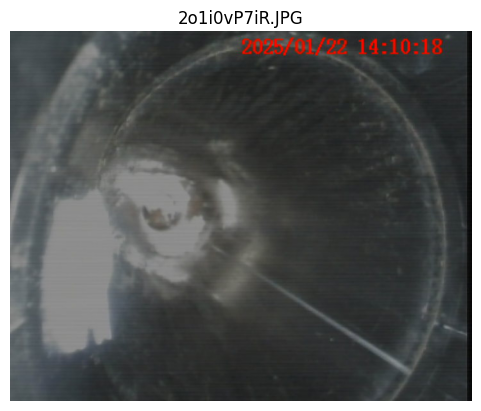

In [40]:
# Select the first image file
image_first = image_filename_list[0]
image_first_path = os.path.join(folder_1_path, image_first)

# Display image file name
print("\nImage file : ", image_first)
print("\nImage path : ", image_first_path)

# display image
image_cv2 = cv2.imread(image_first_path)
display_image(image_cv2, title=image_first)

Nous effectuons le gridsearch sur la première image du dossier input pour trouver les meilleurs hyperparamètres.

In [41]:
# gridsearch results output path
results_grid_path = os.path.join(output_dir, "gridsearch_results.csv")

# Check if the output file exists, if not create it
if not os.path.exists(results_grid_path):

    # Grid search
    param_grid = {
        "scale_percent": [25, 50,  100],
        "batch_size": [1, 10, 100],
        "decoder" : ["greedy", "beamsearch", "wordbeamsearch"],
        "adjust_contrast": [0.5, False],
        "worker": [0, 1, 2]
    }

    # Define initial best parameters
    best_params, best_duration = None, {"duration" : float("inf")}

    # Create a DataFrame for results
    results_df = pd.DataFrame(
        columns=list(param_grid.keys()) + ["duration"] + ["text"]
    )

    # Grid search
    for params in ParameterGrid(param_grid):
        print(f"\nTest des paramètres : {params}\n")

        # Resize the image if needed
        if params["scale_percent"] != 100:
            image_resized_path = os.path.join(temp_dir, "image.jpg")
            resize_image(
                image_first_path,
                image_resized_path,
                scale_percent=params["scale_percent"]
            )
        else:
            image_resized_path = image_first_path
            print("Pas de resize de l'image")

        # Extract text
        text, duration = extract_text_easyocr(
            image_resized_path,
            batch_size=params["batch_size"],
            decoder=params["decoder"],
            adjust_contrast=params["adjust_contrast"],
            worker=params["worker"]
        )

        # Add results to DataFrame
        new_results = [{
            "scale_percent": params["scale_percent"],
            "batch_size": params["batch_size"],
            "decoder": params["decoder"],
            "adjust_contrast": params["adjust_contrast"],
            "worker":params["worker"],
            "duration": duration,
            "text": text
        }]
        new_results_df = pd.DataFrame(new_results)
        results_df = pd.concat(
            [results_df, new_results_df],
            ignore_index=True
        )
        
        # Update best parameters
        if duration < best_duration["duration"]:
            best_duration["duration"] = duration
            best_params = params

    # Save results to CSV file
    results_df.to_csv(results_grid_path, index=False)
    print("\nRésultats sauvegardés dans le fichier : ", results_grid_path)

    # Save the best parameters to a JSON file
    best_params_path = save_to_json(best_params, output_dir, "best_params.json")

    # save the best duration to a JSON file
    best_duration_path = save_to_json(best_duration, output_dir, "best_duration.json")

else:
    # Load results from CSV file
    results_df = pd.read_csv(results_grid_path)
    print("\nRésultats chargés depuis le fichier CSV : ", results_grid_path)

    # load best params
    best_params = load_from_json(output_dir, "best_params.json")

    # load best duration
    best_duration = load_from_json(output_dir, "best_duration.json")


Résultats chargés depuis le fichier CSV :  c:\Users\pierr\VSC_Projects\Rpur\data\dev\output_notebook\gridsearch_results.csv

Données chargées depuis le fichier JSON : c:\Users\pierr\VSC_Projects\Rpur\data\dev\output_notebook\best_params.json

Données chargées depuis le fichier JSON : c:\Users\pierr\VSC_Projects\Rpur\data\dev\output_notebook\best_duration.json


In [42]:
# Highlight the best values
results_df.style.apply(surligne_meilleur)

,scale_percent,batch_size,decoder,adjust_contrast,worker,duration,text
0,25,1,greedy,0.500000,0,8.246962,terrasses de l'etang d1 fond de conduit inaccessible
1,25,1,greedy,0.500000,1,24.173122,terrasses de l'etang d1 fond de conduit inaccessible
2,25,1,greedy,0.500000,2,23.301285,terrasses de l'etang d1 fond de conduit inaccessible
3,50,1,greedy,0.500000,0,9.800161,terrasses de l'etang d1 fond de conduit inaccessible
4,50,1,greedy,0.500000,1,25.910279,terrasses de l'etang d1 fond de conduit inaccessible
5,50,1,greedy,0.500000,2,31.017530,terrasses de l'etang d1 fond de conduit inaccessible
6,100,1,greedy,0.500000,0,34.993794,terrasses de l'etang d1 fond de conduit inaccessible
7,100,1,greedy,0.500000,1,50.731287,terrasses de l'etang d1 fond de conduit inaccessible
8,100,1,greedy,0.500000,2,52.563127,terrasses de l'etang d1 fond de conduit inaccessible
9,25,1,beamsearch,0.500000,0,5.540299,terrasses de l'etang d1 fond de conduit inaccessible


Manifestement, le decoder '**beamsearch**' est le seul decoder a présenter le problème d'overflow. Nous veillons donc à ne pas l'utiliser.

In [43]:
# Display best parameters
print("\nMeilleurs paramètres : ", best_params)
print("Meilleure durée : ", round(best_duration["duration"], 1), " secondes")


Meilleurs paramètres :  {'adjust_contrast': 0.5, 'batch_size': 1, 'decoder': 'wordbeamsearch', 'scale_percent': 25, 'worker': 0}
Meilleure durée :  5.1  secondes


Nous obtenons les meilleurs résultats avec les images réduitent à **25% de leur taille** et avec le decoder "**wordbeamsearch**", avec un ajustement des contrastes de 0.5 et un batch=1.

Nous utiliserons donc ce paramètres d'easyOCR pour le script final.

# <span style='background:blue'>III. Optimisation prétraitement des images</span>

## <span style='background:green'>1/ Dataset avec nom aléatoire</span>


Nous constituons un dataset avec des noms de fichier sans rapport avec les infos contenues dans l'image si besoin.

Nous créons le nouveau dossier et les sous-dossiers, puis nous déplaçons les fichiers dans les sous-dossiers correspondants.

In [44]:
if is_need_random_folder:

    # Create a dictionary to store files for each subdirectory
    files_by_subdir = {}
    files_by_subdir = get_files_by_subdir(data_dir)

    # Create a new folder for files with random names
    random_folder_path = data_dir.replace("source", "source_random")
    os.makedirs(random_folder_path, exist_ok=True)

    # Empty dict with each subdirectory and its files (excluding root folder)
    subdir, files, subdir_name = create_subdirectories(
        data_dir, random_folder_path
    )

    # Move files to the new folder with random names
    for file in files:

        # Get the file extension
        _, extension = os.path.splitext(file)

        # Generate a random filename
        random_filename = generate_random_filename(extension[1:], length=10)

        # Move the file to the new folder with the random name
        shutil.copy(
            os.path.join(subdir, file),
            os.path.join(random_folder_path, subdir_name, random_filename)
        )

        # Print the old and new file names
        print(f"Copied {file} to {random_filename} in {subdir_name}")
else:
    print("\nPas besoin de créer un dossier avec des noms de fichiers aléatoires.")


Pas besoin de créer un dossier avec des noms de fichiers aléatoires.


## <span style='background:green'>2/ Création du dictionnaire des fichiers</span>

Nous créons un dictionnaire contenant les noms des sous-dossiers et les noms des fichiers et nous verifions la première image du dossier.

Dictionnaire des fichiers par sous-dossier :

0 - Terminaux: ['0PPuOlDZAJ.jpg', '41oMSUSbGA.jpg', '5HetHm7AoW.jpg', '5Oga9fOxP9.jpg', '7nQCCKviVo.jpg', '8rI24qcHDh.jpg', '9dy6VgxYib.jpg', 'DI5O6aFlP4.jpg', 'ew4w7UQQwI.jpg', 'hub54SpeR0.jpg', 'iAI90PnInn.jpg', 'joooDm6JXy.jpg', 'kDbAc2JIYg.jpg', 'kstzlsM2py.jpg', 'lzczdAYXYJ.jpg', 'mRANJb56sh.jpg', 'NzsDncFH2i.jpg', 'Ozhw3XhuDl.jpg', 'rAj0zEkO9Q.jpg', 'SgKs1wkDDo.jpg', 't181U9xgKf.jpg', 'tRzXfkqDDx.jpg', 'X9qABIK5xt.jpg', 'YRqvXYjA1H.jpg', 'zArWXdmcFR.jpg']

Première image du dossier  :  c:\Users\pierr\VSC_Projects\Rpur\data\input\source\0 - Terminaux\0PPuOlDZAJ.jpg


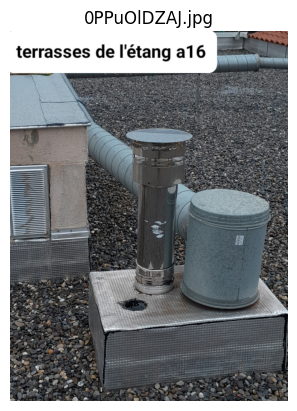

---------------------------------------------------------------------------
1 - Combles: ['9RWYbejhQ5.jpg', 'cfBLm8PEPG.jpg', 'Cyv1ACf9UX.jpg', 'EDLrfe1FPZ.jpg', 'IcnyquvDcv.jpg', 'lt30o5OO5t.jpg', 'LtBB6g1aRA.jpg', 'NTrYI6jHhs.jpg', 'qe89hMOP8P.jpg', 'VhrzwXd8mv.jpg', 'wbOHubfQuo.jpg', 'ZVKV2mExLj.jpg']

Première image du dossier  :  c:\Users\pierr\VSC_Projects\Rpur\data\input\source\1 - Combles\9RWYbejhQ5.jpg


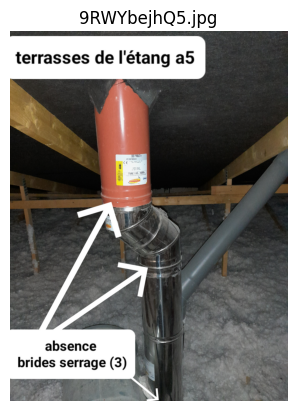

---------------------------------------------------------------------------
2 - Conduits: ['2o1i0vP7iR.JPG', '3bA7kJjwPC.JPG', '3RDW2CM7KP.JPG', '5I2CY1FjZ1.JPG', '7bmRTc8XaT.JPG', '8V1UWCVPpM.JPG', 'BLcJ4pea71.JPG', 'c6E0kOILVG.JPG', 'CqPRv06QaR.JPG', 'DfSTXL5eaa.JPG', 'FWiaPtr6Ry.JPG', 'gd1L0eaEBd.JPG', 'gu4LHv4Fbc.JPG', 'iHrfZxJOd4.JPG', 'j2vpZfYA5l.JPG', 'LoBVdtHlKg.JPG', 'lRHpAJrfKV.JPG', 'n5IM6DIPEd.JPG', 'NakR8ljRhC.JPG', 'NlN7yPWqzh.JPG', 'oSkx9WLuYk.JPG', 'PXAGf0n2oj.JPG', 'RJgJu70GtX.JPG', 'sb9Pw895IL.JPG', 'YkLdFwbhAw.JPG', 'yleDJVkbol.JPG', 'YQPbAreXTF.JPG', 'zCrwyKWXtt.JPG']

Première image du dossier  :  c:\Users\pierr\VSC_Projects\Rpur\data\input\source\2 - Conduits\2o1i0vP7iR.JPG


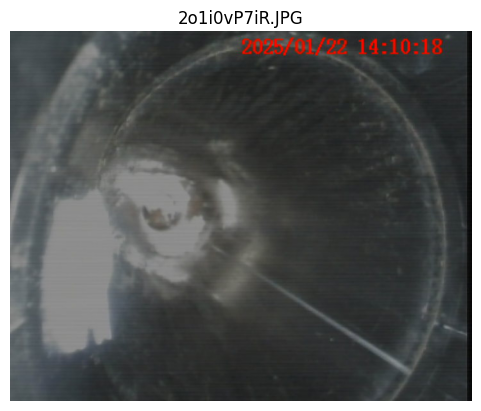

---------------------------------------------------------------------------
3 - Logements (2024): ['0IoqD9JRUH.jpg', '0ZDWUzu0Jv.jpg', '10BZHt7QOt.jpg', '3c6WhEQfg5.jpg', '3oodYWEZvg.jpg', '9dz74zt3QG.jpg', '9nf94Ti8WN.jpg', 'aMpLhOKQjw.jpg', 'arY5QObBaH.jpg', 'bHVNH7n2kb.jpg', 'bLcGB5xchC.jpg', 'bvihlOAxjR.jpg', 'C3Nz9hRkad.jpg', 'cPeXlTkO6u.jpg', 'FCf52T0jyg.jpg', 'FhHRyV1WdI.jpg', 'fS4QVmJMgU.jpg', 'Gz2HjRkmWy.jpg', 'hkR4JWI2aS.jpg', 'hn3xHSNzBC.jpg', 'JfMjUJPQdG.jpg', 'KaapSm8AgH.jpg', 'lsrfxLDa80.jpg', 'MO8SchduPz.jpg', 'mXw39rULe0.jpg', 'mza7I5ZWOA.jpg', 'N4oQnHm3cn.jpg', 'nFokyG7P4k.jpg', 'O5WxGastvP.jpg', 'pe991k8qAc.jpg', 'pfdxfsjZHp.jpg', 'RH1swPEn8A.jpg', 'TEivzoSk4k.jpg', 'UHvDzWlPIN.jpg', 'uV1UBpe3ln.jpg', 'WEK8kZ0heV.jpg', 'wNrdJqTqX1.jpg', 'wreTSoFrEg.jpg', 'X7H5x3vQBL.jpg', 'xcAehHRSGI.jpg', 'xFvzPLuNPf.jpg', 'xNIiJl1MvZ.jpg', 'Ynf1JE1xcR.jpg', 'zVOgPKzJDM.jpg']

Première image du dossier  :  c:\Users\pierr\VSC_Projects\Rpur\data\input\source\3 - Logements (2024)\0IoqD9

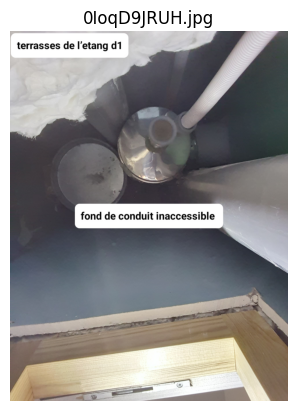

---------------------------------------------------------------------------

Liste des sous-dossiers :  ['0 - Terminaux', '1 - Combles', '2 - Conduits', '3 - Logements (2024)']


In [45]:
# Create a dictionary to store files for each subdirectory
subdir_list, files_by_subdir = [], {}
files_by_subdir = get_files_by_subdir(data_dir)

# Print the dictionary of files by subdirectory
print("Dictionnaire des fichiers par sous-dossier :\n")
for subdir, files in files_by_subdir.items():
    subdir_list.append(subdir)
    print(f"{subdir}: {files}")

    # Get the first image file in the subdirectory
    if not files:
        print(f"No files found in {subdir}")
    image_path = os.path.join(data_dir, subdir, files[0])
    image_cv2 = cv2.imread(image_path)

    # Display the first image
    print("\nPremière image du dossier  : ", image_path)
    display_image(image_cv2, title=files[0])
    print("-" * 75)

# Print the list of subdirectories
print("\nListe des sous-dossiers : ", subdir_list)

Les images de la clef "2 - Conduits" ne contiennent pas de texte, nous isolons son nom pour ne pas le prendre en compte dans le traitement.

Nous enregistrons le dictionnaire dans un fichier JSON.

In [46]:
export_text_to_json(
    files_by_subdir,
    output_dir,
    output_file="files_by_subdir.json"
    )


Dictionnaire exporté dans le fichier : c:\Users\pierr\VSC_Projects\Rpur\data\dev\output_notebook\files_by_subdir.json


## <span style='background:green'>3/ Extraction de texte de plusieurs images</span>

Nous réalisons l'extraction du texte sur plusieurs images du dossier.


 ***************************************************************************

SUBDIRECTORY: 0 - Terminaux

Processing file: 0PPuOlDZAJ.jpg


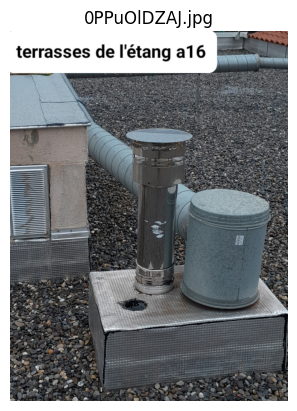

Using CPU. Note: This module is much faster with a GPU.


Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)

Extracted text:
===> ["terrasses de l'étang a16"] <===
Duration: 7.2 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a16 <===

Processing file: 41oMSUSbGA.jpg


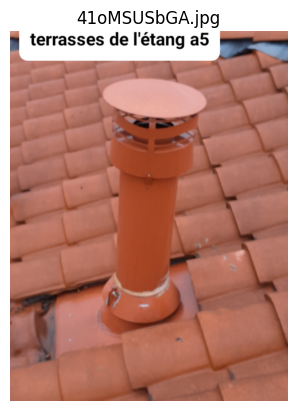

Using CPU. Note: This module is much faster with a GPU.


Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)

Extracted text:
===> ["terrasses de l'étang a5"] <===
Duration: 6.3 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a5 <===

Processing file: 5HetHm7AoW.jpg


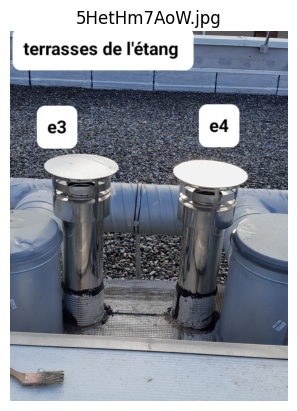

Using CPU. Note: This module is much faster with a GPU.


Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)

Extracted text:
===> ["terrasses de l'étang", 'e3', 'e4'] <===
Duration: 6.4 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang
e3
e4 <===

 ***************************************************************************

SUBDIRECTORY: 1 - Combles

Processing file: 9RWYbejhQ5.jpg


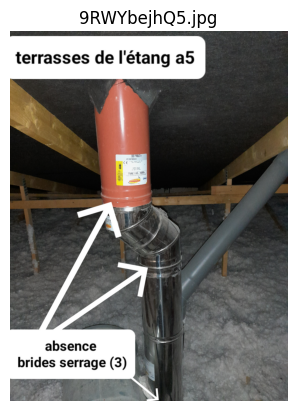

Using CPU. Note: This module is much faster with a GPU.


Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)

Extracted text:
===> ['terrasses de létang a5', 'Uiies', 'WAti', 'absence', 'brides serrage N32'] <===
Duration: 6.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a5
Unies
Bâti
absence
brides serrage N32 <===

Processing file: cfBLm8PEPG.jpg


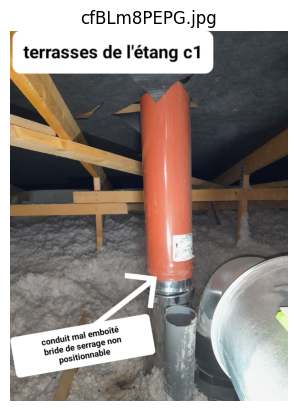

Using CPU. Note: This module is much faster with a GPU.


Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)

Extracted text:
===> ["terrasses de l'étang c1", 'de', 'emboîté', 'mal', 'conduit', 'non', 'serrage', 'bride', 'positionnable'] <===
Duration: 6.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang c1
d'emboîté
mal
conduit
non-serrage
bride
position nable <===

Processing file: Cyv1ACf9UX.jpg


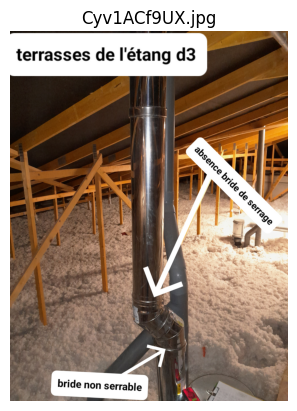

Using CPU. Note: This module is much faster with a GPU.


Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)

Extracted text:
===> ["terrasses de l'étang d3", '9', 'bride non serrable', '1', '1', '9'] <===
Duration: 6.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang d3
9
bride non s'érafle
1
1
9 <===

 ***************************************************************************

SUBDIRECTORY: 2 - Conduits

Processing file: 2o1i0vP7iR.JPG


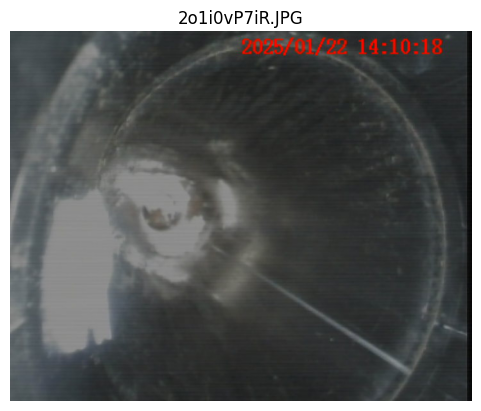

Using CPU. Note: This module is much faster with a GPU.


Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)

Extracted text:
===> [] <===
Duration: 3.2 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: 3bA7kJjwPC.JPG


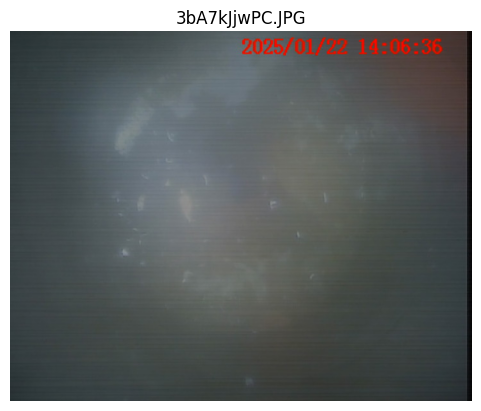

Using CPU. Note: This module is much faster with a GPU.


Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)

Extracted text:
===> [] <===
Duration: 3.2 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: 3RDW2CM7KP.JPG


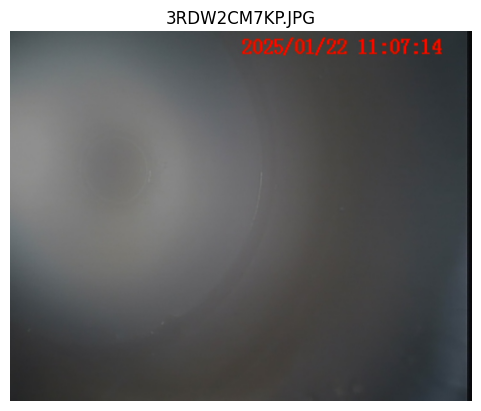

Using CPU. Note: This module is much faster with a GPU.


Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)

Extracted text:
===> [' n'] <===
Duration: 3.3 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  n <===

 ***************************************************************************

SUBDIRECTORY: 3 - Logements (2024)

Processing file: 0IoqD9JRUH.jpg


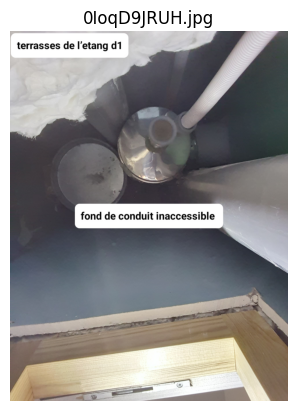

Using CPU. Note: This module is much faster with a GPU.


Initial image size :  (2576, 1932, 3)
resized image size :  (644, 483, 3)

Extracted text:
===> ["terrasses de l'etang d1", 'fond de conduit inaccessible'] <===
Duration: 4.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang d1
fond de conduit inaccessible <===

Processing file: 0ZDWUzu0Jv.jpg


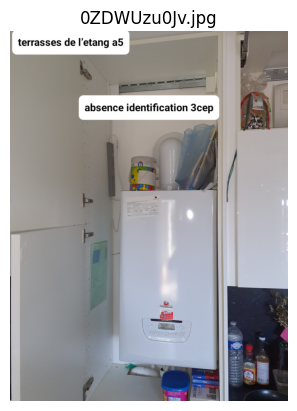

Using CPU. Note: This module is much faster with a GPU.


Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)

Extracted text:
===> ["terrasses de l'etang a5", 'absence identification 3cep'] <===
Duration: 6.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a5
absence identification 3 cep <===

Processing file: 10BZHt7QOt.jpg


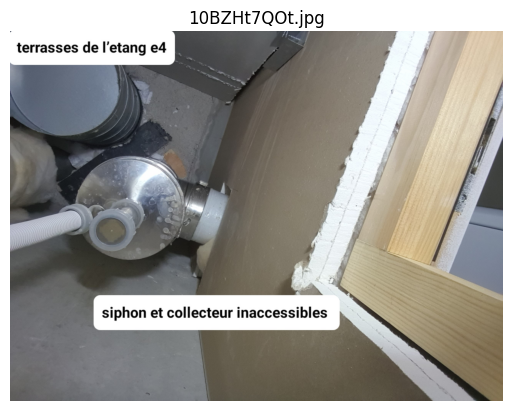

Using CPU. Note: This module is much faster with a GPU.


Initial image size :  (1932, 2576, 3)
resized image size :  (483, 644, 3)

Extracted text:
===> ["terrasses de l'etang e4", 'siphon et collecteur inaccessibles'] <===
Duration: 4.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang e4
siphon et collecteur inaccessibles <===

Dictionnaire exporté dans le fichier : c:\Users\pierr\VSC_Projects\Rpur\data\dev\output_notebook\1-text_extracted.json
{
    "0 - Terminaux": {
        "0PPuOlDZAJ.jpg": "Terrasses de l'étang a16",
        "41oMSUSbGA.jpg": "Terrasses de l'étang a5",
        "5HetHm7AoW.jpg": "Terrasses de l'étang\ne3\ne4"
    },
    "1 - Combles": {
        "9RWYbejhQ5.jpg": "Terrasses de l'étang a5\nUnies\nBâti\nabsence\nbrides serrage N32",
        "cfBLm8PEPG.jpg": "Terrasses de l'étang c1\nd'emboîté\nmal\nconduit\nnon-serrage\nbride\nposition nable",
        "Cyv1ACf9UX.jpg": "Terrasses de l'étang d3\n9\nbride non s'érafle\n1\n1\n9"
    },
    "2 - Cond

In [47]:
# Choose the number of files per folder to process
number_of_files = 3

# output filename
output_file_name="1-text_extracted.json"

# text extracted output path
text_extracted_path = os.path.join(output_dir, output_file_name)

# Check if the output file exists, if not create it
if not os.path.exists(text_extracted_path):
    text_extracted = {}

    # Extract text from the first X files in each subdirectory
    for subdir, files in files_by_subdir.items():
        print("\n", "*" * 75)
        print(f"\nSUBDIRECTORY: {subdir}")
        text_extracted[subdir] = {}

        # Skip the ignored folder with empty text
        if subdir == folder_ignored_dir:
            print("===>>> Folder ignored <<<===")
            for file in files[:number_of_files]:
                text_extracted[subdir][file] = ""

        else:
            # Limit to the first X files
            for file in files[:number_of_files]:

                # Get the image path
                image_path = os.path.join(data_dir, subdir, file)
                print(f"\nProcessing file: {file}")

                # display image
                image_cv2 = cv2.imread(image_path)
                display_image(image_cv2, title=file)

                # Resize the image
                image_resized_path = os.path.join(temp_dir, "image.jpg")
                resize_image(
                    image_path,
                    image_resized_path,
                    scale_percent=best_params["scale_percent"]
                )

                # Extract text
                text, duration = extract_text_easyocr(
                    image_resized_path,
                    batch_size=best_params["batch_size"],
                    decoder=best_params["decoder"],
                    adjust_contrast=best_params["adjust_contrast"],
                    worker=best_params["worker"]
                )

                # Clean the french text
                text = correct_text_french(text)
                print("\nCleaned text:\n===>", text, '<===')

                # Save the text in the dictionary
                text_extracted[subdir][file] = text

    # Export JSON
    export_text_to_json(
    text_extracted,
    output_dir,
    output_file=output_file_name
    )

    # Print the JSON content with color
    print_json_with_color(text_extracted)
else:
    # Importation du fichier JSON
    text_extracted = import_json_to_text(
        output_dir,
        input_file=output_file_name
    )
    # Print the JSON content with color
    print_json_with_color(text_extracted)

L'extraction est existante mais il subsite encore beaucoup d'erreurs de reconnaissance de texte. Nous allons donc essayer d'optimiser le modèle en appliquant un prétraitement sur les images.

## <span style='background:green'>4/ Extraction de texte avec pre-traitement</span>

Nous effectuons un prétraitement de l'image avant l'extraction du texte pour tenter d'obtenir des meilleurs résultats.


 ***************************************************************************

SUBDIRECTORY: 0 - Terminaux

Processing file: 0PPuOlDZAJ.jpg


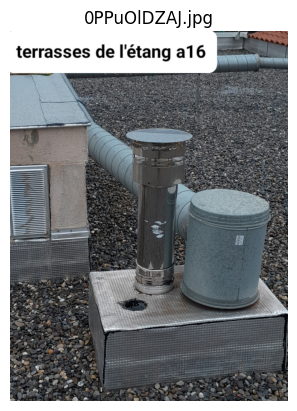

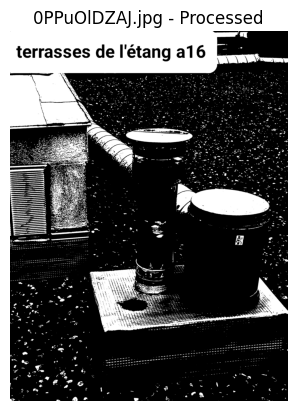

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


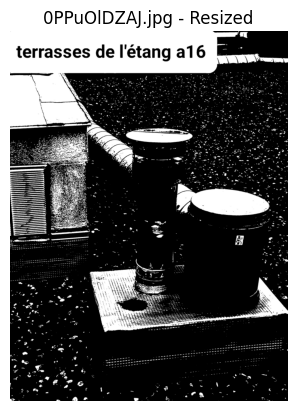

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de', 'létang a16', '0'] <===
Duration: 6.4 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de
l'étang a16
0 <===

Processing file: 41oMSUSbGA.jpg


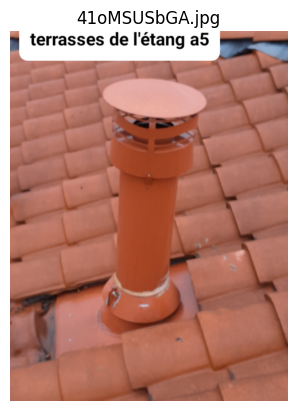

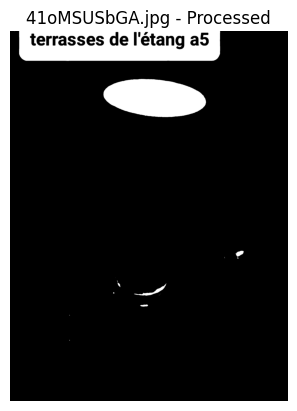

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


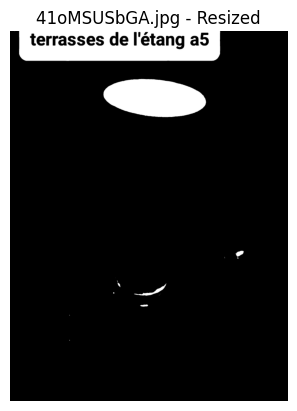

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de', 'létang a5'] <===
Duration: 6.1 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de
l'étang a5 <===

Processing file: 5HetHm7AoW.jpg


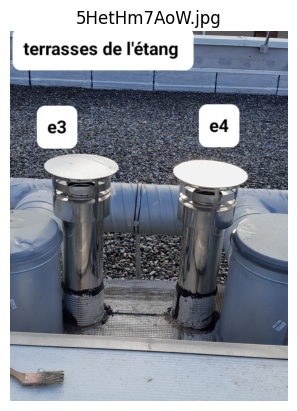

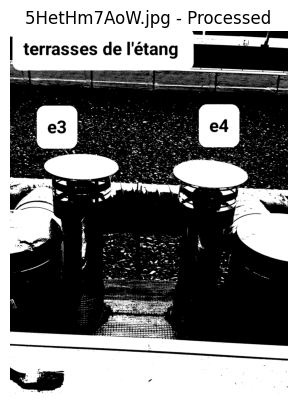

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


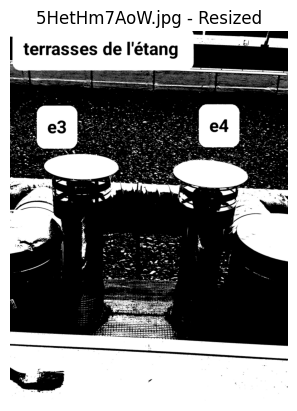

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang", 'e3', 'e4'] <===
Duration: 7.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang
e3
e4 <===

 ***************************************************************************

SUBDIRECTORY: 1 - Combles

Processing file: 9RWYbejhQ5.jpg


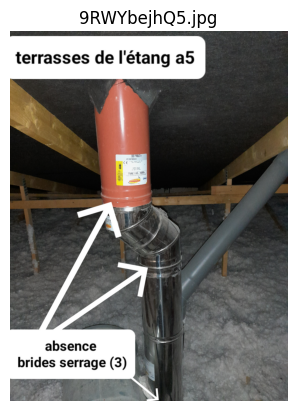

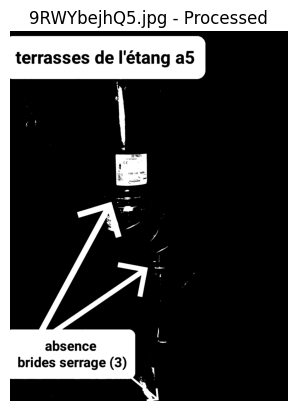

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


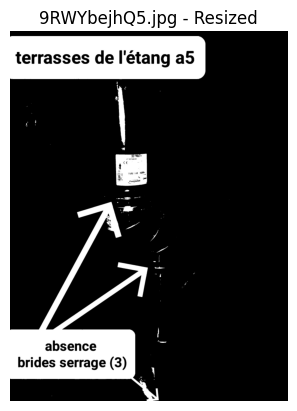

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang a5", 'absence', 'brides serrage 63', 'ni t'] <===
Duration: 7.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a5
absence
brides serrage 63
n'y t <===

Processing file: cfBLm8PEPG.jpg


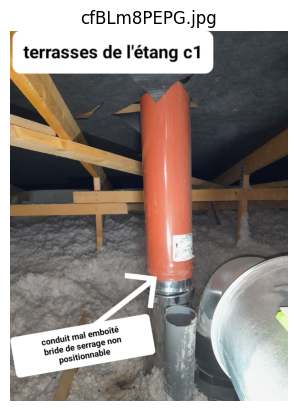

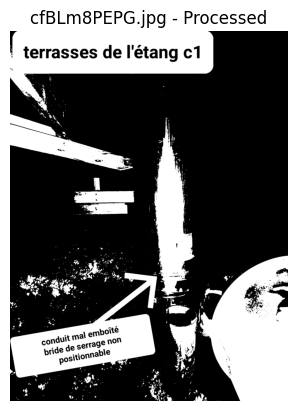

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


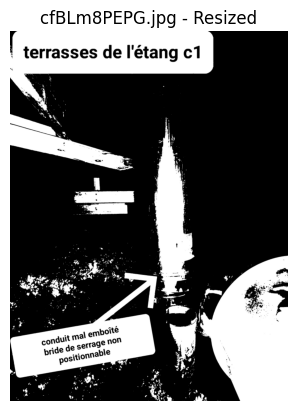

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de', "l'étang c1", 'de', 'emboîté', 'mal', 'conduit', 'non', 'serrage', 'bride', 'positionnable'] <===
Duration: 8.0 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de
l'étang c1
d'emboîté
mal
conduit
non-serrage
bride
position nable <===

Processing file: Cyv1ACf9UX.jpg


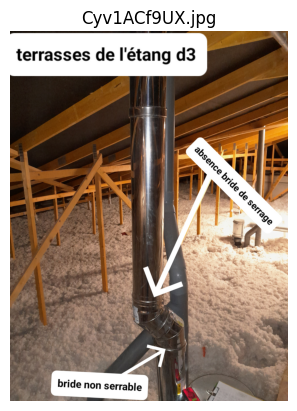

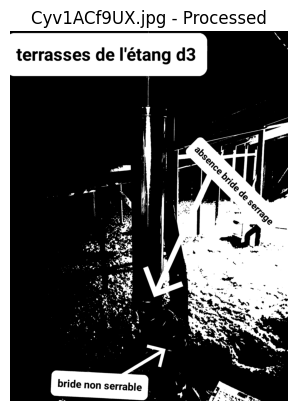

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


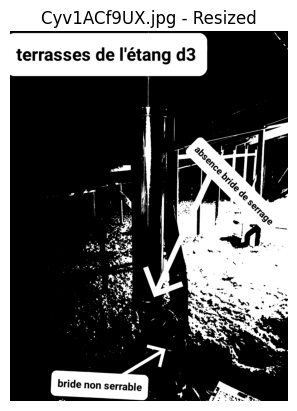

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang d3", '0', 'bride non serrable', '1', 'm', '1'] <===
Duration: 7.8 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang d3
0
bride non s'érafle
1
m
1 <===

 ***************************************************************************

SUBDIRECTORY: 2 - Conduits

Processing file: 2o1i0vP7iR.JPG


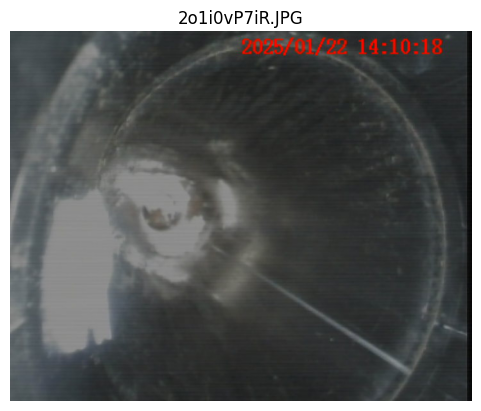

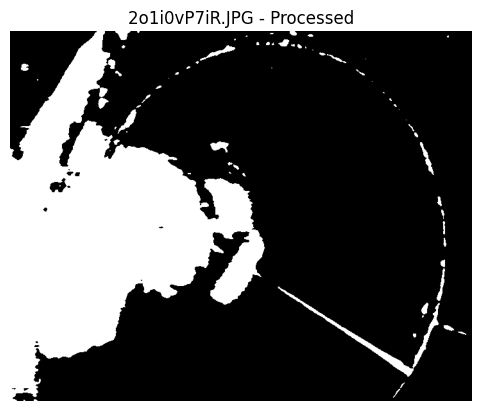

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


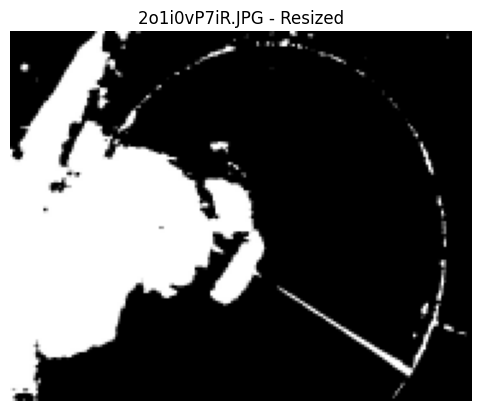

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: 3bA7kJjwPC.JPG


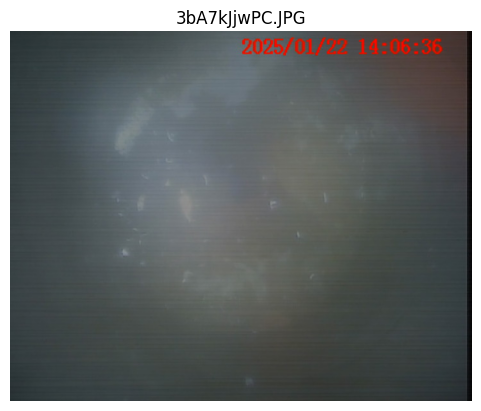

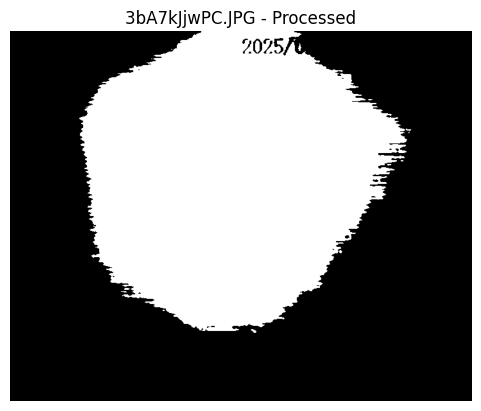

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


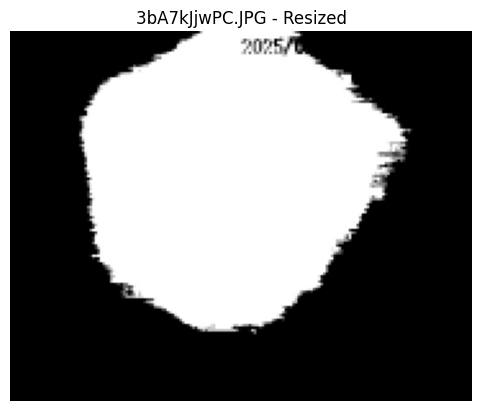

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: 3RDW2CM7KP.JPG


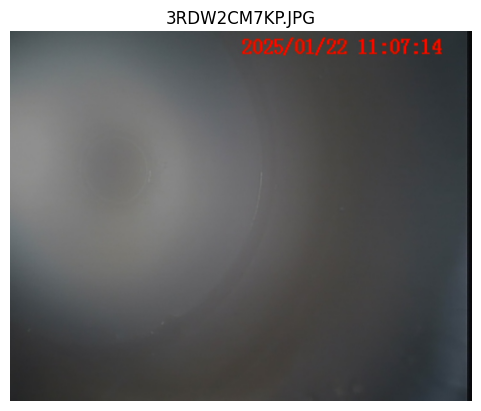

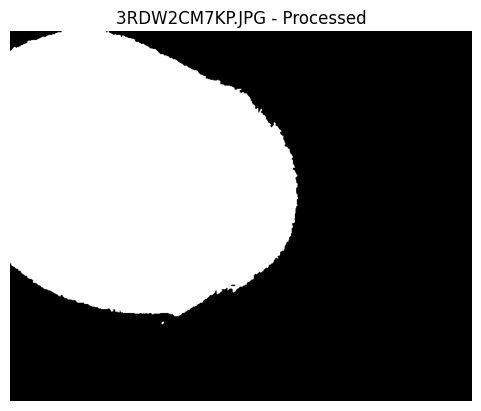

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


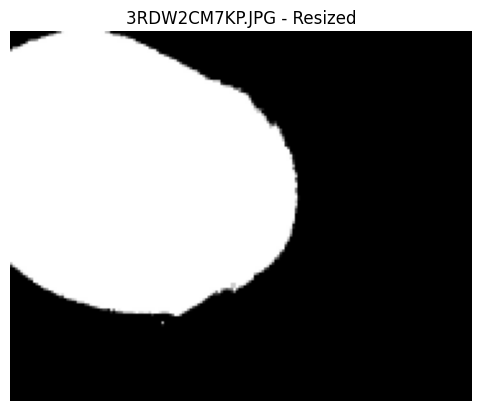

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

 ***************************************************************************

SUBDIRECTORY: 3 - Logements (2024)

Processing file: 0IoqD9JRUH.jpg


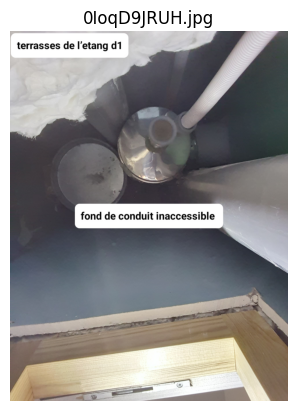

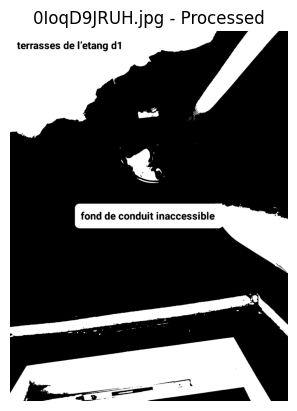

Initial image size :  (2576, 1932, 3)
resized image size :  (644, 483, 3)


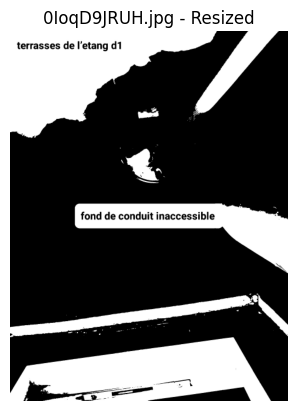

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang d1", 'fond de conduit inaccessible'] <===
Duration: 5.4 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang d1
fond de conduit inaccessible <===

Processing file: 0ZDWUzu0Jv.jpg


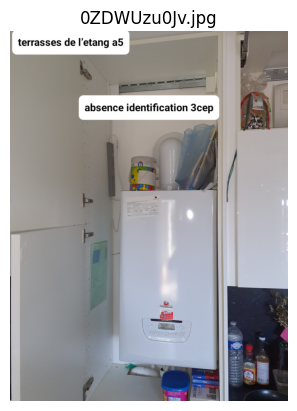

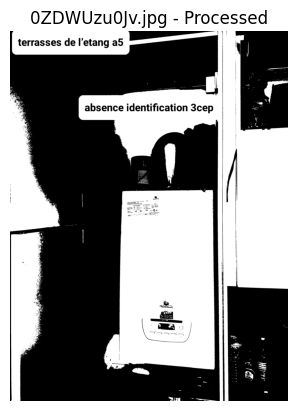

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


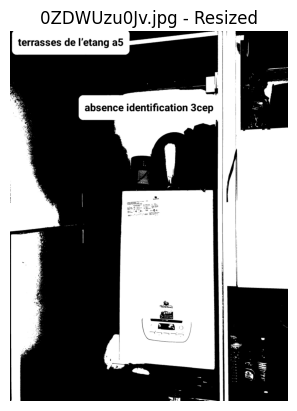

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang a5", 'absence identification 3cep', '55'] <===
Duration: 7.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a5
absence identification 3 cep
55 <===

Processing file: 10BZHt7QOt.jpg


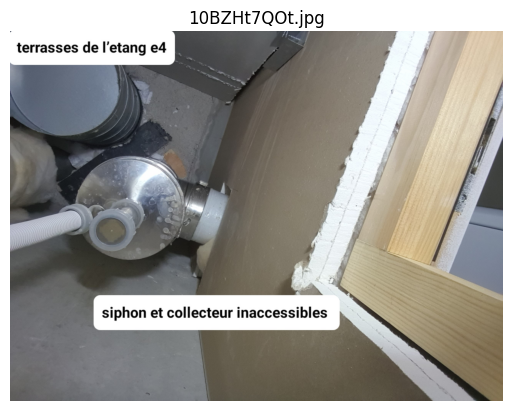

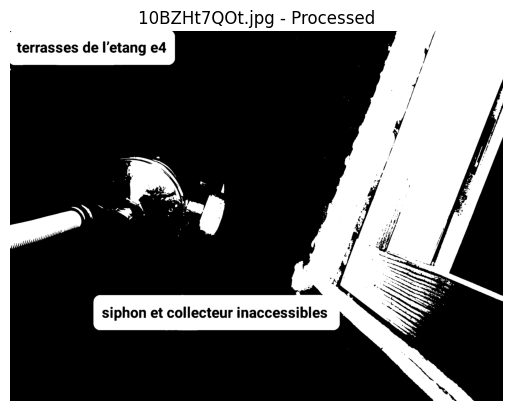

Initial image size :  (1932, 2576, 3)
resized image size :  (483, 644, 3)


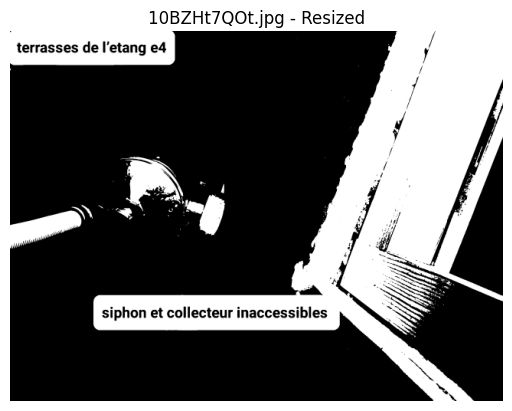

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang e4", 'siphon et collecteur inaccessibles'] <===
Duration: 5.4 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang e4
siphon et collecteur inaccessibles <===

Dictionnaire exporté dans le fichier : c:\Users\pierr\VSC_Projects\Rpur\data\dev\output_notebook\2-text_extracted_with_preprocessing.json
{
    "0 - Terminaux": {
        "0PPuOlDZAJ.jpg": "Terrasses de\nl'étang a16\n0",
        "41oMSUSbGA.jpg": "Terrasses de\nl'étang a5",
        "5HetHm7AoW.jpg": "Terrasses de l'étang\ne3\ne4"
    },
    "1 - Combles": {
        "9RWYbejhQ5.jpg": "Terrasses de l'étang a5\nabsence\nbrides serrage 63\nn'y t",
        "cfBLm8PEPG.jpg": "Terrasses de\nl'étang c1\nd'emboîté\nmal\nconduit\nnon-serrage\nbride\nposition nable",
        "Cyv1ACf9UX.jpg": "Terrasses de l'étang d3\n0\nbride non s'érafle\n1\nm\n1"
    },
    "2 - Conduits": {
        "2o1i0vP7iR.JPG": "",
        "3bA7kJjw

In [ ]:
# Create a dictionnary to store the extracted text
text_extracted = {}

# output filename
output_file_name="2-text_extracted_with_preprocessing.json"

# text extracted output path
text_extracted_path = os.path.join(output_dir, output_file_name)

# Check if the output file exists, if not create it
if not os.path.exists(text_extracted_path):
    text_extracted = {}

    # Extract text from the first X files in each subdirectory
    for subdir, files in files_by_subdir.items():
        print("\n", "*" * 75)
        print(f"\nSUBDIRECTORY: {subdir}")
        text_extracted[subdir] = {}

        # Skip the ignored folder with empty text
        if subdir == folder_ignored_dir:
            print("===>>> Folder ignored <<<===")
            for file in files[:number_of_files]:
                text_extracted[subdir][file] = ""

        else:
            # Limit to the first X files
            for file in files[:number_of_files]:

                # Get the image path
                image_path = os.path.join(data_dir, subdir, file)
                print(f"\nProcessing file: {file}")

                # display initial image
                image_cv2 = cv2.imread(image_path)
                display_image(image_cv2, title=file)

                # Process the image
                image_processed_path = os.path.join(
                    temp_dir,
                    "image_processed.jpg"
                )
                image_processed = preprocess_image(
                    image_path, image_processed_path
                )
                display_image(image_processed, title=f"{file} - Processed")

                # Resize the image
                image_resized_path = os.path.join(temp_dir, "image.jpg")
                image_resized = resize_image(
                    image_processed_path,
                    image_resized_path,
                    scale_percent=best_params["scale_percent"]
                )
                display_image(image_resized, title=f"{file} - Resized")

                # Extract text
                text, duration = extract_text_easyocr(
                    image_resized_path,
                    batch_size=best_params["batch_size"],
                    decoder=best_params["decoder"],
                    adjust_contrast=best_params["adjust_contrast"],
                    worker=best_params["worker"]
                )

                # Clean the french text
                text = correct_text_french(text)
                print("\nCleaned text:\n===>", text, '<===')

                # Save the text in the dictionary
                text_extracted[subdir][file] = text

    # Export JSON
    export_text_to_json(
    text_extracted,
    output_dir,
    output_file=output_file_name
    )

    # Print the JSON content with color
    print_json_with_color(text_extracted)
else:
    # Importation du fichier JSON
    text_extracted = import_json_to_text(
        output_dir,
        input_file=output_file_name
    )
    # Print the JSON content with color
    print_json_with_color(text_extracted)

## <span style='background:green'>5/ Extraction de texte avec pré-traitement plus performant</span>

Nous effectuons un prétraitement de l'image plus performant permettant de faire ressortir uniquement les pixels de texte noir pour les isoler et les détecter plus facilement par l'algo.

Pour tester différentes couleurs en HSV, voir la palette de couleur sur le site : https://products.aspose.com/svg/fr/net/color-converter/hsv-to-rgb/


 ***************************************************************************

SUBDIRECTORY: 0 - Terminaux

Processing file: 0PPuOlDZAJ.jpg


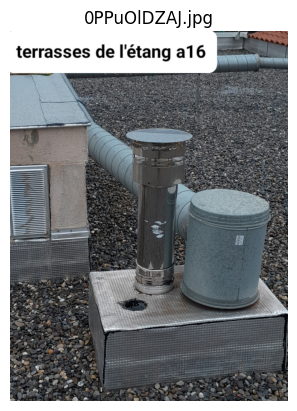

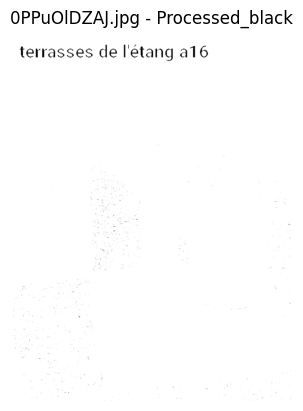

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


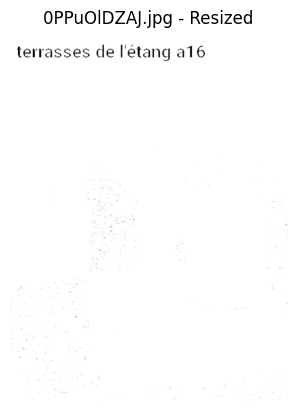

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang a16"] <===
Duration: 7.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a16 <===

Processing file: 41oMSUSbGA.jpg


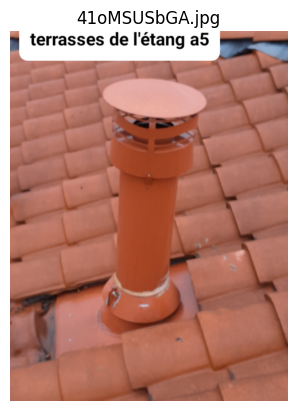

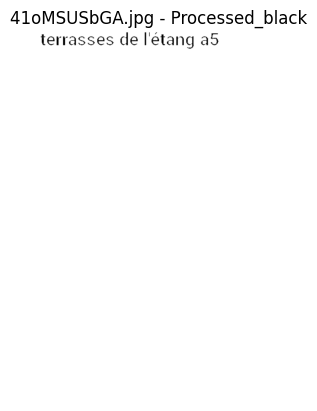

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


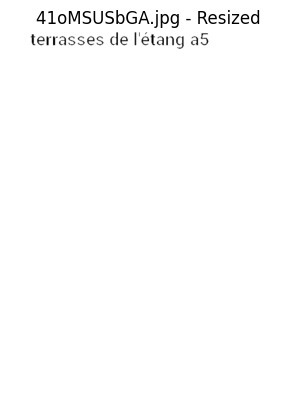

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de létang a5'] <===
Duration: 7.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a5 <===

Processing file: 5HetHm7AoW.jpg


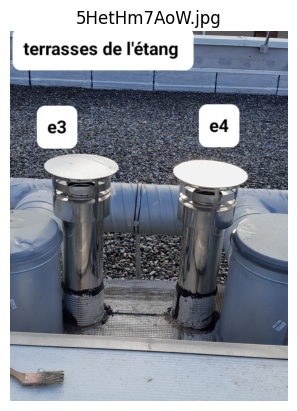

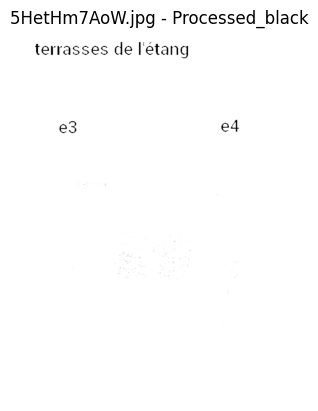

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


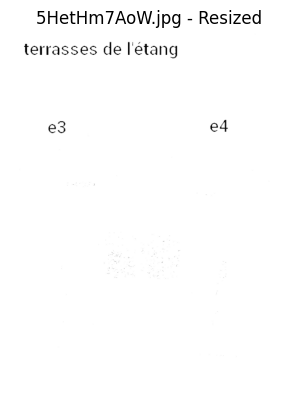

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang", 'e3', 'e4'] <===
Duration: 7.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang
e3
e4 <===

Processing file: 5Oga9fOxP9.jpg


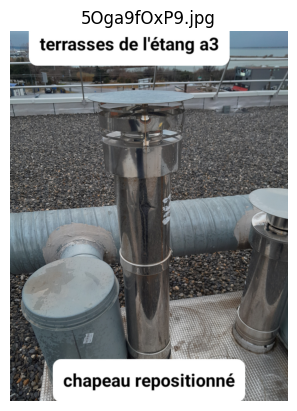

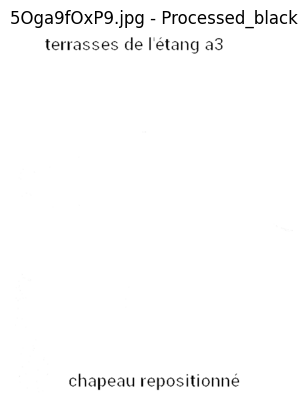

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


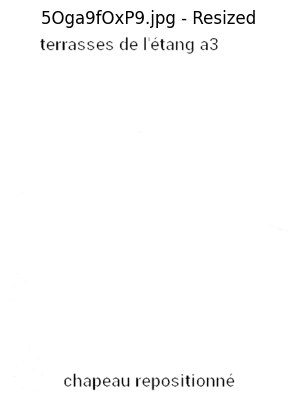

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de Iétang a3', 'chapeau repositionné'] <===
Duration: 7.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de Étang a3
chapeau repositionné <===

Processing file: 7nQCCKviVo.jpg


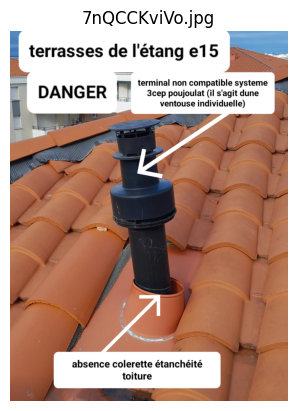

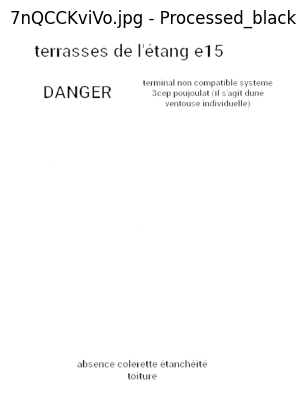

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


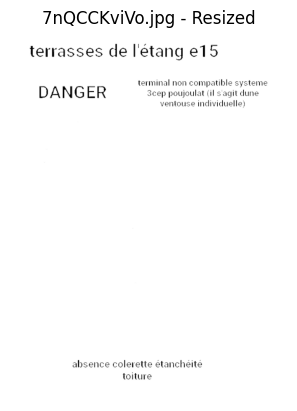

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang e15", 'terminal non compatible systeme', 'DANGER', "3cep poujoulat Gil s'agit dune", 'ventouse individuelley', 'absence colerette étanchéité', 'toiture'] <===
Duration: 8.0 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang e15
terminal non compatible système
DANGER
3 cep bouboulât Il s'agit d'une
ventouse individuelle
absence collerette étanchéité
toiture <===

Processing file: 8rI24qcHDh.jpg


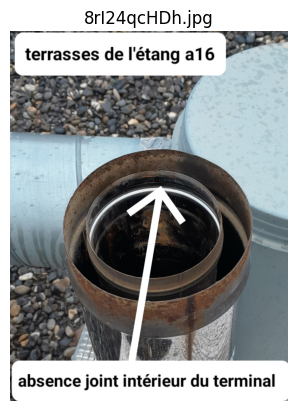

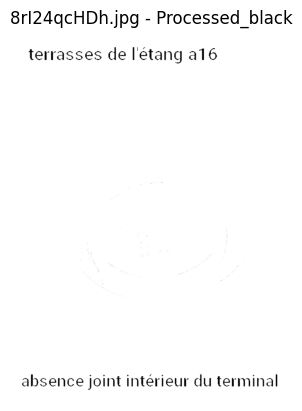

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


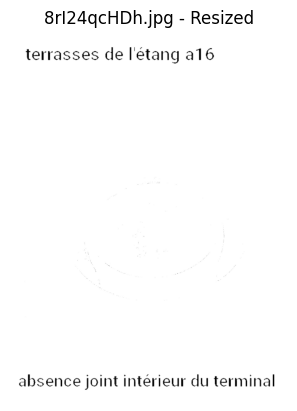

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang a16", 'absence joint intérieur du terminal'] <===
Duration: 7.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a16
absence joint intérieur du terminal <===

Processing file: 9dy6VgxYib.jpg


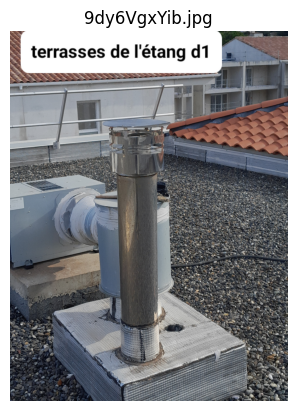

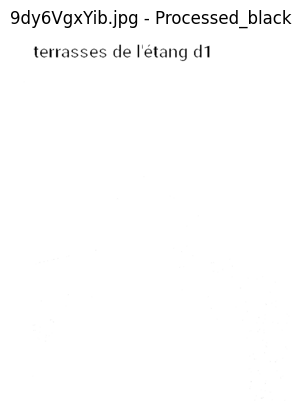

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


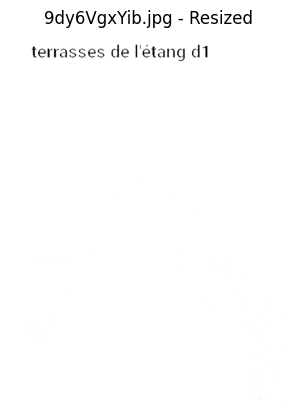

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang d1"] <===
Duration: 7.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang d1 <===

Processing file: DI5O6aFlP4.jpg


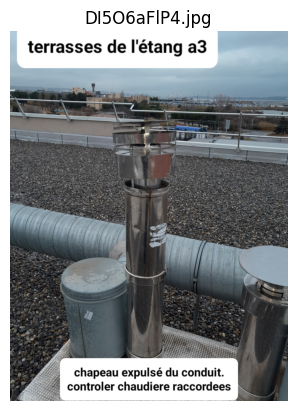

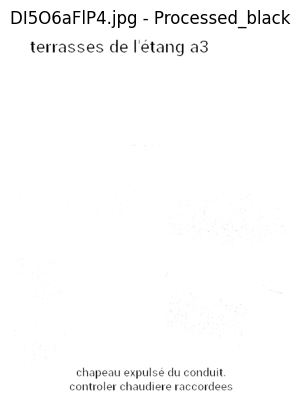

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


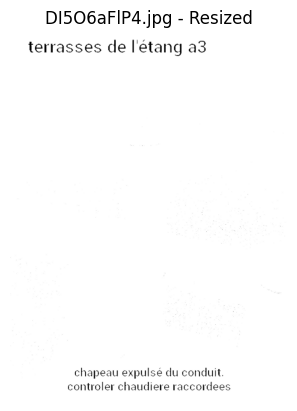

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang a3", 'chapeau expulsé du conduit ', 'controler chaudiere raccordees'] <===
Duration: 7.8 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a3
chapeau expulsé du conduit 
contrôler chaudière raccordées <===

Processing file: ew4w7UQQwI.jpg


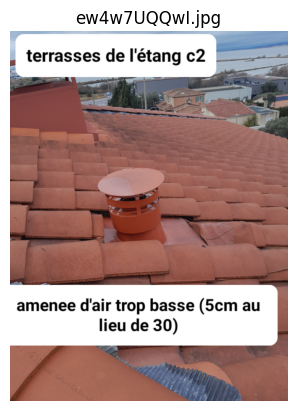

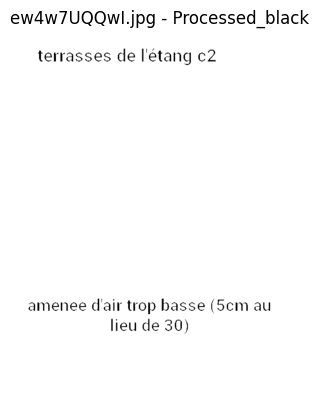

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


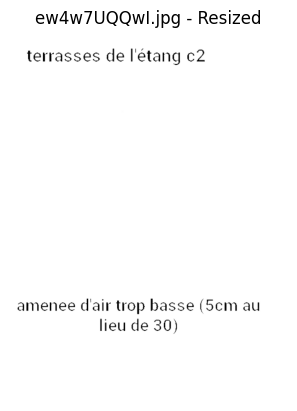

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang c2", 'amenee dair trop basse  5cm au', 'lieu de 30'] <===
Duration: 7.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang c2
amenée d'air trop bas 5 cm au
lieu de 30 <===

Processing file: hub54SpeR0.jpg


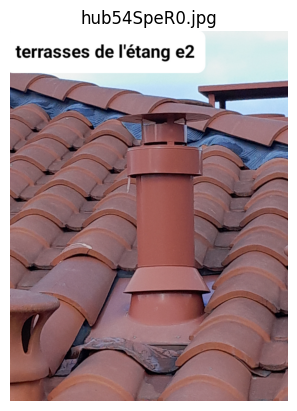

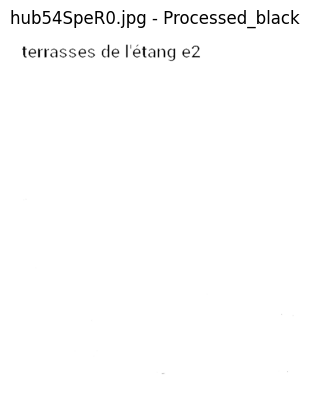

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


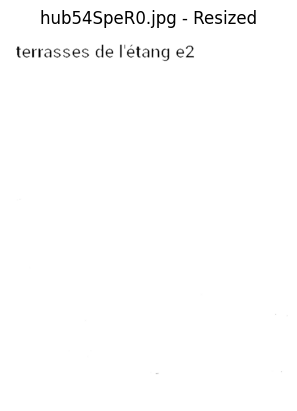

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang e2"] <===
Duration: 7.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang e2 <===

Processing file: iAI90PnInn.jpg


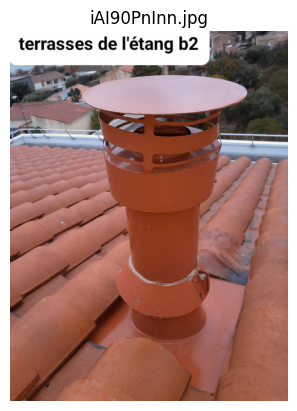

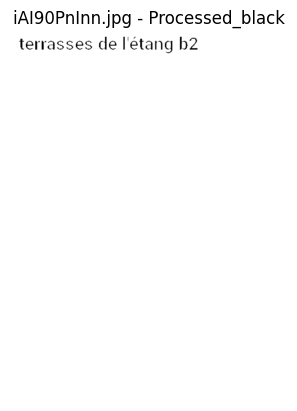

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


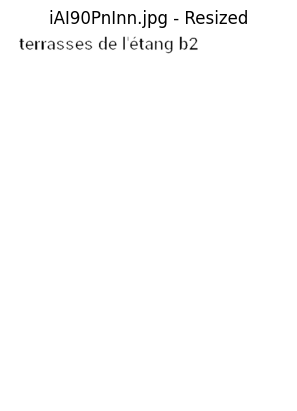

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de Iétang b2'] <===
Duration: 7.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de Étang b2 <===

Processing file: joooDm6JXy.jpg


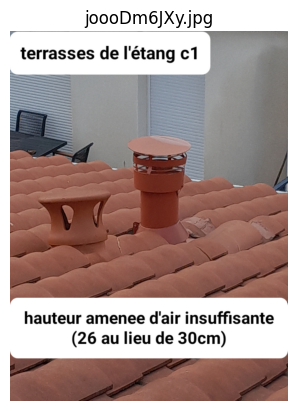

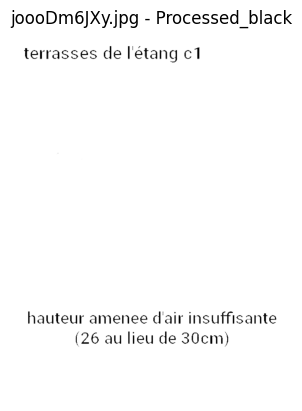

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


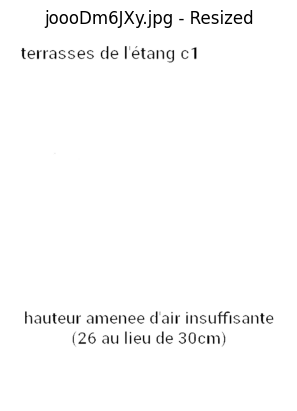

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang c1", 'hauteur amenee dair insuffisante', '626 au lieu de 30cm2'] <===
Duration: 7.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang c1
hauteur amenée d'air insuffisante
626 au lieu de 30,2 cm <===

Processing file: kDbAc2JIYg.jpg


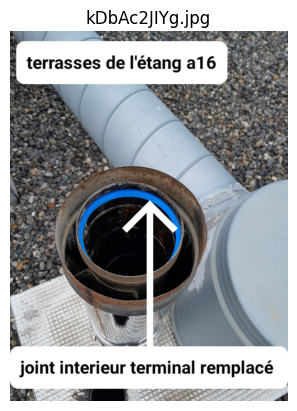

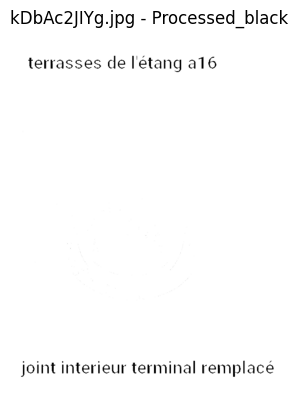

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


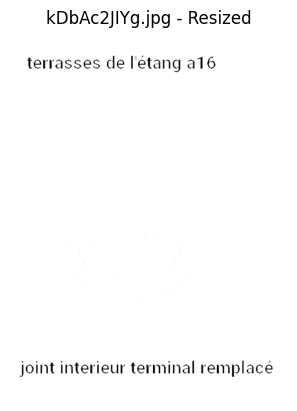

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang a16", 'joint interieur terminal remplacé'] <===
Duration: 7.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a16
joint intérieur terminal remplacé <===

Processing file: kstzlsM2py.jpg


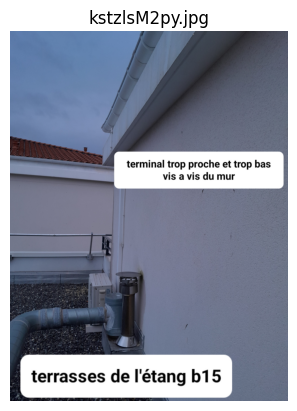

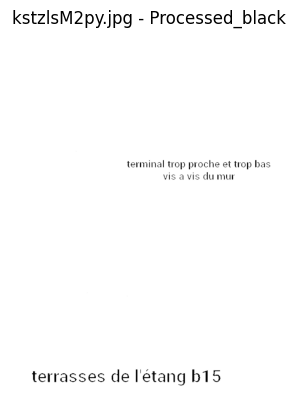

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


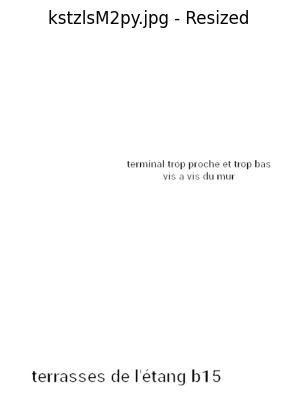

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terminal trop proche et trop bas', 'vis a vis du mur', "terrasses de l'étang b15"] <===
Duration: 8.0 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terminal trop proche et trop bas
vis-à-vis du mur
terrasses de l'étang b15 <===

Processing file: lzczdAYXYJ.jpg


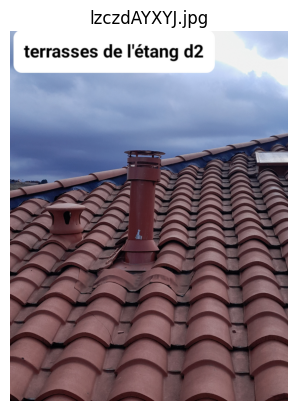

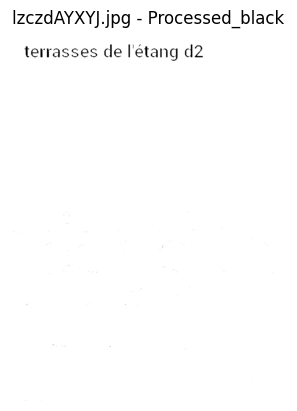

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


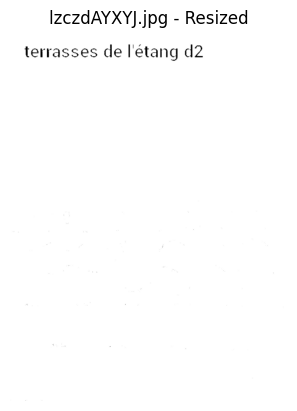

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang d2"] <===
Duration: 8.0 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang d2 <===

Processing file: mRANJb56sh.jpg


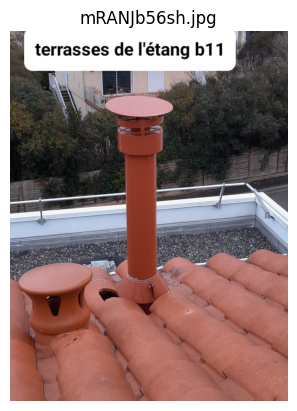

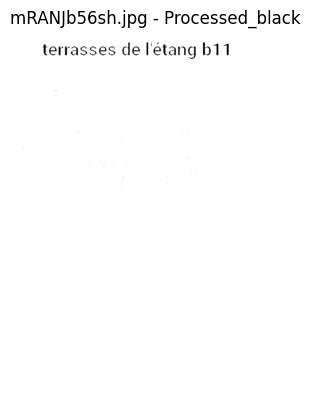

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


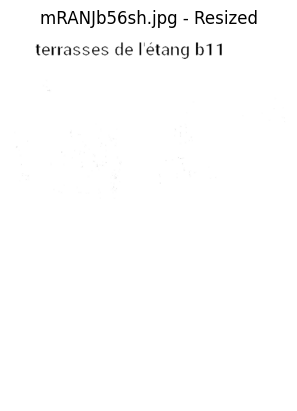

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang b11"] <===
Duration: 6.3 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang b11 <===

Processing file: NzsDncFH2i.jpg


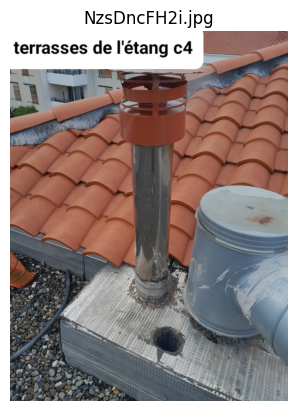

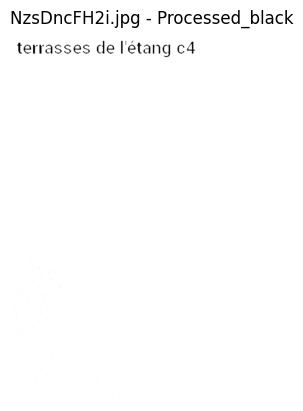

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


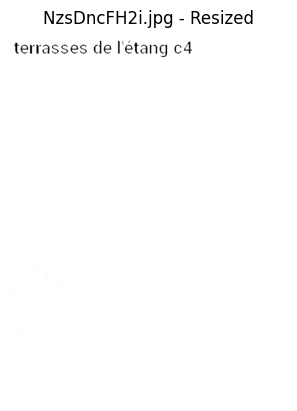

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang c4"] <===
Duration: 6.3 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang c4 <===

Processing file: Ozhw3XhuDl.jpg


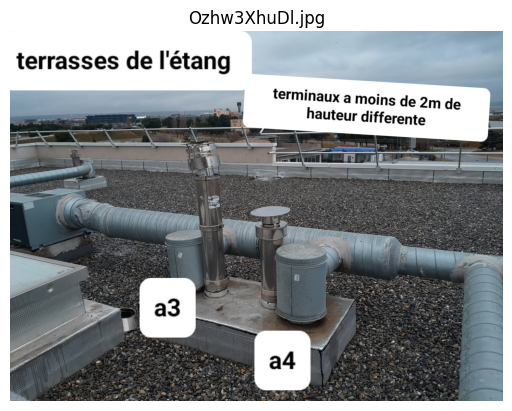

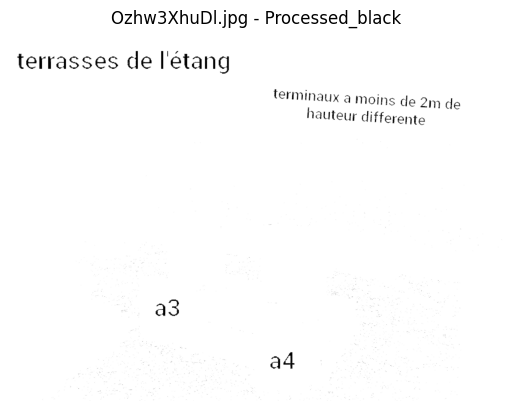

Initial image size :  (3072, 4096, 3)
resized image size :  (768, 1024, 3)


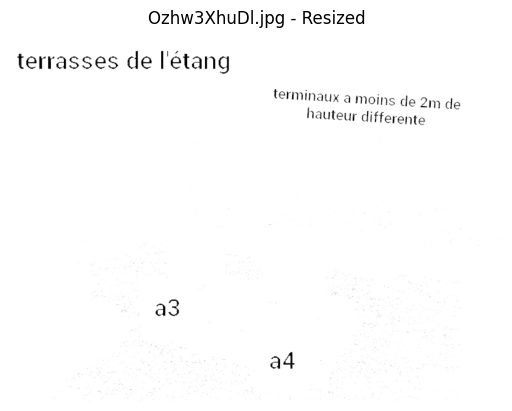

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang", 'terminaux', 'a moins de 2m de', 'hauteur differente', 'a3', 'a4'] <===
Duration: 6.4 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang
terminal
à moins de 2m de
hauteur différente
a3
a4 <===

Processing file: rAj0zEkO9Q.jpg


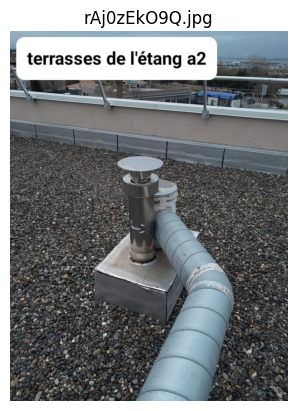

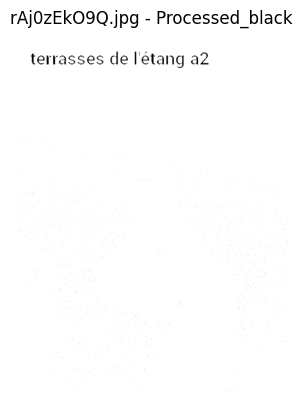

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


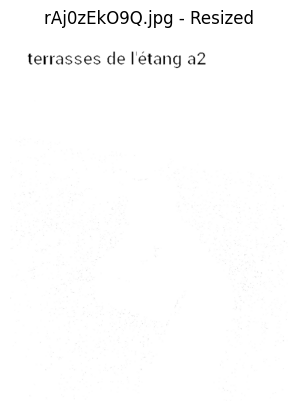

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang a2"] <===
Duration: 6.2 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a2 <===

Processing file: SgKs1wkDDo.jpg


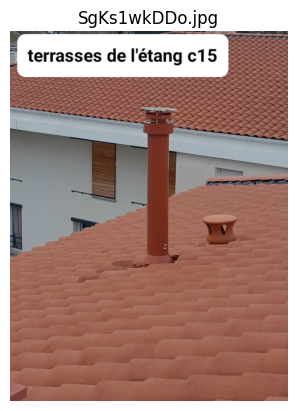

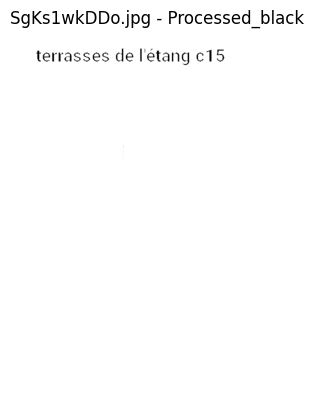

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


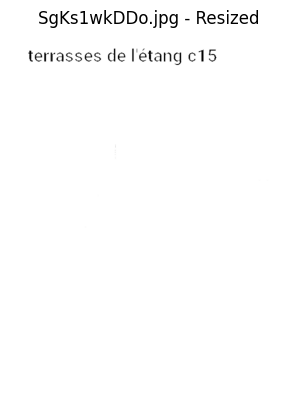

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de létang c15'] <===
Duration: 6.4 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang c15 <===

Processing file: t181U9xgKf.jpg


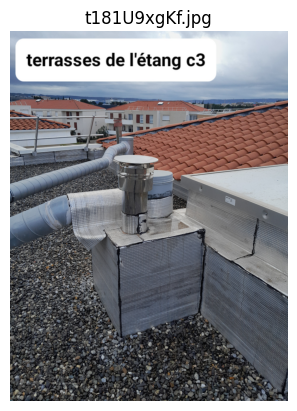

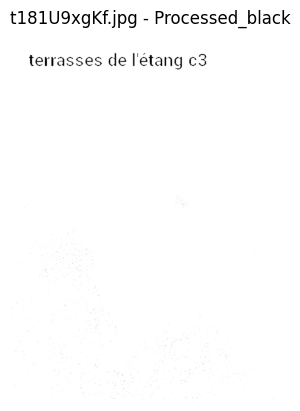

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


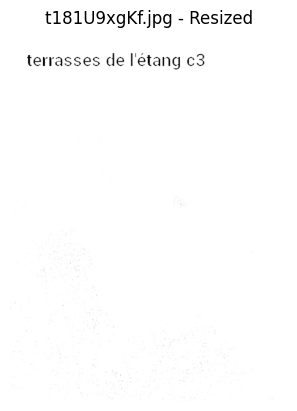

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de', 'Iétang c3'] <===
Duration: 6.2 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de
Étang c3 <===

Processing file: tRzXfkqDDx.jpg


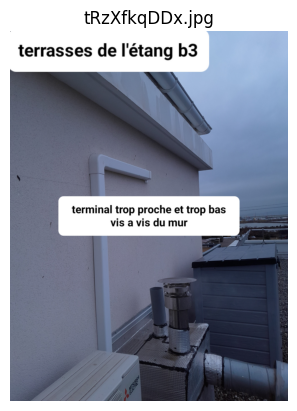

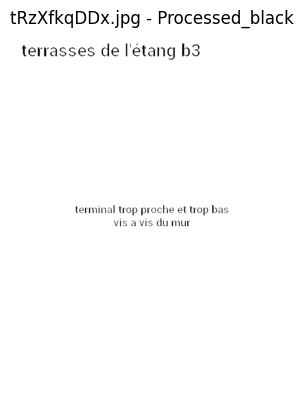

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


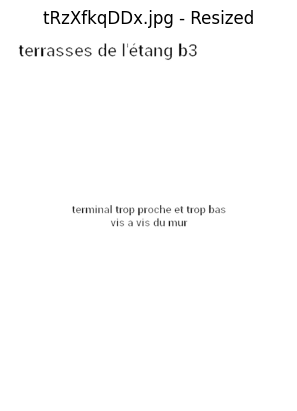

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang b3", 'terminal trop proche et trop bas', 'vis a vis du mur'] <===
Duration: 6.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang b3
terminal trop proche et trop bas
vis-à-vis du mur <===

Processing file: X9qABIK5xt.jpg


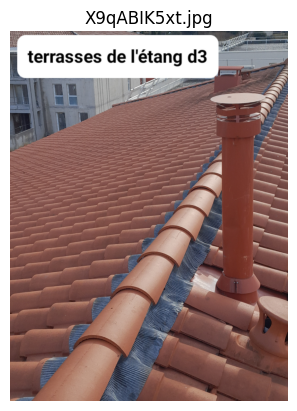

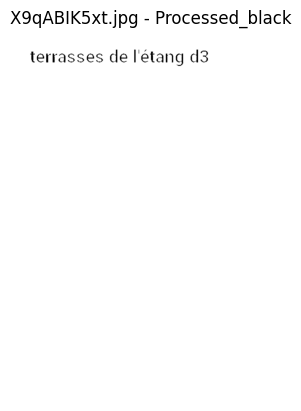

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


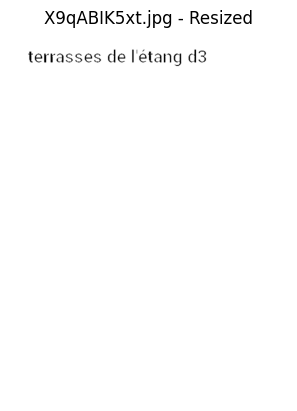

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang d3"] <===
Duration: 6.3 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang d3 <===

Processing file: YRqvXYjA1H.jpg


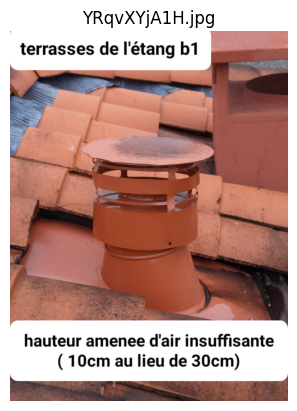

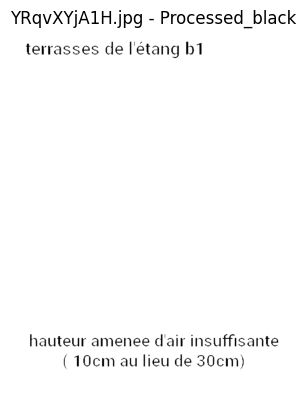

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


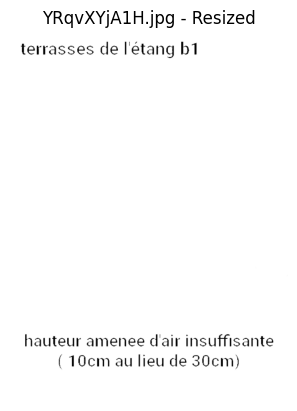

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang b1", 'hauteur amenee dair insuffisante', '10cn au lieu de 30cm2'] <===
Duration: 7.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang b1
hauteur amenée d'air insuffisante
10 cN au lieu de 30,2 cm <===

Processing file: zArWXdmcFR.jpg


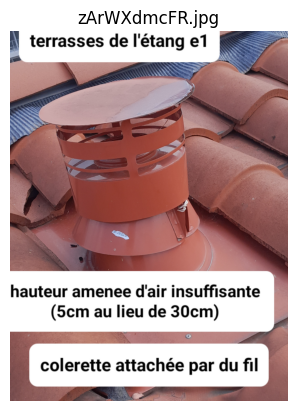

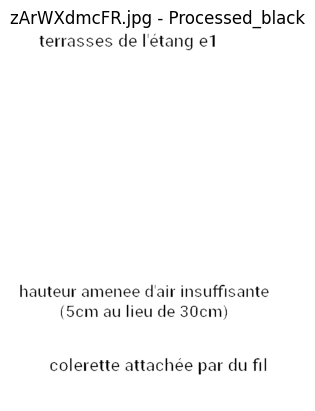

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


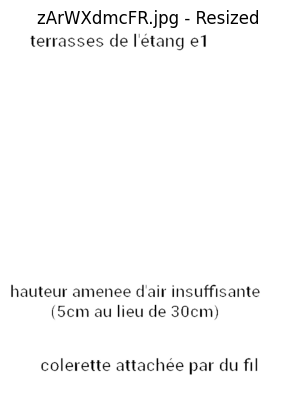

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de', 'Iétang e1', 'hauteur amenee dair insuffisante', 'G5cm au lieu de 30cm2', 'colerette attachée par du fil'] <===
Duration: 8.0 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de
Étang e1
hauteur amenée d'air insuffisante
Cm au lieu de 30,2 cm
collerette attachée par du fil <===

 ***************************************************************************

SUBDIRECTORY: 1 - Combles

Processing file: 9RWYbejhQ5.jpg


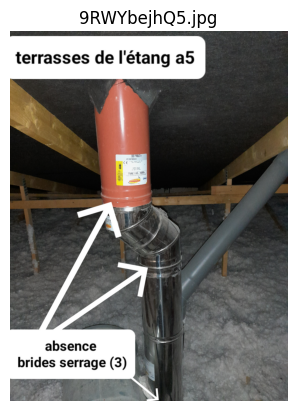

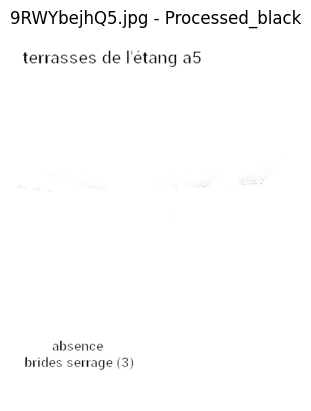

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


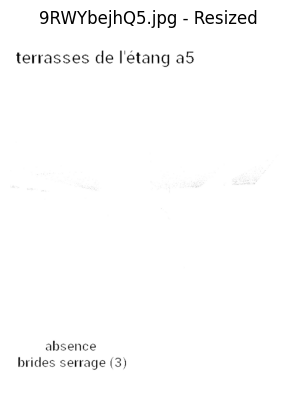

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang a5", 'absence', 'brides serrage 63'] <===
Duration: 7.8 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a5
absence
brides serrage 63 <===

Processing file: cfBLm8PEPG.jpg


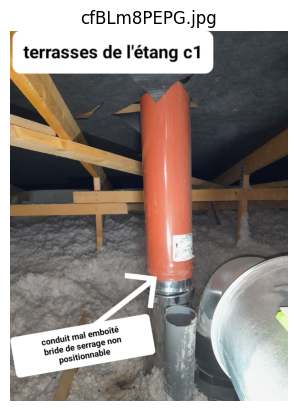

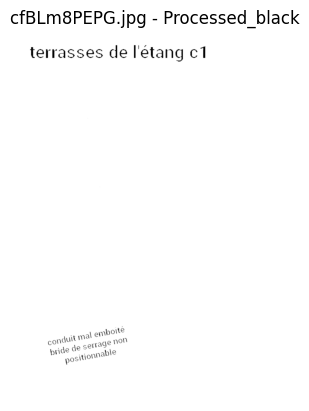

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


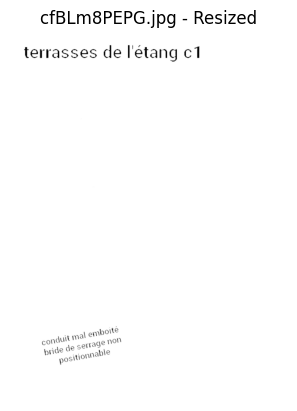

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de létang c1', 'de', 'emboité', 'mal', 'conduit', 'non', 'serrage', 'bride', 'positionnable'] <===
Duration: 7.9 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang c1
d'emboité
mal
conduit
non-serrage
bride
position nable <===

Processing file: Cyv1ACf9UX.jpg


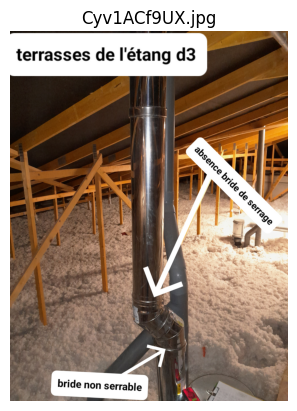

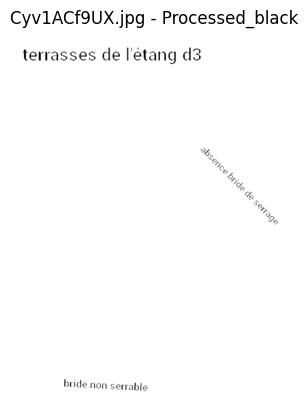

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


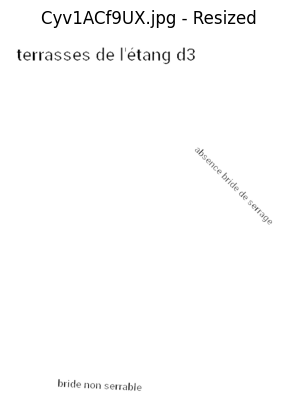

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang d3", '9', 'bride non serrable', '1', 'bride', '9'] <===
Duration: 7.8 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang d3
9
bride non s'érafle
1
bride
9 <===

Processing file: EDLrfe1FPZ.jpg


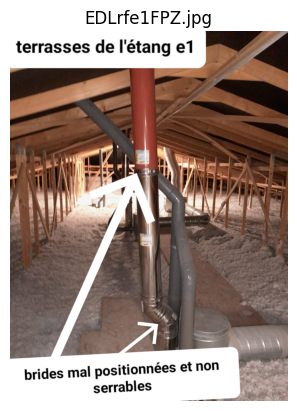

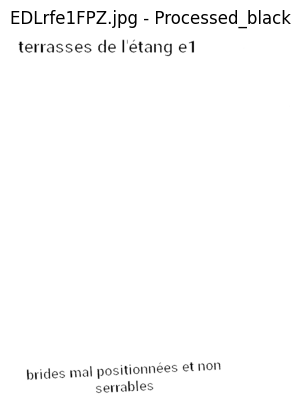

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


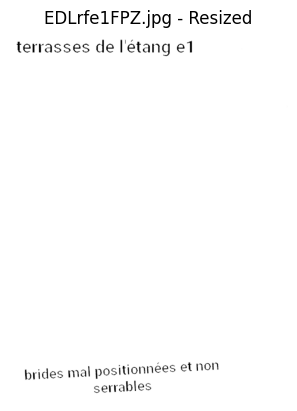

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang e1", 'brides mal', 'positionnées', 'et non', 'serrables'] <===
Duration: 7.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang e1
brides mal
positionnées
et non
s'érafles <===

Processing file: IcnyquvDcv.jpg


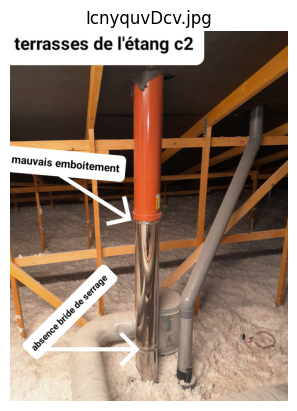

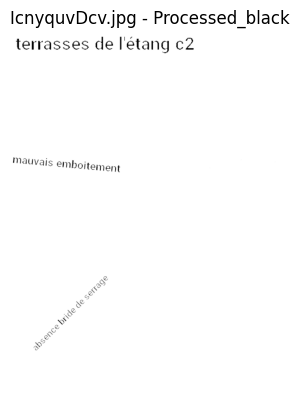

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


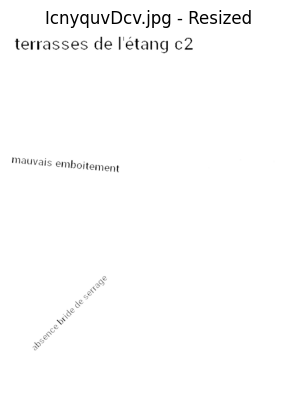

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de Iétang c2', 'mauvais', 'JQ', 'emboitement', 'serrage', 'bride', 'ence', 'abse'] <===
Duration: 7.9 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de Étang c2
mauvais
JE
emboitement
serrage
bride
en ce
base <===

Processing file: lt30o5OO5t.jpg


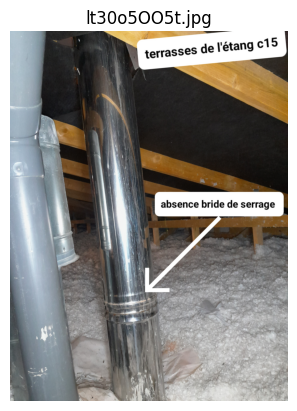

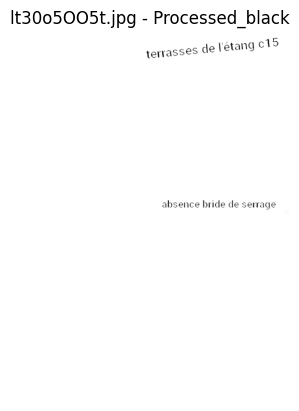

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


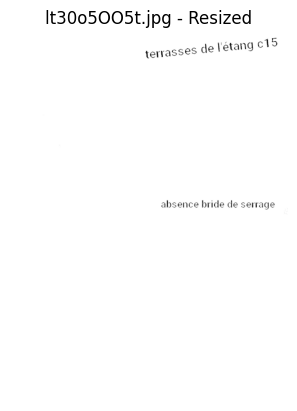

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["de F'étang c15", 'terrasses', 'absence bride de serrage'] <===
Duration: 7.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> De Étang c15
terrasses
absence bride de serrage <===

Processing file: LtBB6g1aRA.jpg


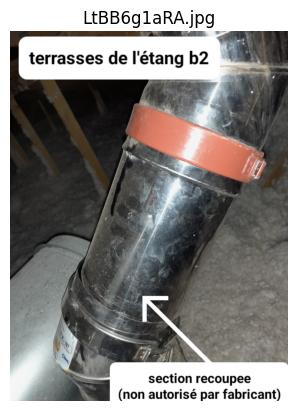

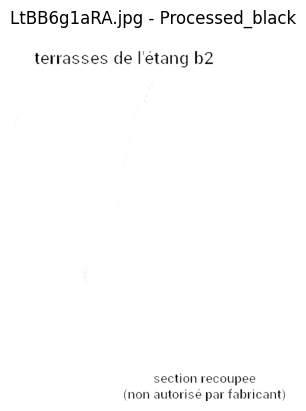

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


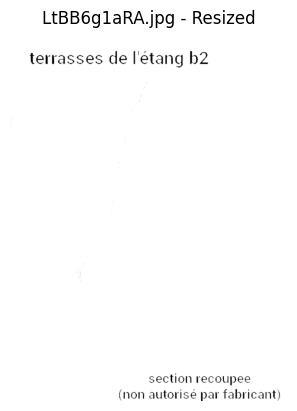

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de', 'Iétang b2', 'section recoupee', 'Inon autorisé par fabricant'] <===
Duration: 7.8 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de
Étang b2
section recoupée
Non autorisé par fabricant <===

Processing file: NTrYI6jHhs.jpg


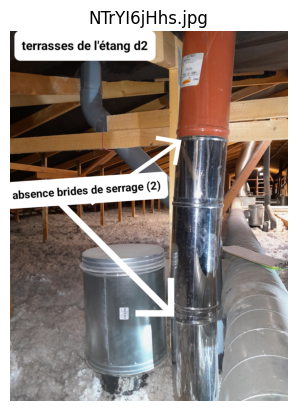

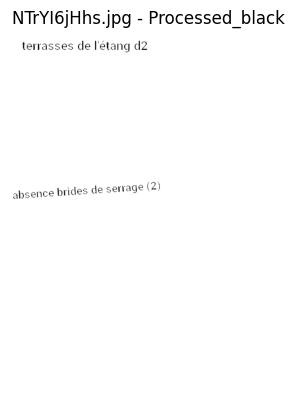

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


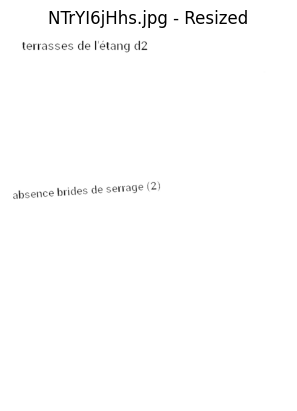

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de I'étang d2", 'alsence brides de serage N29'] <===
Duration: 7.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de Étang d2
absence brides de s'étage N29 <===

Processing file: qe89hMOP8P.jpg


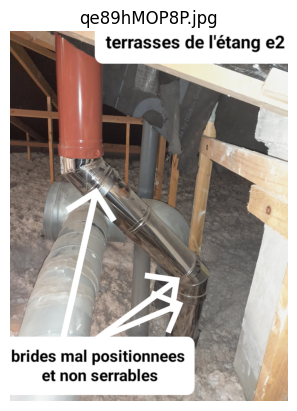

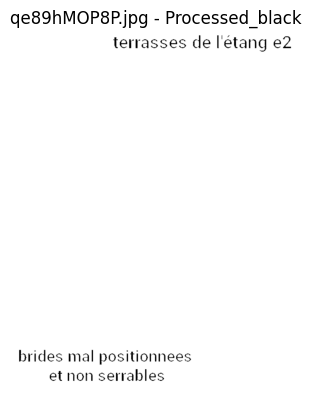

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


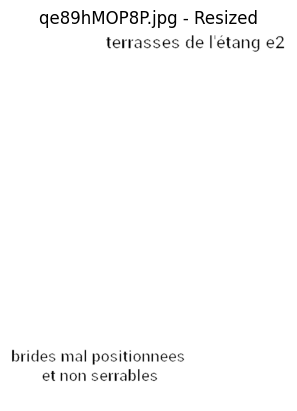

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang e2", 'brides mal positionnees', 'et non serrables'] <===
Duration: 7.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang e2
brides mal positionnées
et non s'érafles <===

Processing file: VhrzwXd8mv.jpg


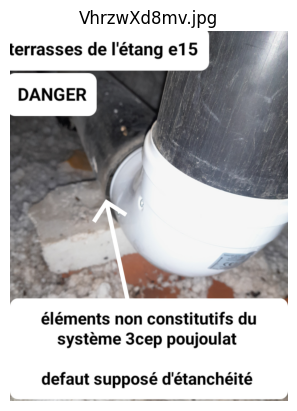

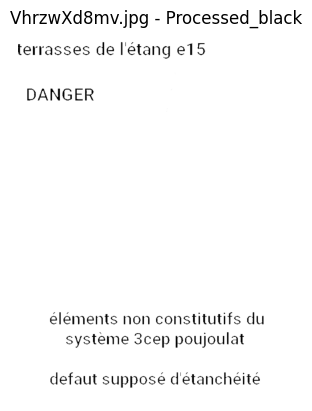

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


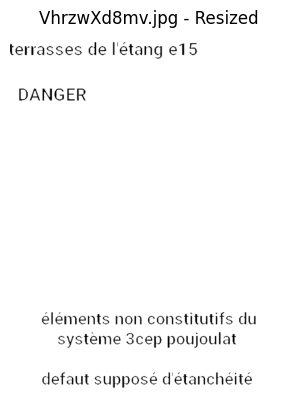

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang e15", 'DANGER', 'éléments non constitutifs du', 'système 3cep poujoulat', 'defaut supposé détanchéité'] <===
Duration: 7.9 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang e15
DANGER
éléments non constitutifs du
système 3 cep bouboulât
défaut supposé d'étanchéité <===

Processing file: wbOHubfQuo.jpg


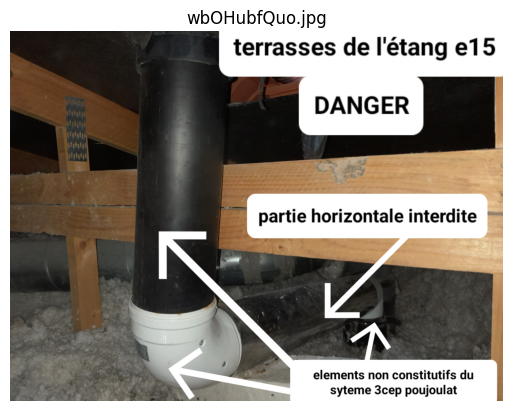

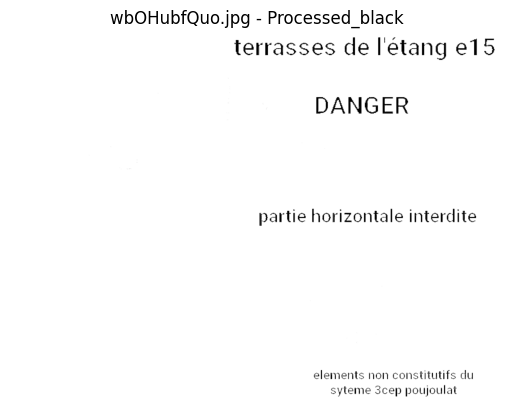

Initial image size :  (3072, 4096, 3)
resized image size :  (768, 1024, 3)


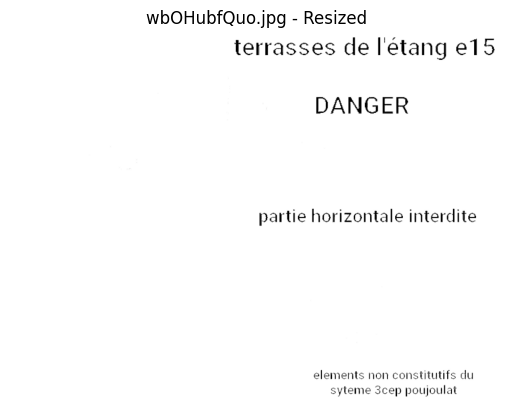

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de létang e15', 'DANGER', 'partie horizontale interdite', 'elements non constitutifs du', 'syteme 3cep poujoulat'] <===
Duration: 8.0 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang e15
DANGER
partie horizontale interdite
éléments non constitutive du
système 3 cep bouboulât <===

Processing file: ZVKV2mExLj.jpg


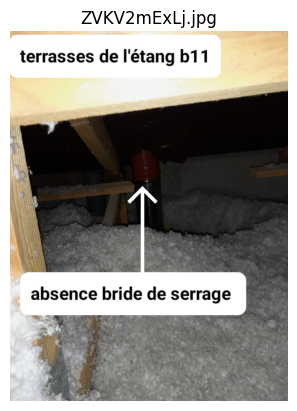

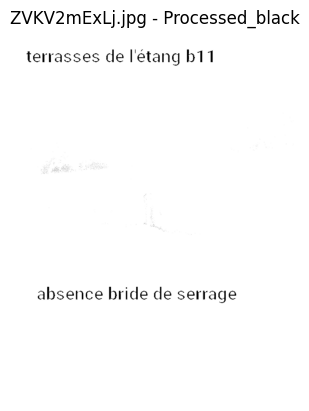

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


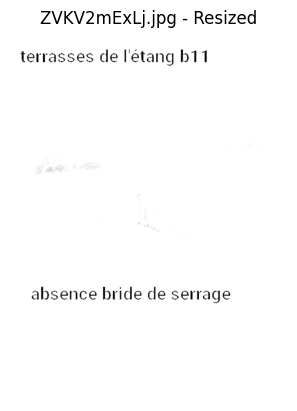

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'étang b11", 'absence bride de serrage'] <===
Duration: 7.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang b11
absence bride de serrage <===

 ***************************************************************************

SUBDIRECTORY: 2 - Conduits

Processing file: 2o1i0vP7iR.JPG


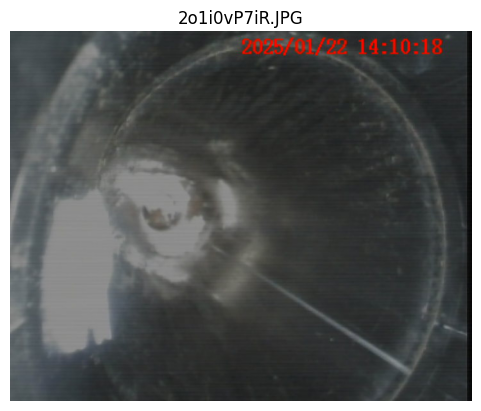

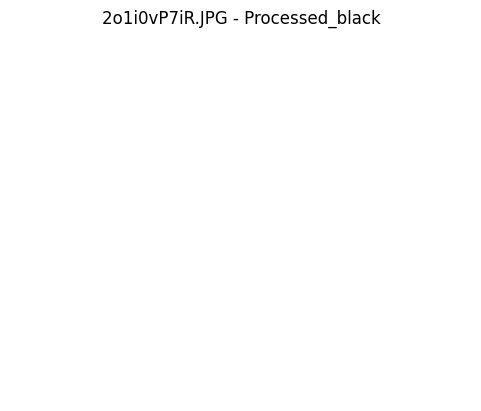

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


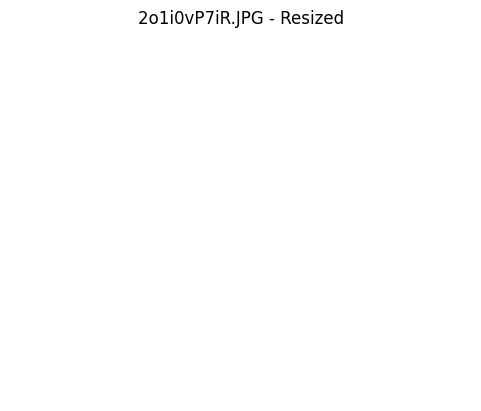

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: 3bA7kJjwPC.JPG


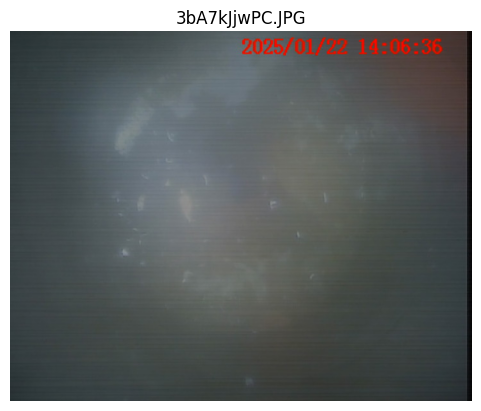

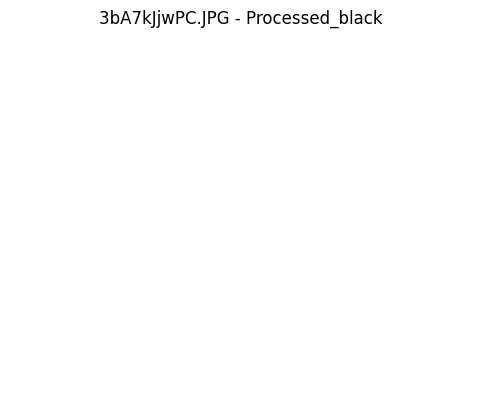

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


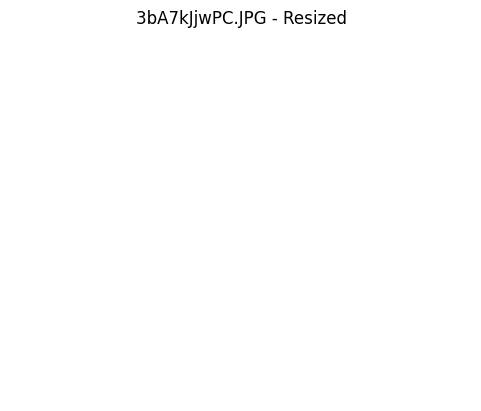

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: 3RDW2CM7KP.JPG


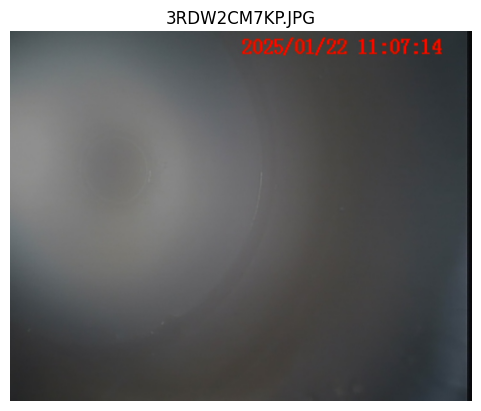

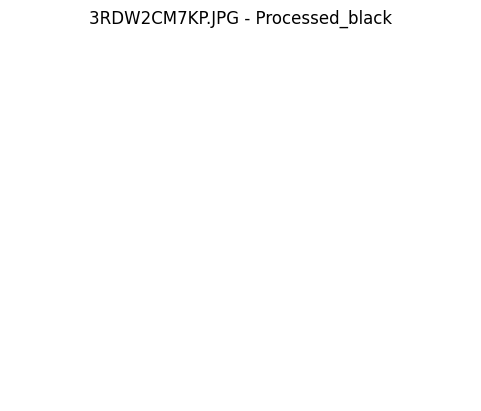

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


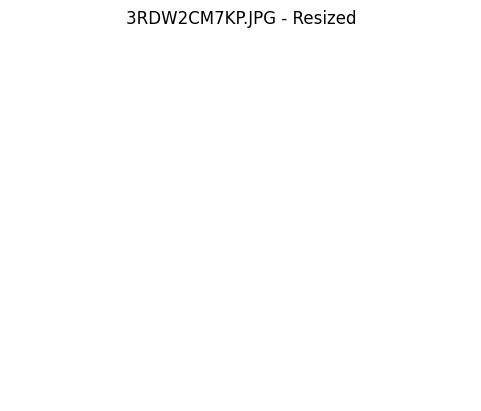

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: 5I2CY1FjZ1.JPG


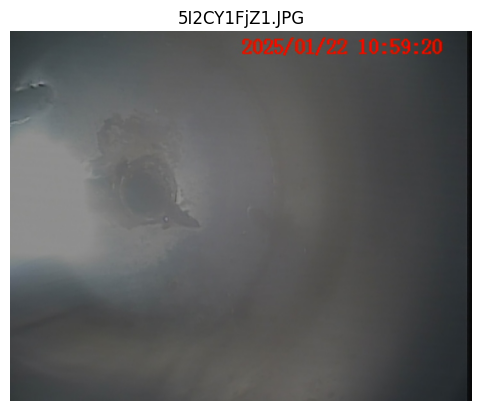

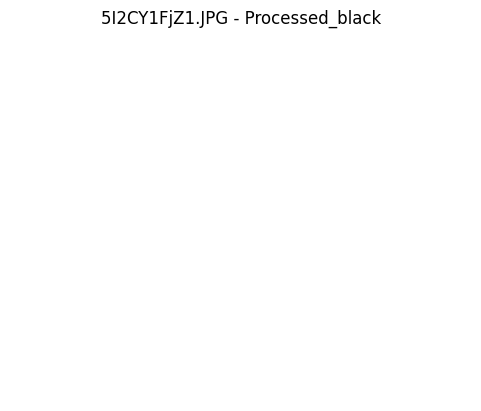

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


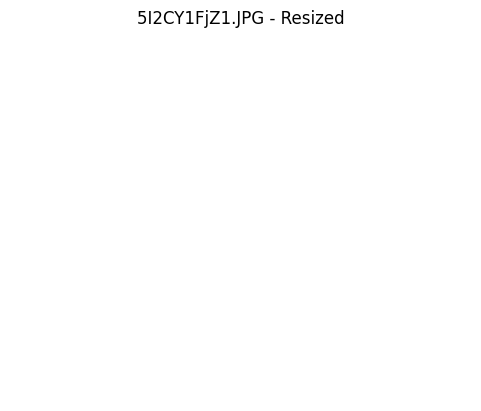

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: 7bmRTc8XaT.JPG


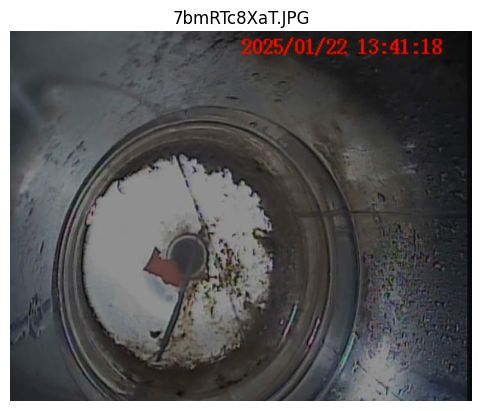

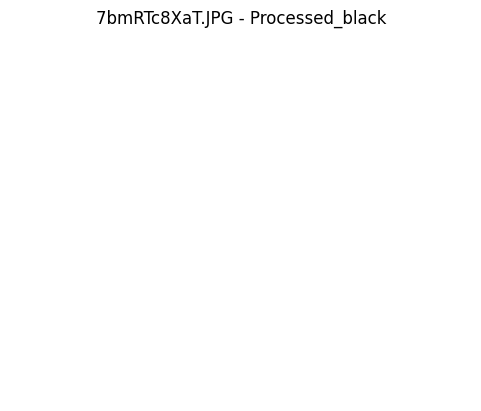

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


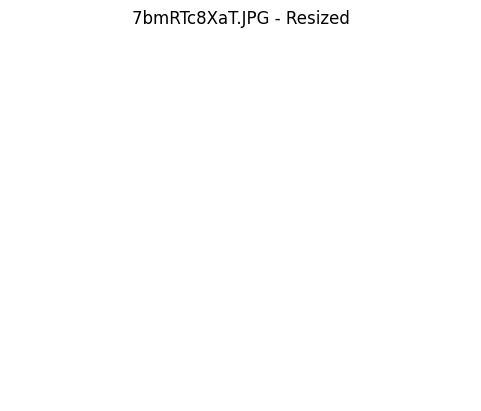

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: 8V1UWCVPpM.JPG


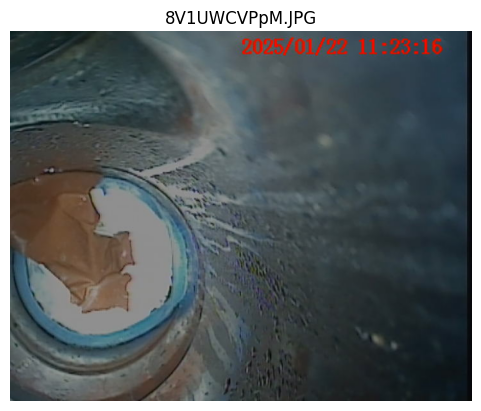

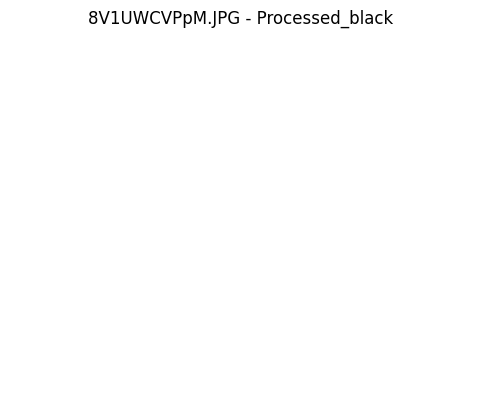

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


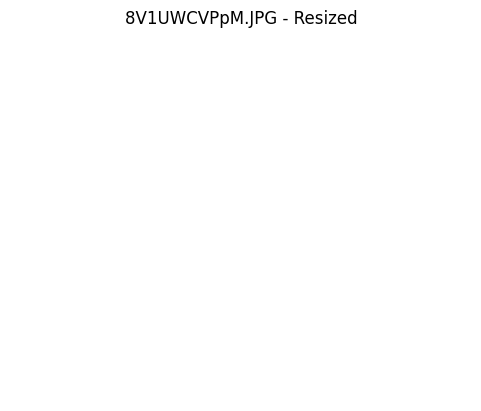

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: BLcJ4pea71.JPG


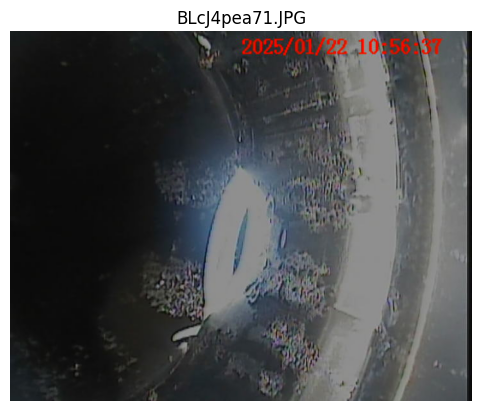

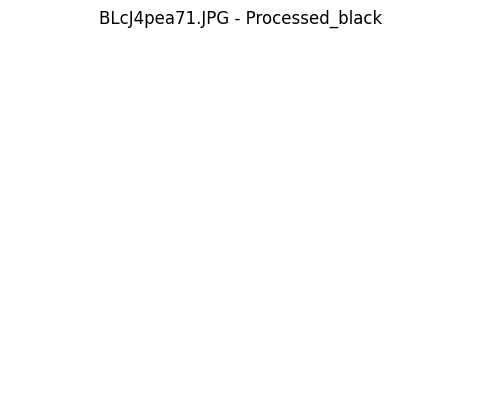

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


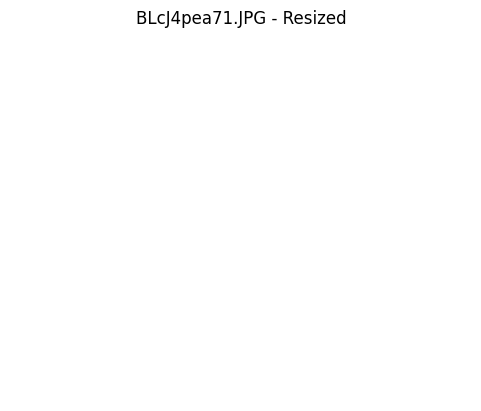

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.4 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: c6E0kOILVG.JPG


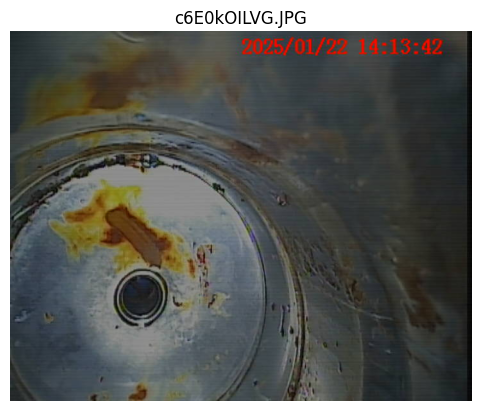

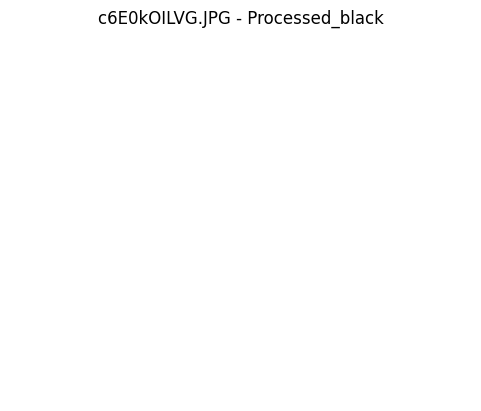

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


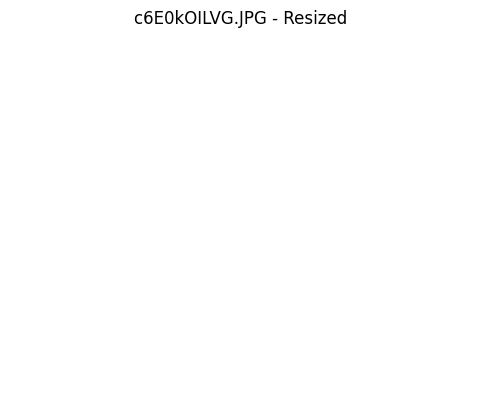

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: CqPRv06QaR.JPG


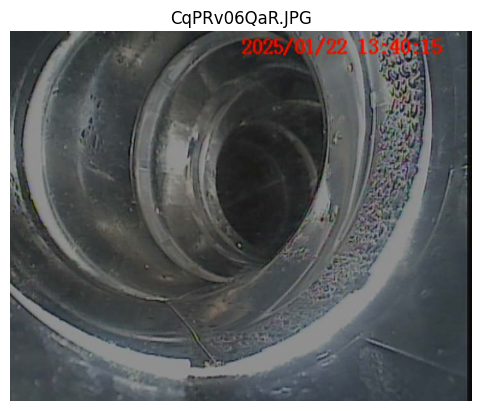

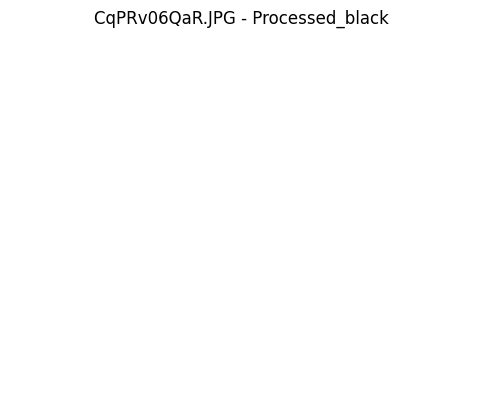

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


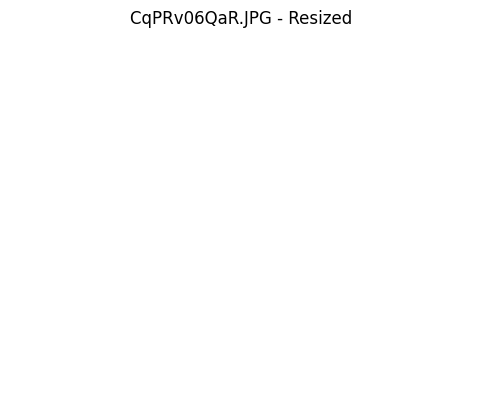

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: DfSTXL5eaa.JPG


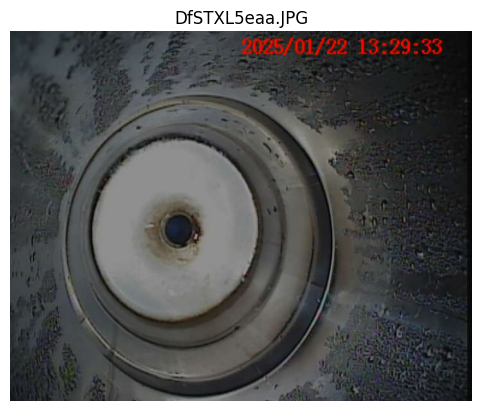

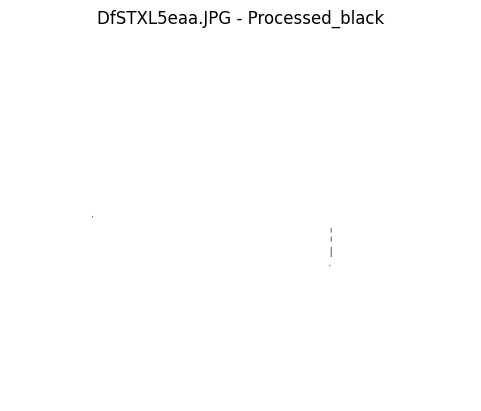

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


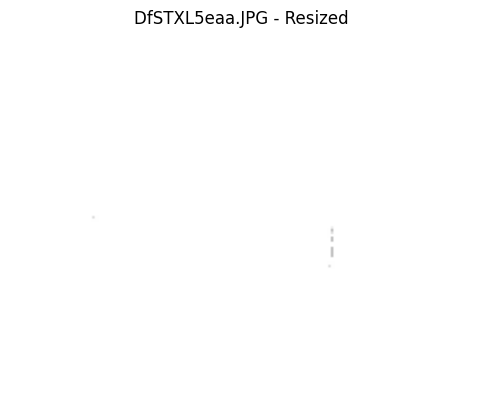

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: FWiaPtr6Ry.JPG


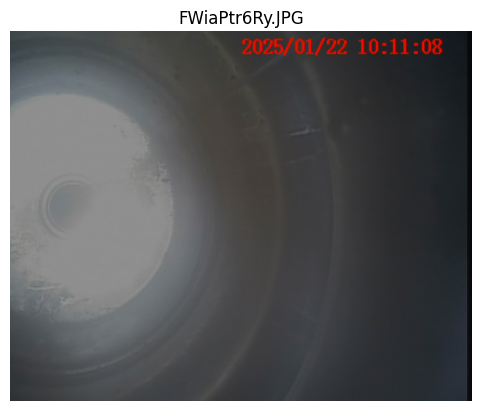

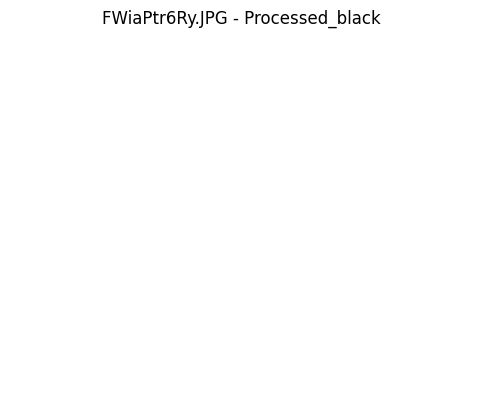

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


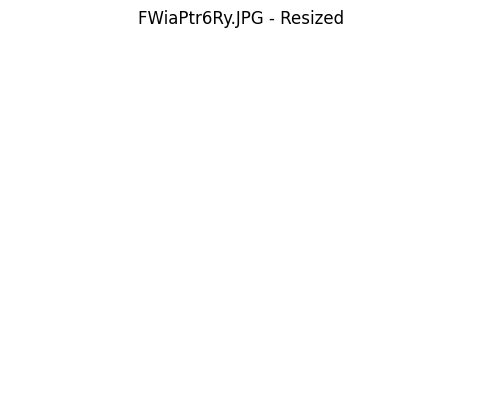

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: gd1L0eaEBd.JPG


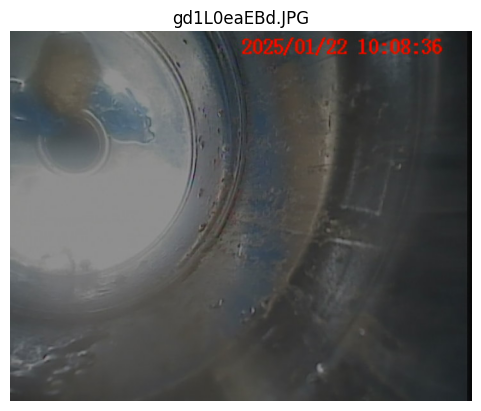

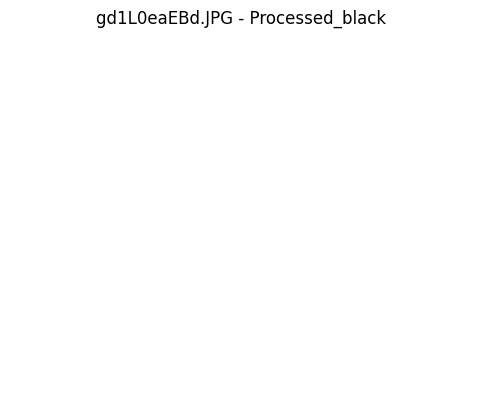

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


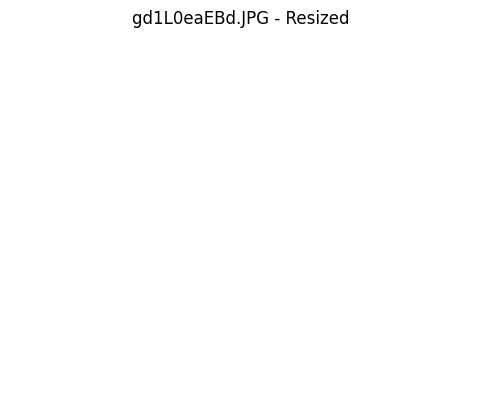

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: gu4LHv4Fbc.JPG


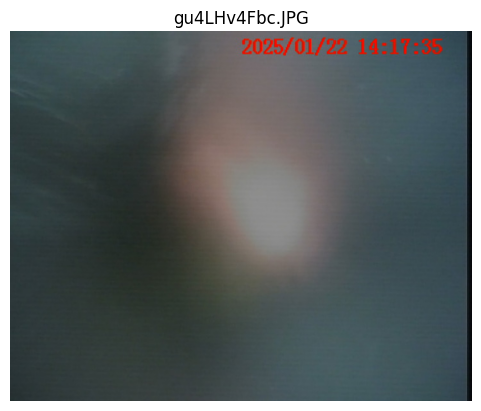

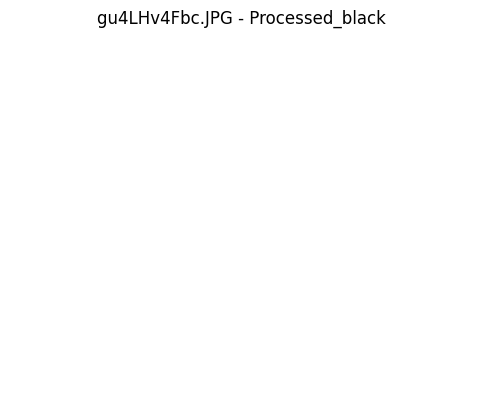

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


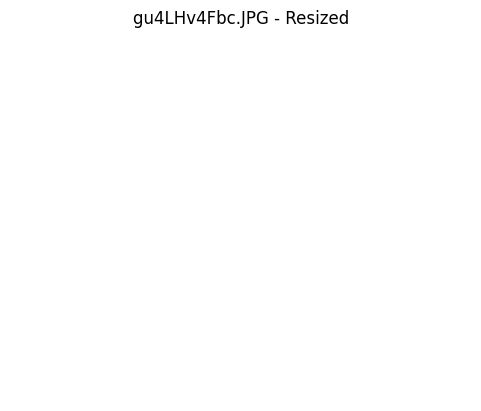

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: iHrfZxJOd4.JPG


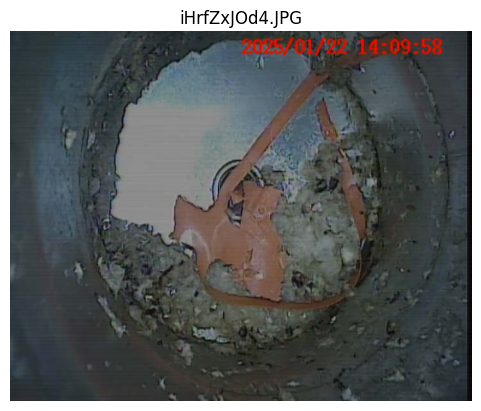

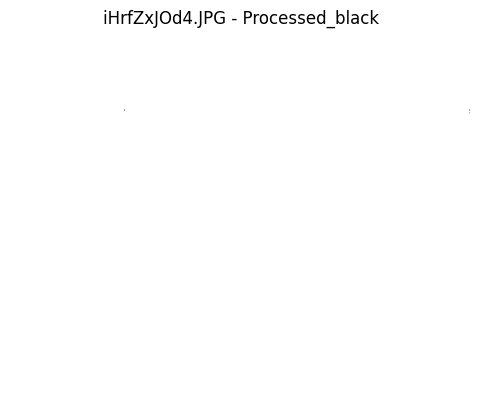

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


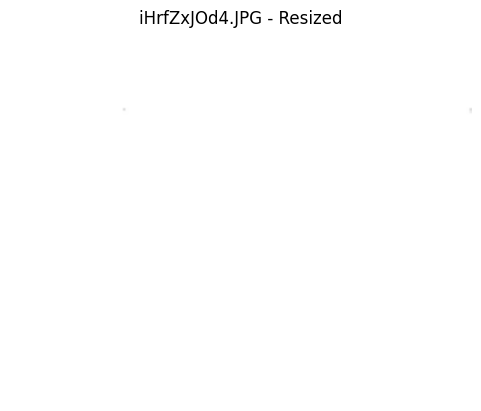

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: j2vpZfYA5l.JPG


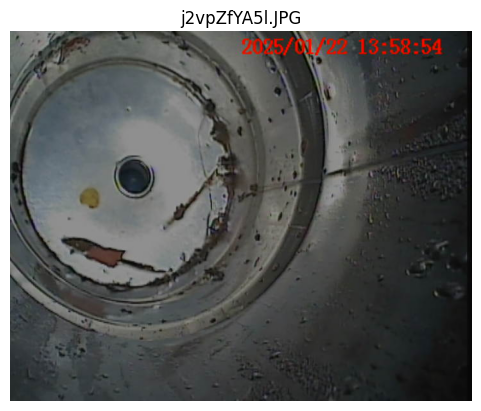

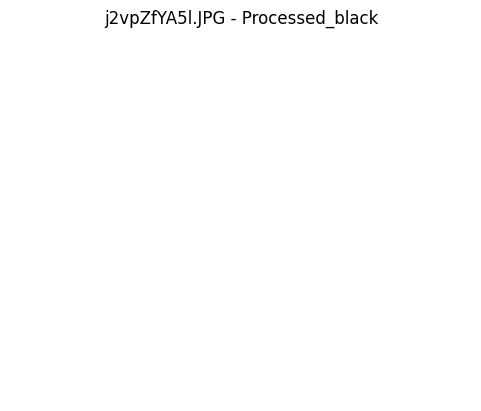

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


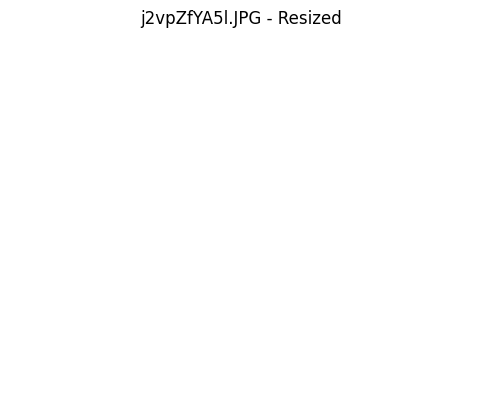

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: LoBVdtHlKg.JPG


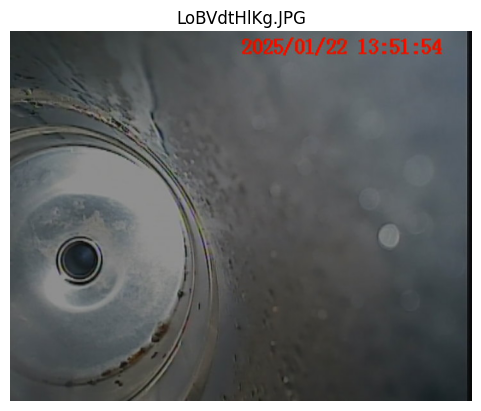

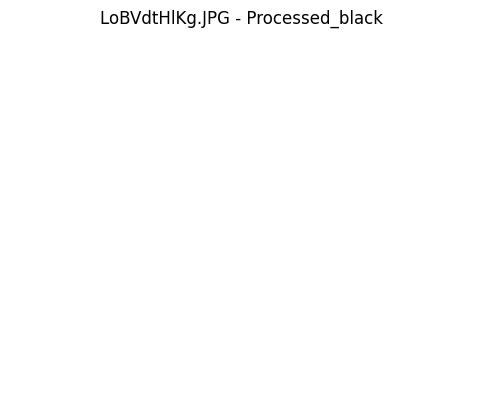

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


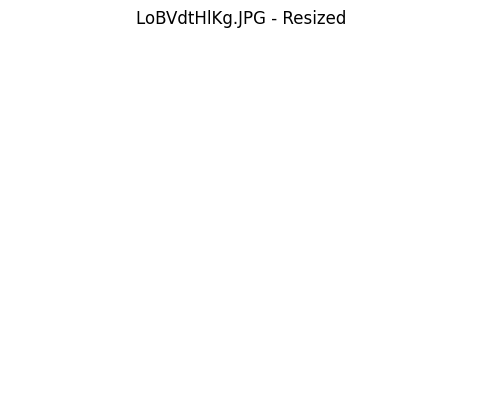

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: lRHpAJrfKV.JPG


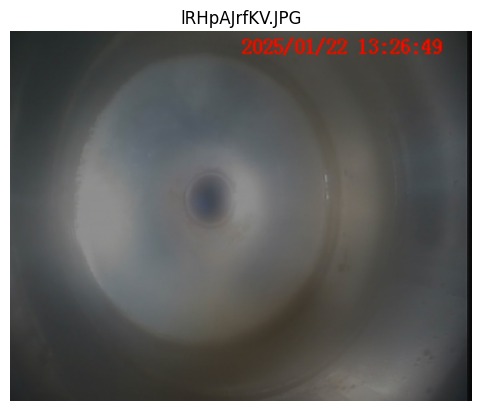

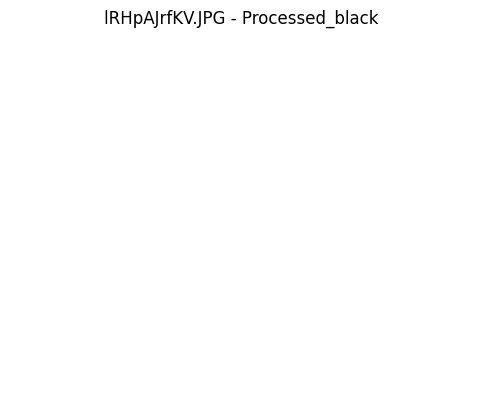

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


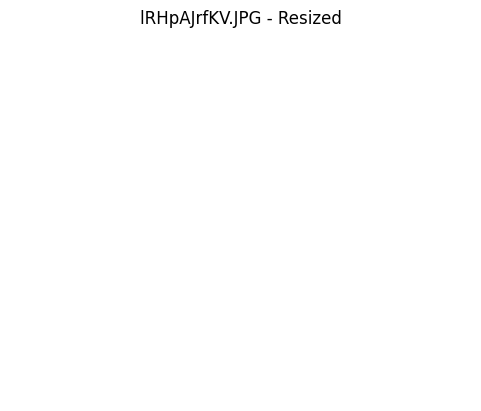

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: n5IM6DIPEd.JPG


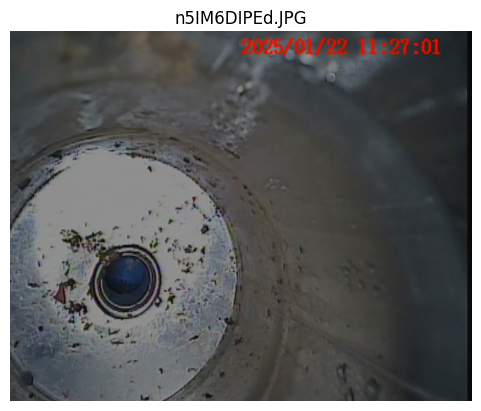

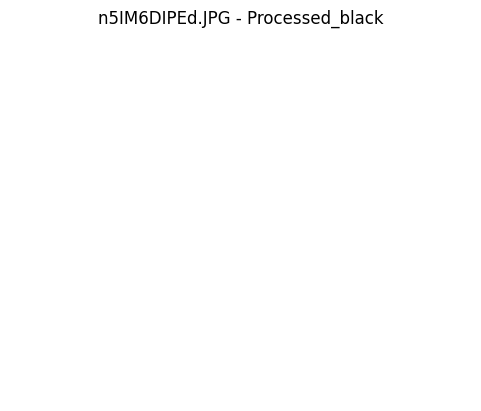

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


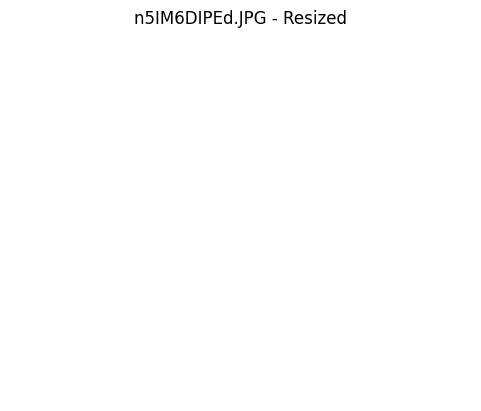

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: NakR8ljRhC.JPG


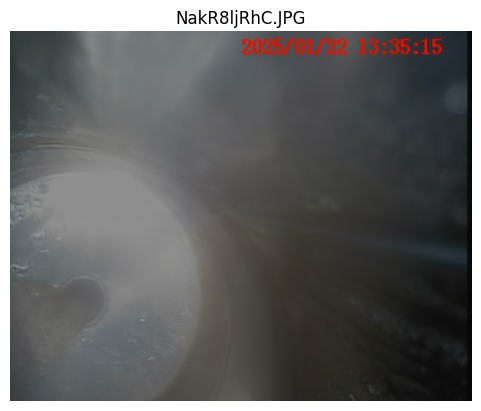

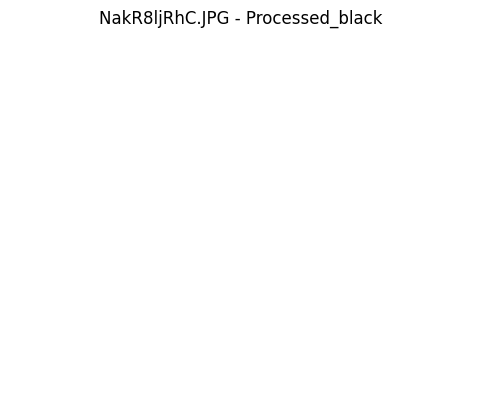

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


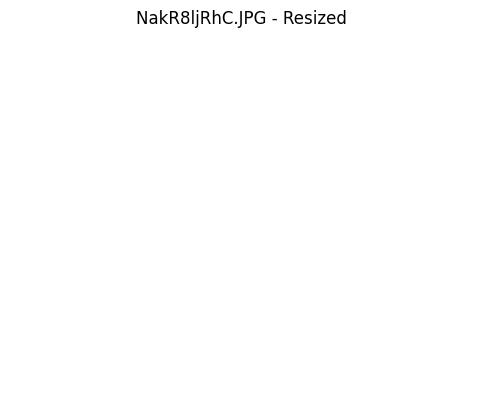

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: NlN7yPWqzh.JPG


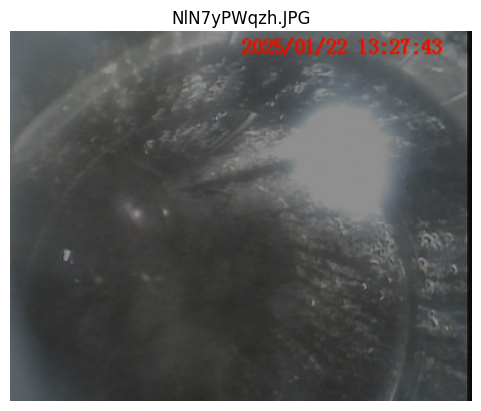

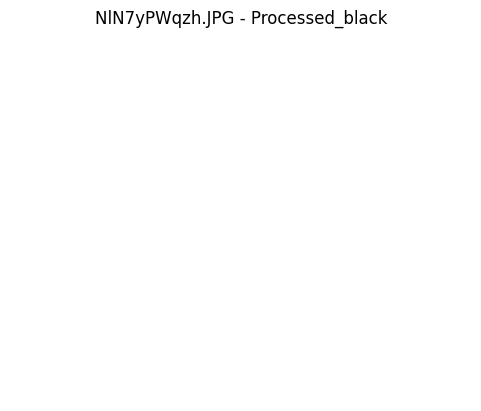

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


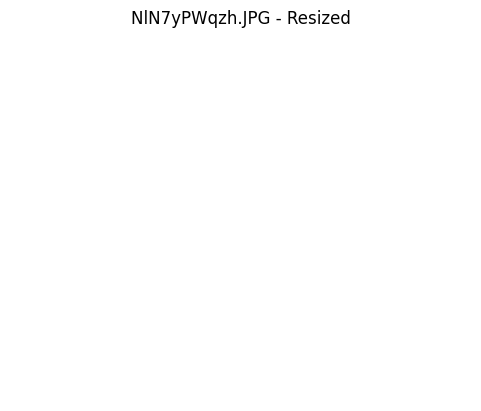

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: oSkx9WLuYk.JPG


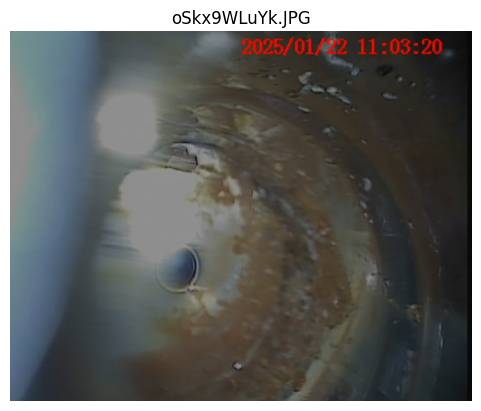

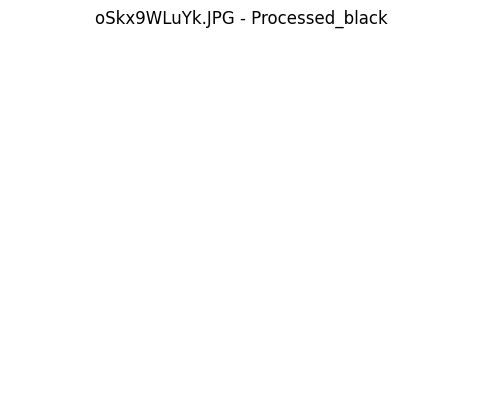

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


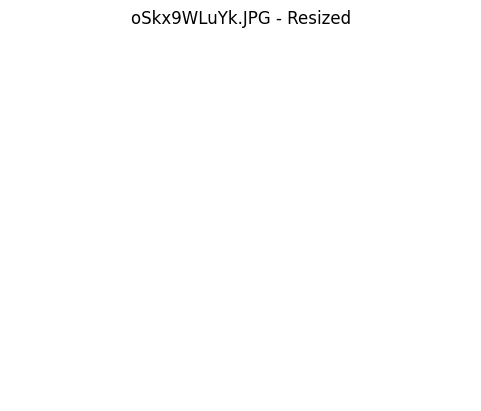

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: PXAGf0n2oj.JPG


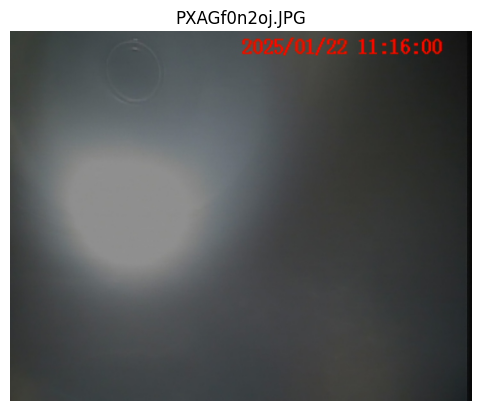

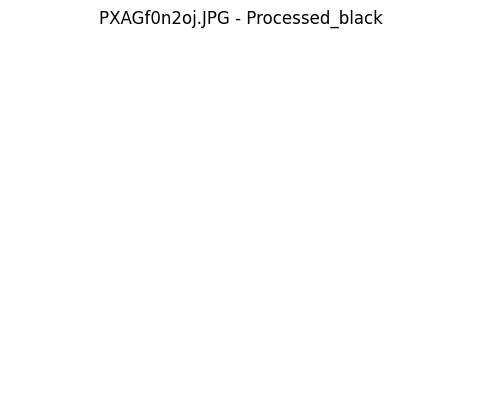

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


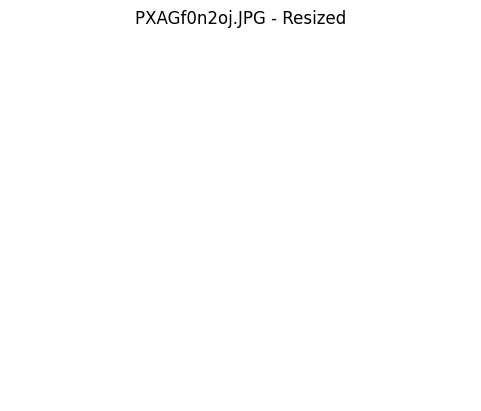

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: RJgJu70GtX.JPG


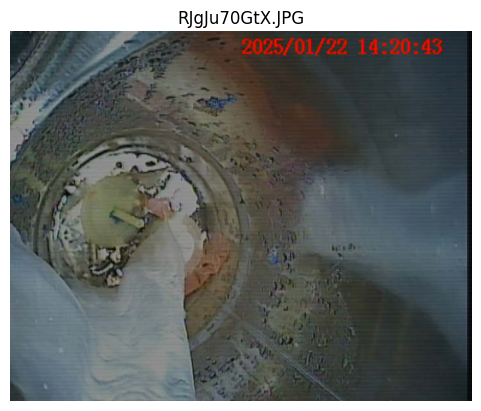

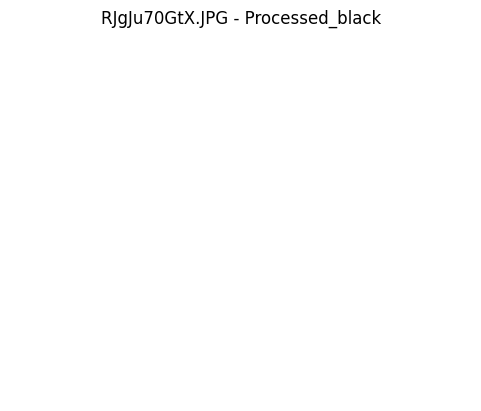

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


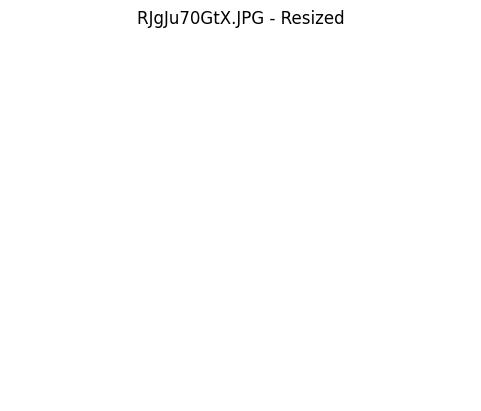

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: sb9Pw895IL.JPG


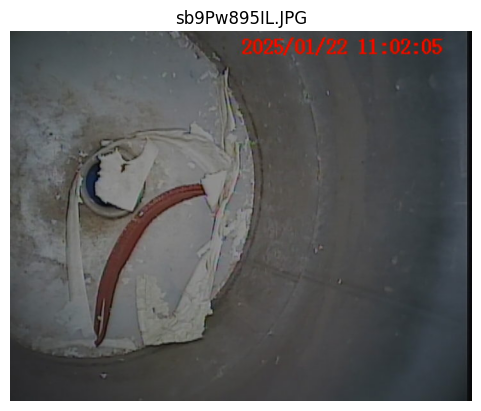

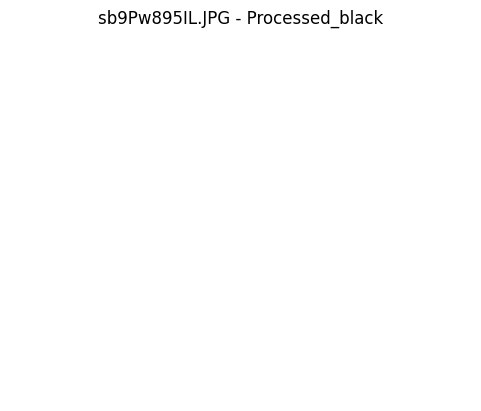

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


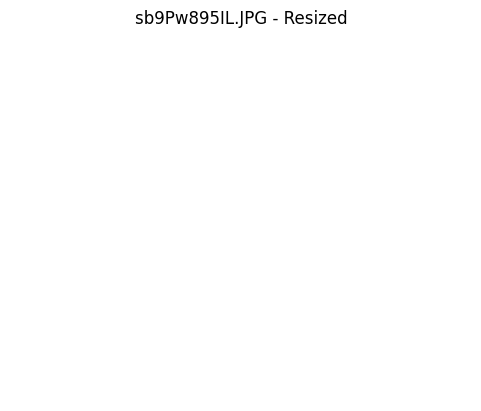

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: YkLdFwbhAw.JPG


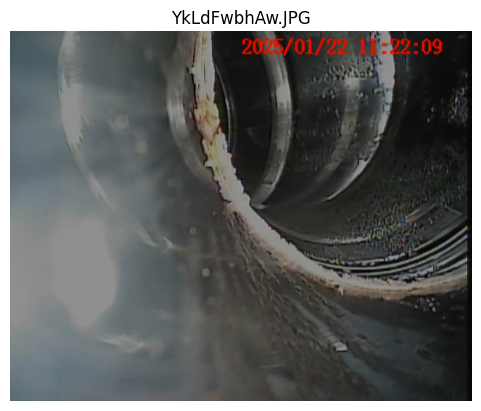

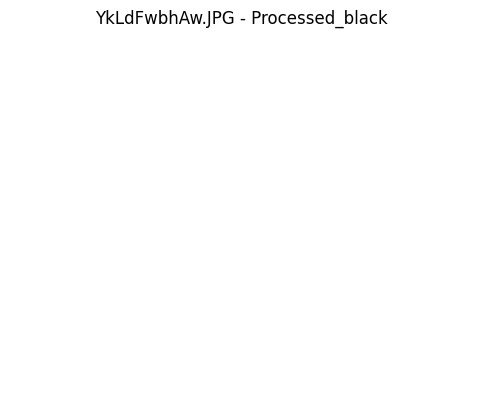

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


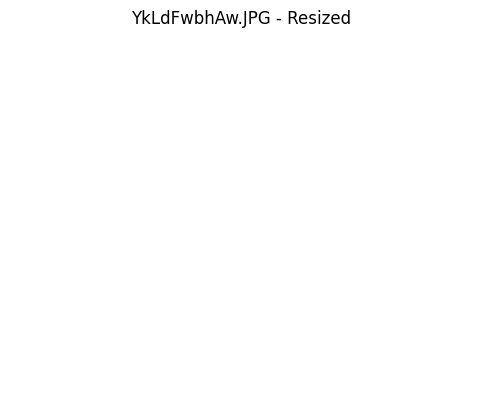

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: yleDJVkbol.JPG


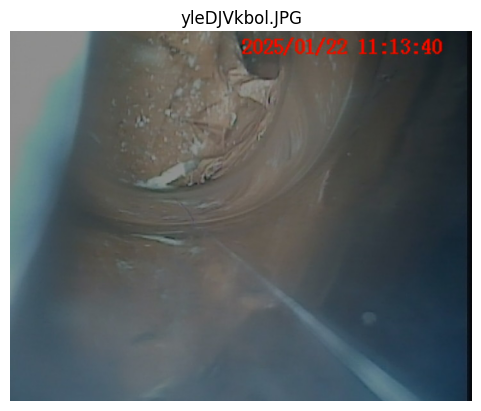

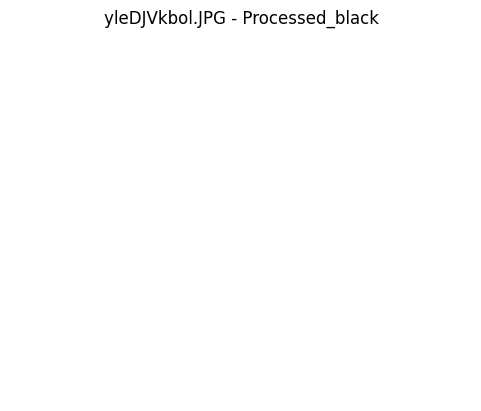

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


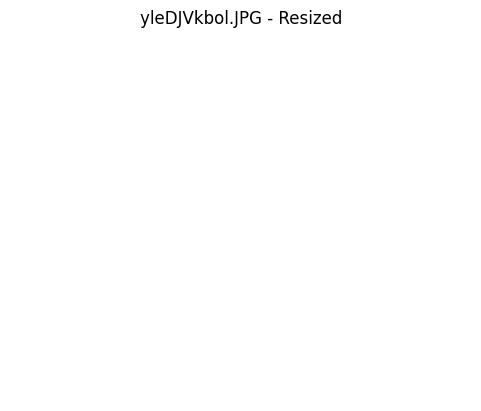

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: YQPbAreXTF.JPG


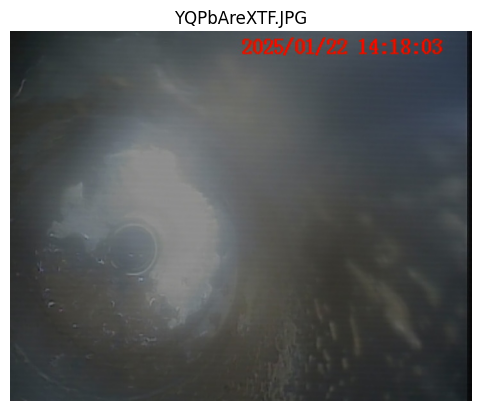

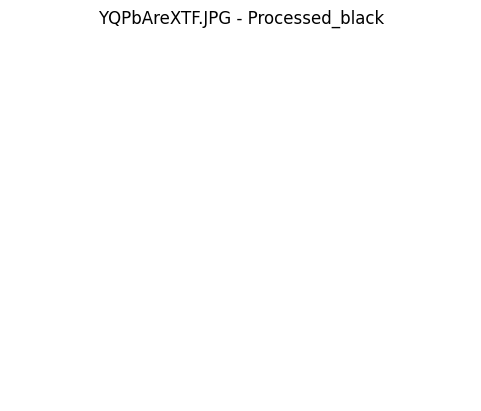

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


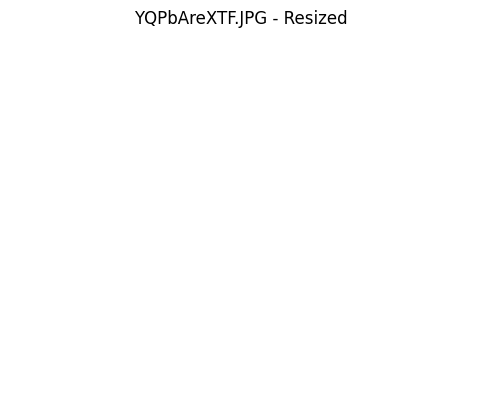

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: zCrwyKWXtt.JPG


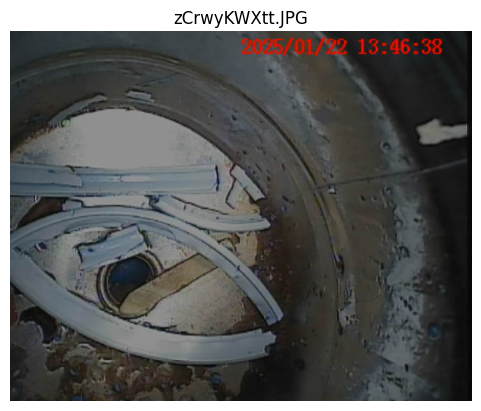

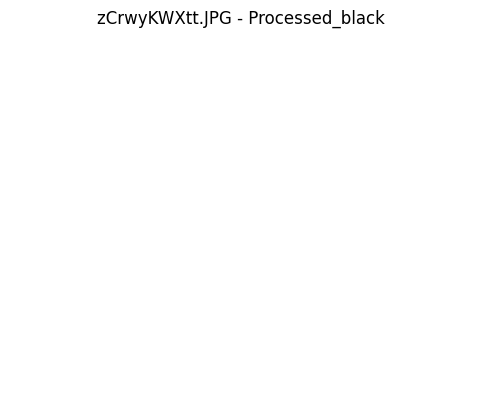

Initial image size :  (576, 720, 3)
resized image size :  (144, 180, 3)


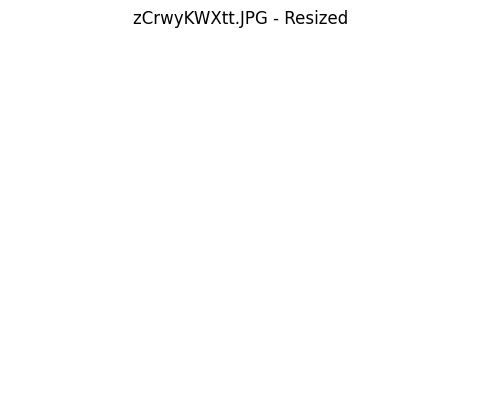

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 3.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

 ***************************************************************************

SUBDIRECTORY: 3 - Logements (2024)

Processing file: 0IoqD9JRUH.jpg


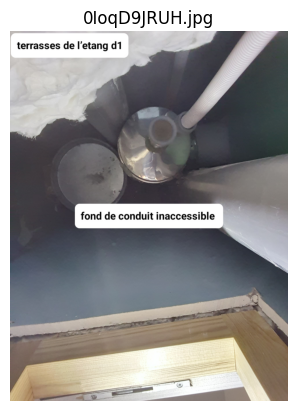

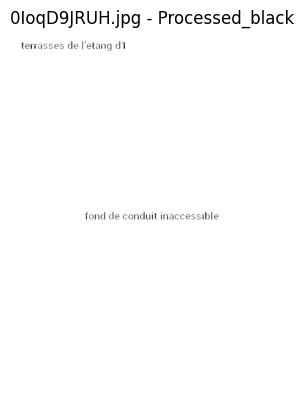

Initial image size :  (2576, 1932, 3)
resized image size :  (644, 483, 3)


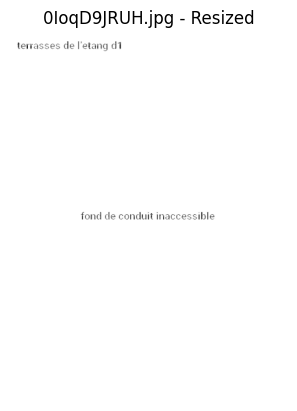

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de Vetang d1', 'fond de conduit inaccessible'] <===
Duration: 5.4 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de Étang d1
fond de conduit inaccessible <===

Processing file: 0ZDWUzu0Jv.jpg


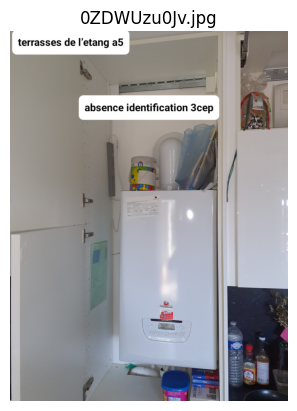

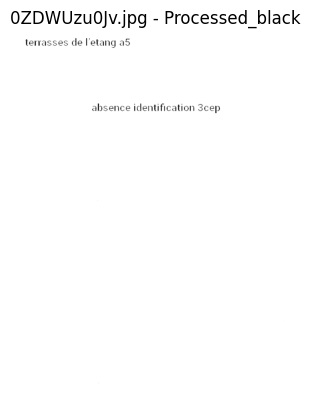

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


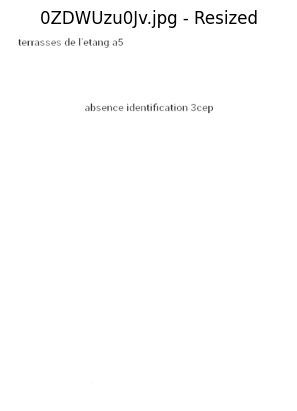

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang a5", 'ahsence identification 3cep'] <===
Duration: 7.8 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a5
absence identification 3 cep <===

Processing file: 10BZHt7QOt.jpg


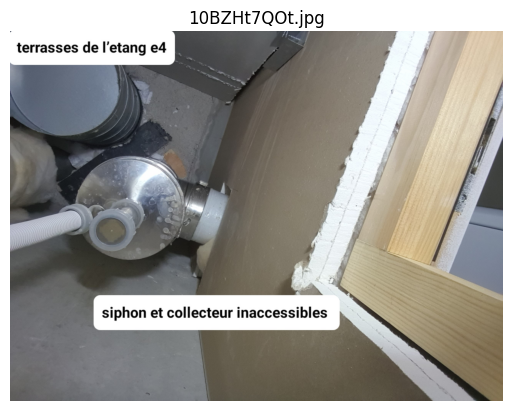

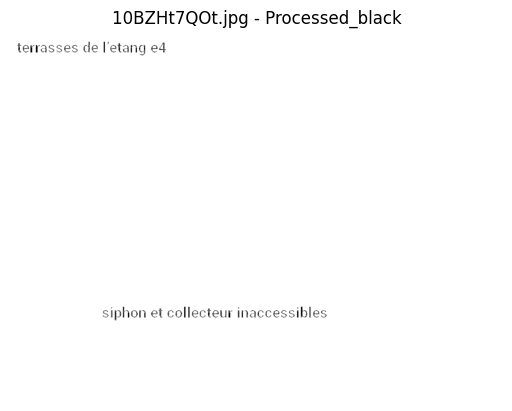

Initial image size :  (1932, 2576, 3)
resized image size :  (483, 644, 3)


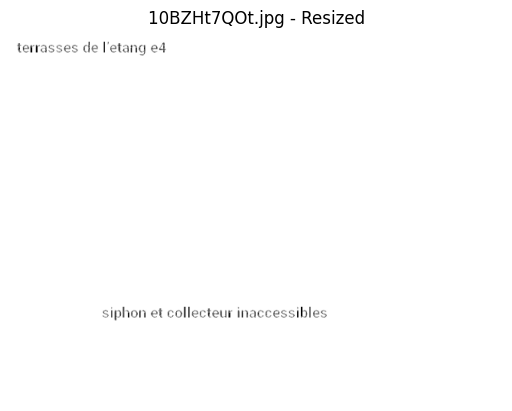

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de', 'Fetang e4', 'siphon et collecteur inaccessibles'] <===
Duration: 5.4 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de
Étang e4
siphon et collecteur inaccessibles <===

Processing file: 3c6WhEQfg5.jpg


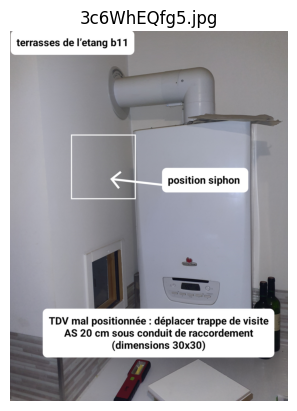

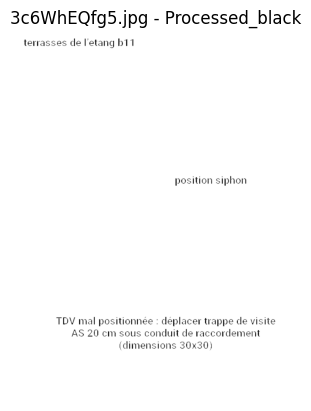

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


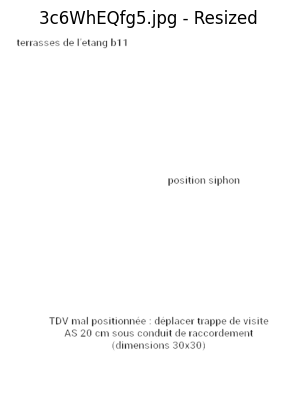

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang b11", 'position siphon', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 20 cm sous conduit de raccordement', 'Gdimensions 30x309'] <===
Duration: 8.1 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang b11
position siphon
TDV mal positionnée
déplacé trappe de visite
AS 20 cm sous-conduit de raccordement
Dimensions 30x309 <===

Processing file: 3oodYWEZvg.jpg


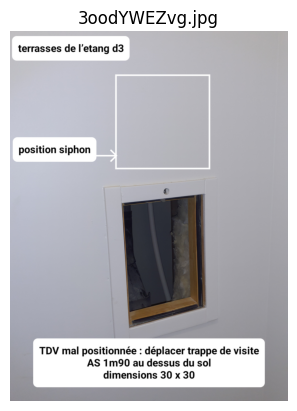

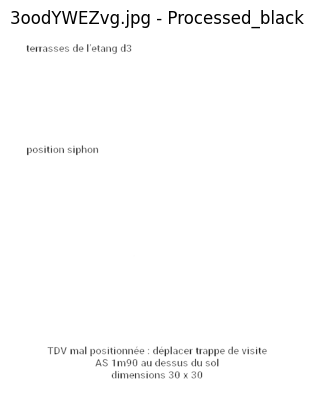

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


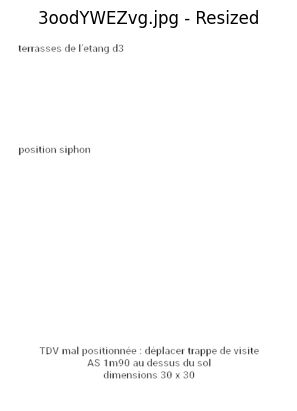

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang d3', 'position siphon', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 1m90 au dessus du sol', 'dimensions 30 x 30'] <===
Duration: 8.2 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang d3
position siphon
TDV mal positionnée
déplacé trappe de visite
AS 1,90 m au-dessus du sol
dimensions 30 x 30 <===

Processing file: 9dz74zt3QG.jpg


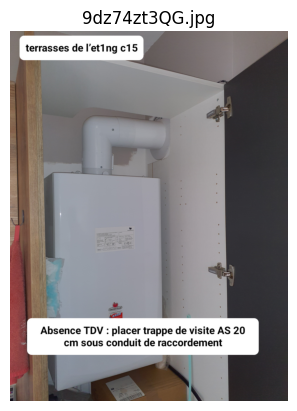

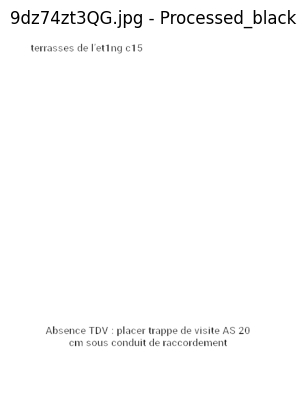

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


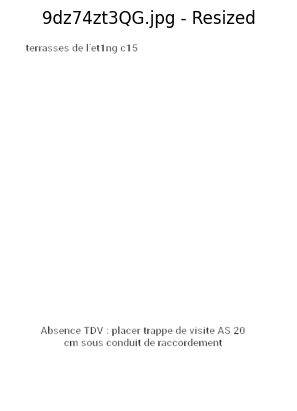

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etIng c15", 'Absence TDV', 'placer trappe de visite AS 20', 'cm sous conduit de raccordement'] <===
Duration: 7.9 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'Etting c15
Absence TDV
placer trappe de visite AS 20
cm sous-conduit de raccordement <===

Processing file: 9nf94Ti8WN.jpg


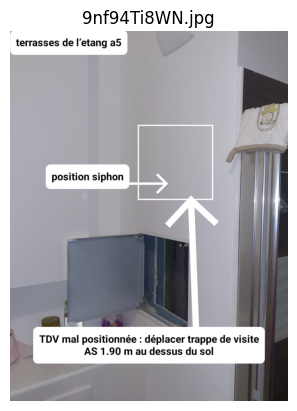

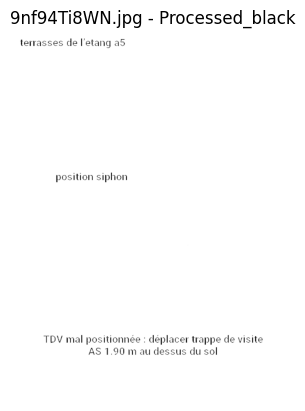

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


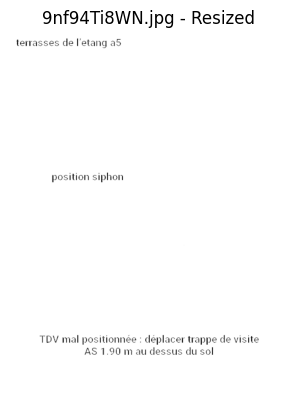

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang a5", 'position siphon', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 190 m au dessus du sol'] <===
Duration: 8.2 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a5
position siphon
TDV mal positionnée
déplacé trappe de visite
AS 190 m au-dessus du sol <===

Processing file: aMpLhOKQjw.jpg


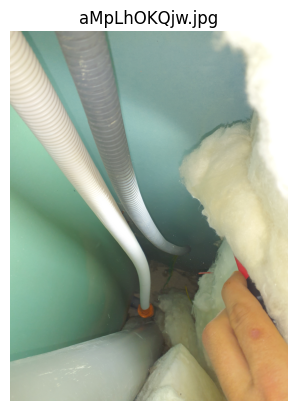

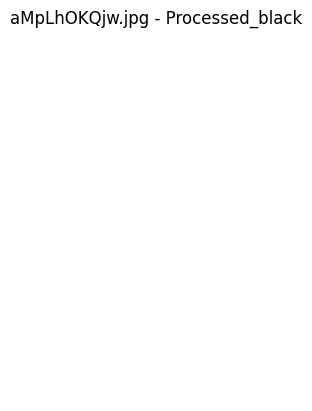

Initial image size :  (4128, 3096, 3)
resized image size :  (1032, 774, 3)


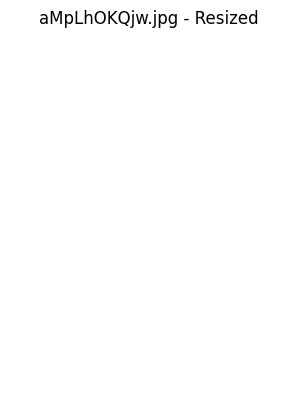

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 7.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: arY5QObBaH.jpg


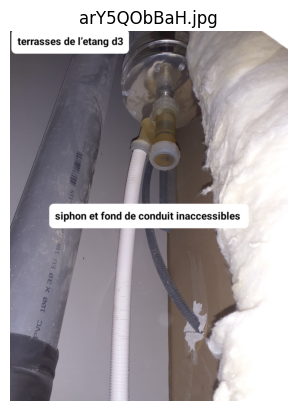

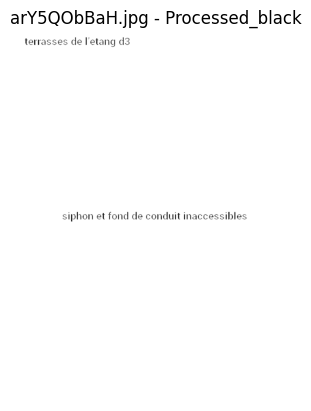

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


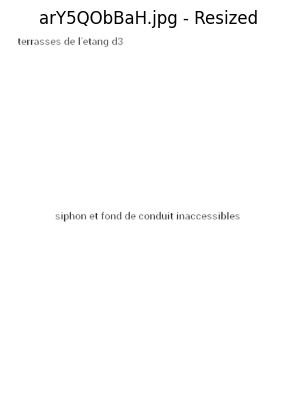

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang d3', 'siphon et fond de conduit inaccessibles'] <===
Duration: 7.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang d3
siphon et fond de conduit inaccessibles <===

Processing file: bHVNH7n2kb.jpg


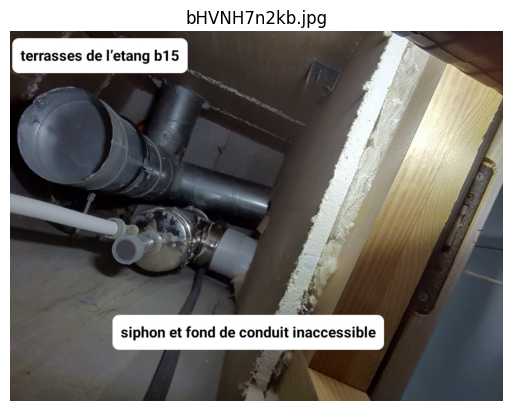

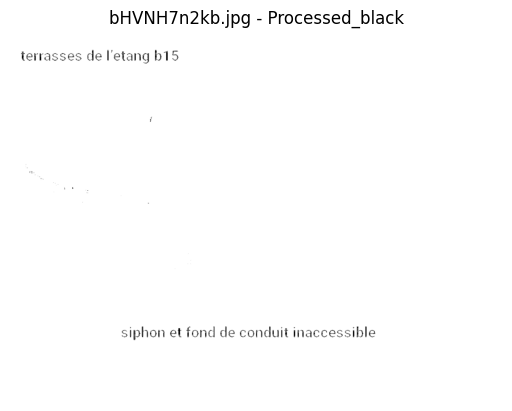

Initial image size :  (1932, 2576, 3)
resized image size :  (483, 644, 3)


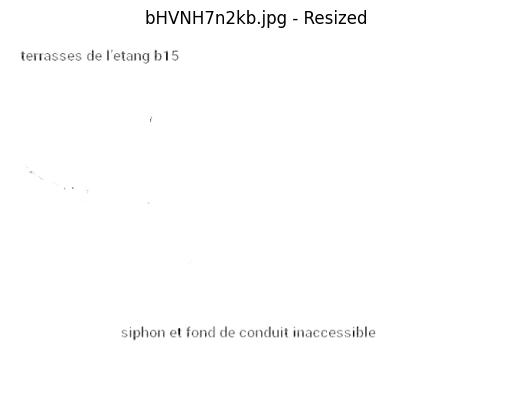

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang b15', 'siphon et fond de conduit inaccessible'] <===
Duration: 5.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang b15
siphon et fond de conduit inaccessible <===

Processing file: bLcGB5xchC.jpg


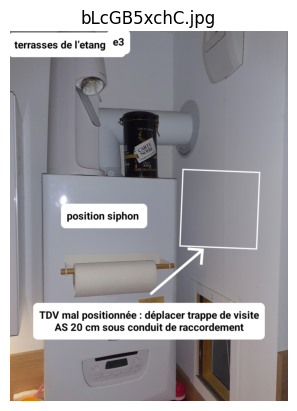

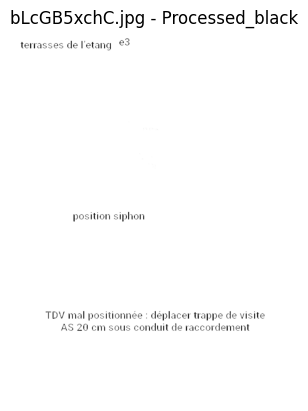

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


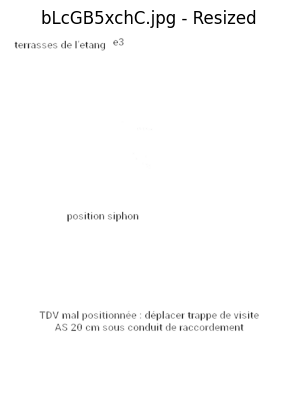

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang', 'e3', 'position siphon', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 20 cm sous conduit de raccordement'] <===
Duration: 8.1 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang
e3
position siphon
TDV mal positionnée
déplacé trappe de visite
AS 20 cm sous-conduit de raccordement <===

Processing file: bvihlOAxjR.jpg


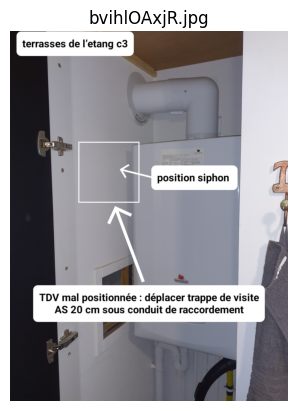

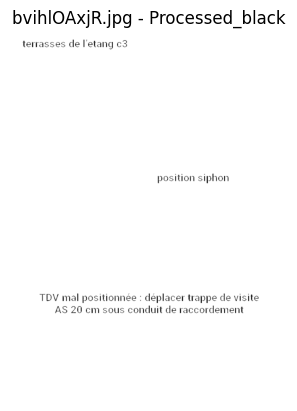

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


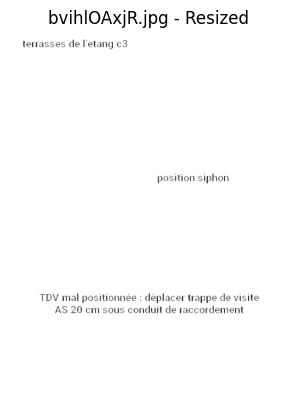

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang c3', 'position siphon', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 20 cm sous conduit de raccordement'] <===
Duration: 9.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang c3
position siphon
TDV mal positionnée
déplacé trappe de visite
AS 20 cm sous-conduit de raccordement <===

Processing file: C3Nz9hRkad.jpg


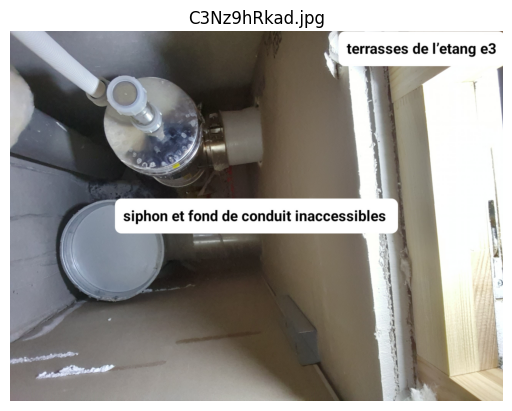

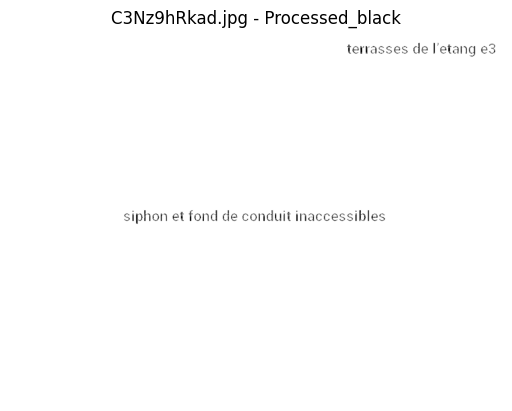

Initial image size :  (1932, 2576, 3)
resized image size :  (483, 644, 3)


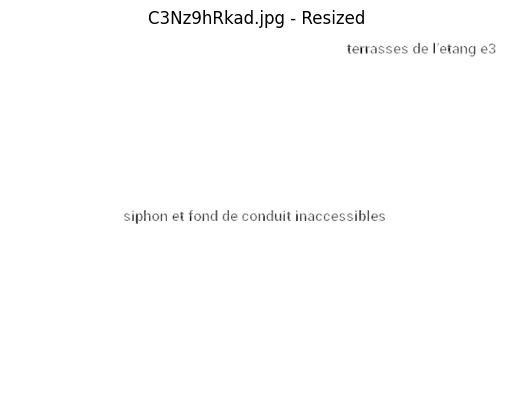

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terasses de letang e3', 'siphon et fond de conduit inaccessibles'] <===
Duration: 5.9 seconds

---------------------------------------------------------------------------

Cleaned text:
===> T'errasses de l'étang e3
siphon et fond de conduit inaccessibles <===

Processing file: cPeXlTkO6u.jpg


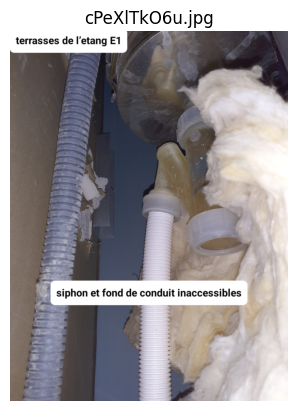

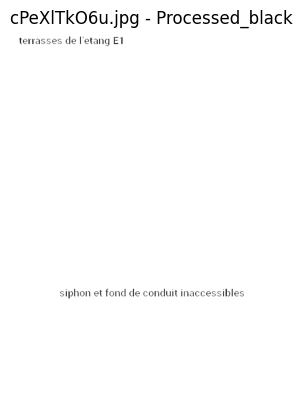

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


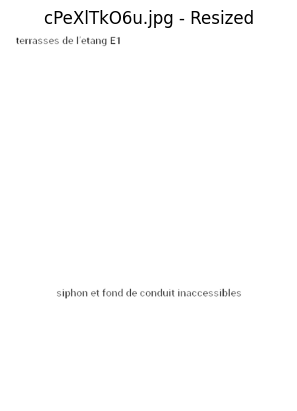

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang E1', 'siphon et fond de conduit inaccessibles'] <===
Duration: 9.0 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang E1
siphon et fond de conduit inaccessibles <===

Processing file: FCf52T0jyg.jpg


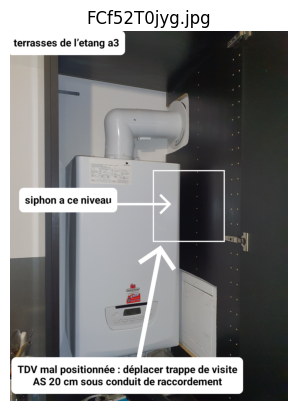

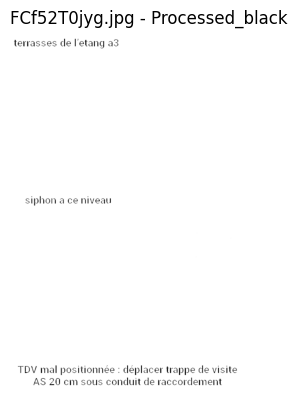

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


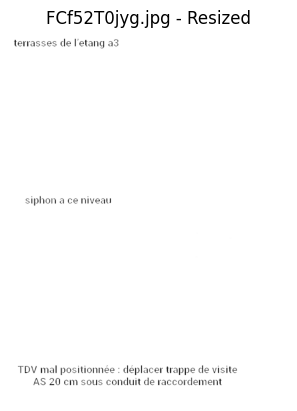

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang a3", 'siphon a ce niveau', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 20 cm sous conduit de raccordement'] <===
Duration: 9.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a3
siphon à ce niveau
TDV mal positionné
déplacé trappe de visite
AS 20 cm sous-conduit de raccordement <===

Processing file: FhHRyV1WdI.jpg


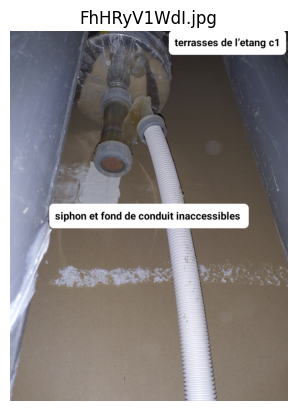

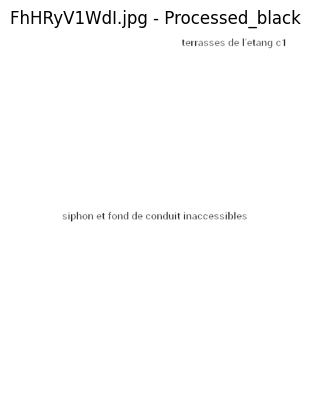

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


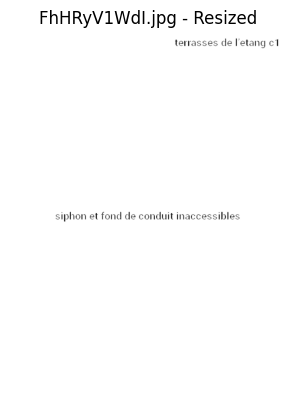

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang c1', 'siphon et fond de conduit inaccessibles'] <===
Duration: 9.2 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang c1
siphon et fond de conduit inaccessibles <===

Processing file: fS4QVmJMgU.jpg


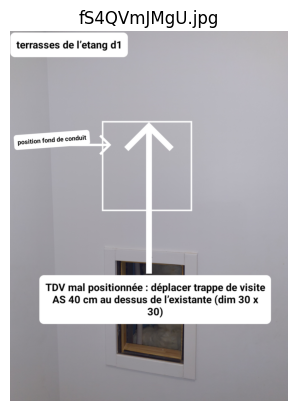

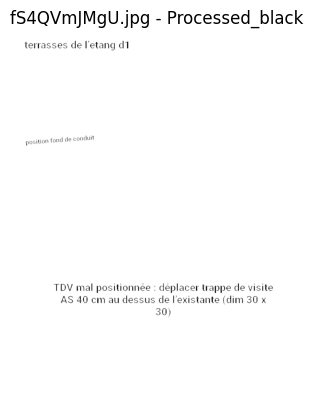

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


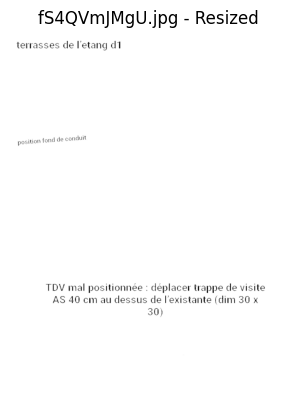

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang d1', 'fond de conduit', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 40 cm au dessus de lexistante adin 30 x', '309', 'position'] <===
Duration: 9.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang d1
fond de conduit
TDV mal positionné
déplacé trappe de visite
AS 40 cm au-dessus de l'existante afin 30 x
309
positions <===

Processing file: Gz2HjRkmWy.jpg


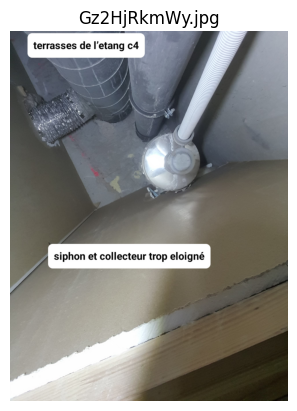

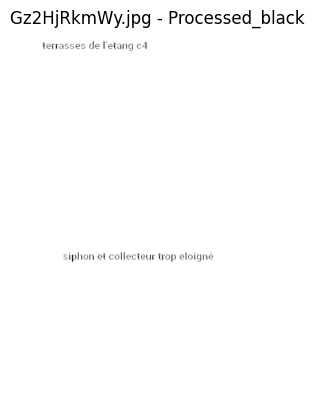

Initial image size :  (2576, 1932, 3)
resized image size :  (644, 483, 3)


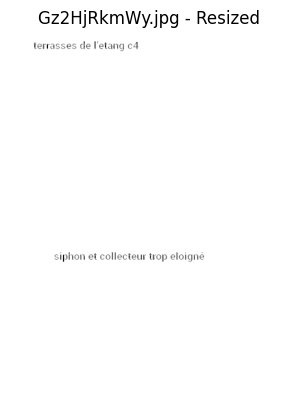

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang c4', 'siphon et collecteur trop eloigné'] <===
Duration: 6.1 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang c4
siphon et collecteur trop éloigné <===

Processing file: hkR4JWI2aS.jpg


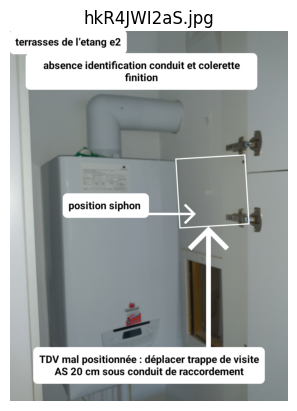

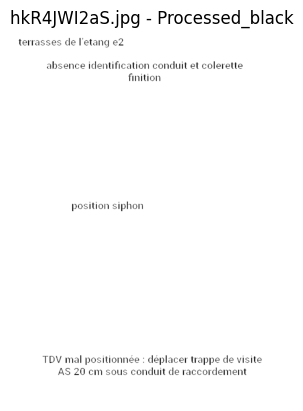

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


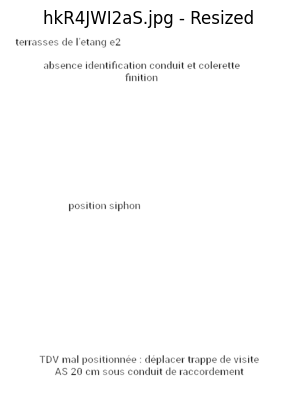

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang e2", 'absence identification conduit et colerette', 'finition', 'position siphon', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 20 cm sous conduit de raccordement'] <===
Duration: 10.0 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang e2
absence identification conduit et collerette
finition
position siphon
TDV mal positionné
déplacé trappe de visite
AS 20 cm sous-conduit de raccordement <===

Processing file: hn3xHSNzBC.jpg


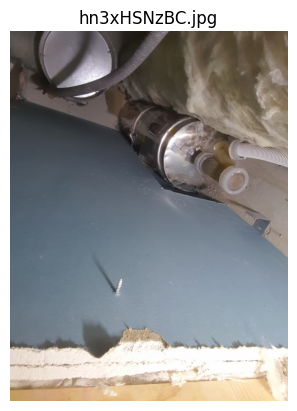

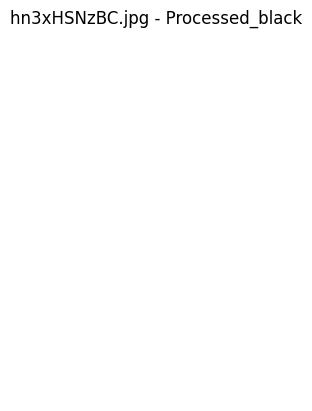

Initial image size :  (2576, 1932, 3)
resized image size :  (644, 483, 3)


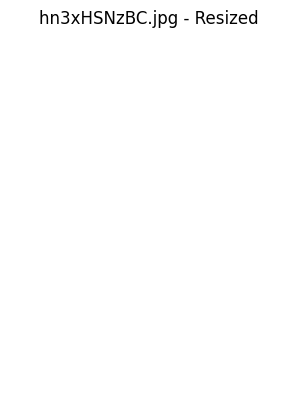

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> [] <===
Duration: 5.9 seconds

---------------------------------------------------------------------------

Cleaned text:
===>  <===

Processing file: JfMjUJPQdG.jpg


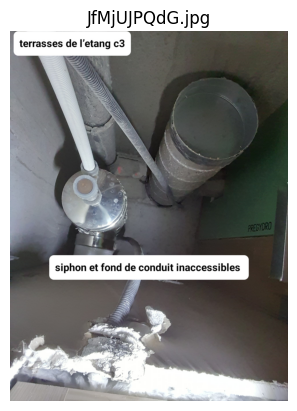

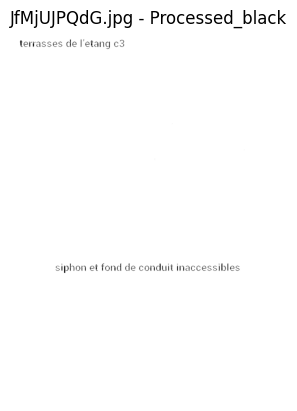

Initial image size :  (2576, 1932, 3)
resized image size :  (644, 483, 3)


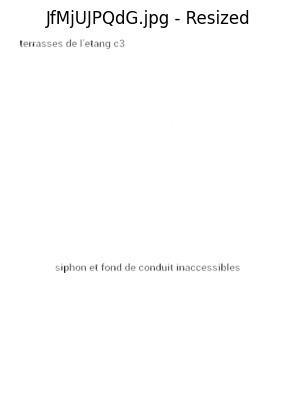

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['lerrasses de letang c3', 'siphon et fond de conduit inaccessibles'] <===
Duration: 6.1 seconds

---------------------------------------------------------------------------

Cleaned text:
===> L'errasses de l'étang c3
siphon et fond de conduit inaccessibles <===

Processing file: KaapSm8AgH.jpg


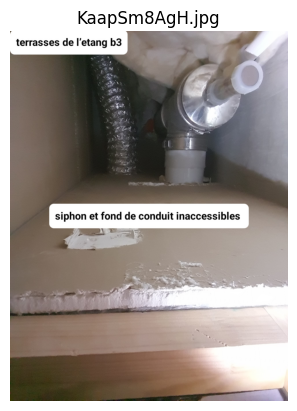

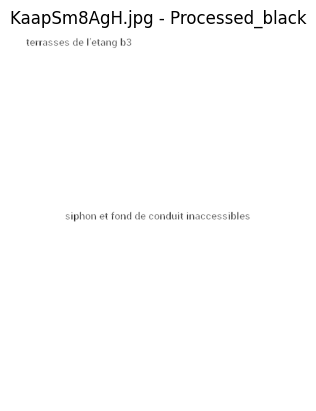

Initial image size :  (2576, 1932, 3)
resized image size :  (644, 483, 3)


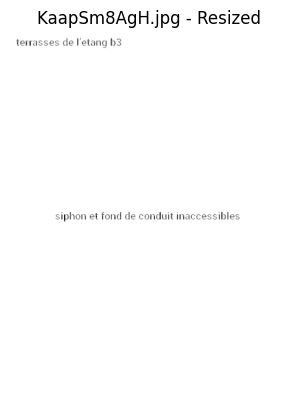

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang b3', 'siphon et fond de conduit inaccessibles'] <===
Duration: 6.1 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang b3
siphon et fond de conduit inaccessibles <===

Processing file: lsrfxLDa80.jpg


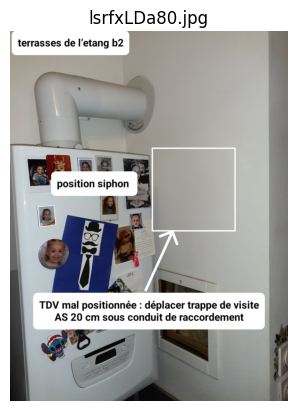

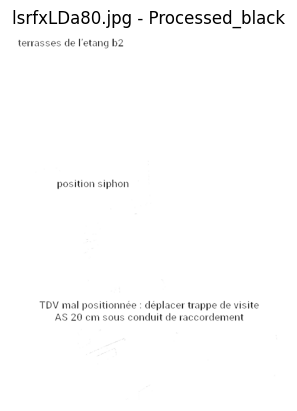

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


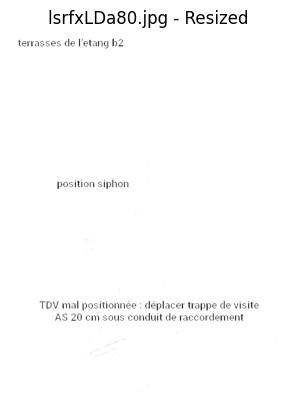

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang b2", 'position siphon', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 20 cm sous conduit de raccordement'] <===
Duration: 9.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang b2
position siphon
TDV mal positionnée
déplacé trappe de visite
AS 20 cm sous-conduit de raccordement <===

Processing file: MO8SchduPz.jpg


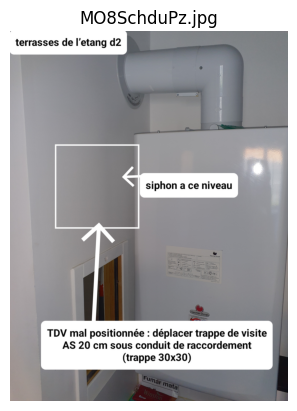

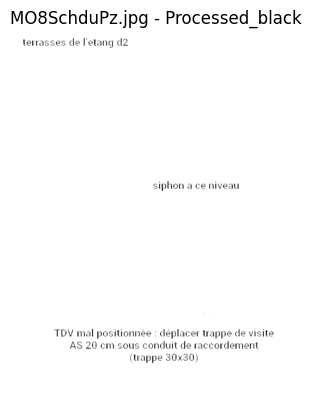

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


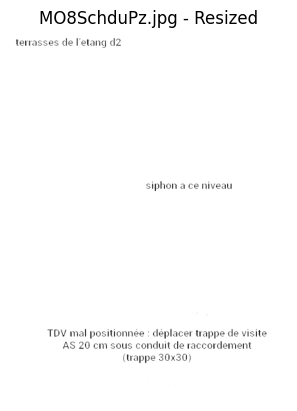

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang d2", 'siphon a ce niveau', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 20 cm sous conduit de raccordement', 'Gtrappe 30x309'] <===
Duration: 9.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang d2
siphon à ce niveau
TDV mal positionné
déplacé trappe de visite
AS 20 cm sous-conduit de raccordement
Grappe 30x309 <===

Processing file: mXw39rULe0.jpg


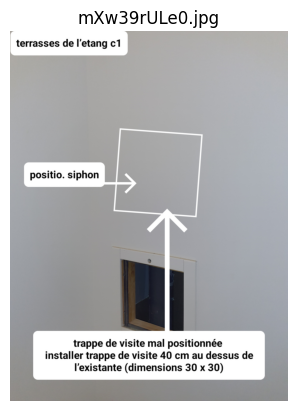

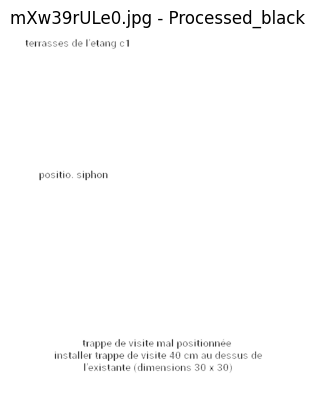

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


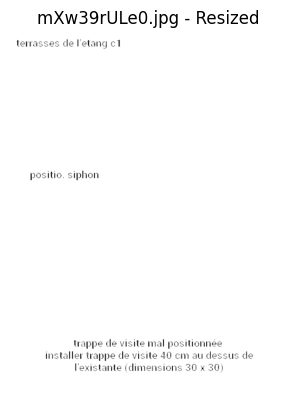

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de lelang c1', 'positio siphon', 'trappe de visite mal positionnée', 'installer trappe de visile 40 cm au dessus de', 'lexistanle édimensions 30 x 309'] <===
Duration: 9.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'élan c1
position siphon
trappe de visite mal positionnée
installé trappe de vise-le 40 cm au-dessus de
l'existante dimensions 30 x 309 <===

Processing file: mza7I5ZWOA.jpg


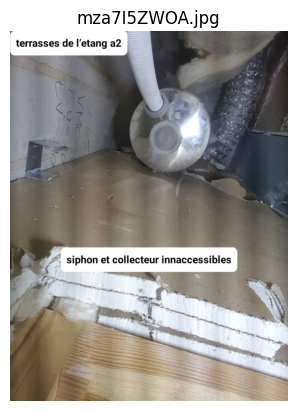

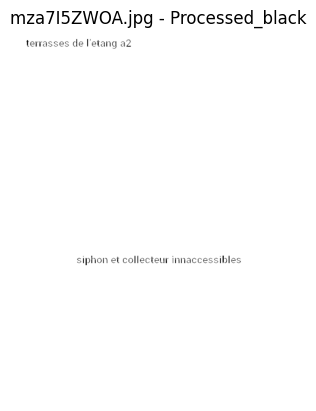

Initial image size :  (2576, 1932, 3)
resized image size :  (644, 483, 3)


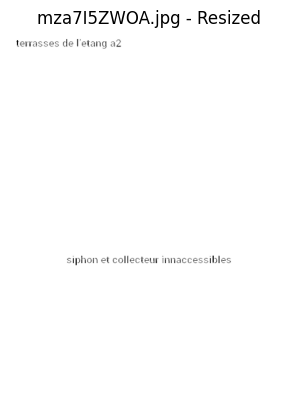

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de Fetang a2', 'siphon et collecteur innaccessihles'] <===
Duration: 6.1 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de Étang a2
siphon et collecteur inaccessibles <===

Processing file: N4oQnHm3cn.jpg


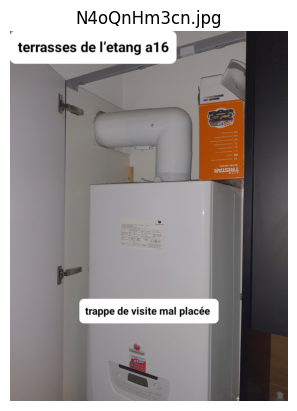

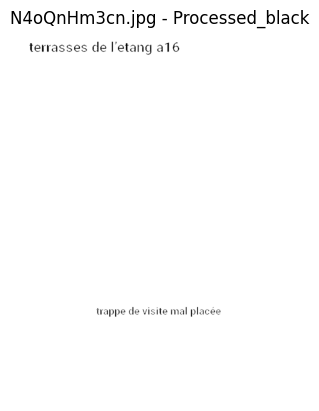

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


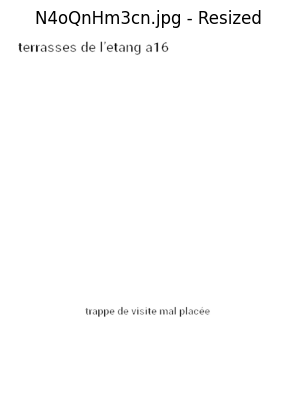

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang a16", 'trappe de visite mal placée'] <===
Duration: 9.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a16
trappe de visite mal placée <===

Processing file: nFokyG7P4k.jpg


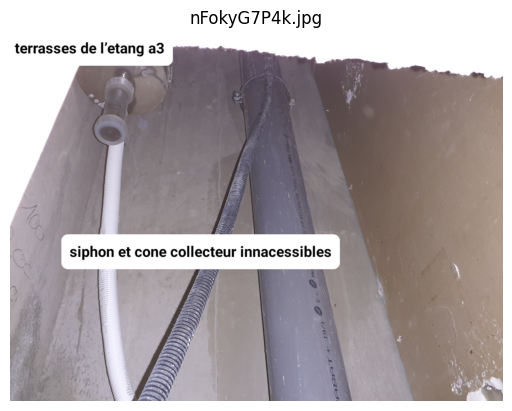

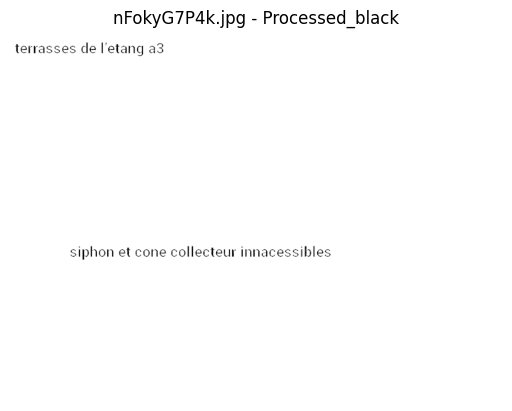

Initial image size :  (3072, 4096, 3)
resized image size :  (768, 1024, 3)


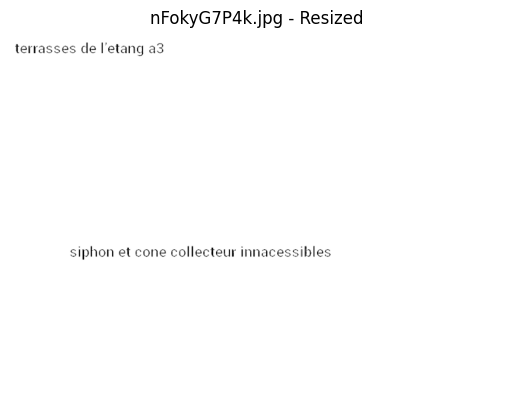

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang a3', 'siphon et cone collecteur innacessibles'] <===
Duration: 9.1 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a3
siphon et cône collecteur inaccessibles <===

Processing file: O5WxGastvP.jpg


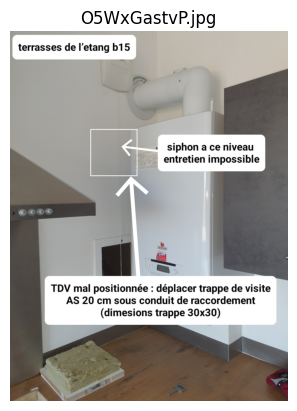

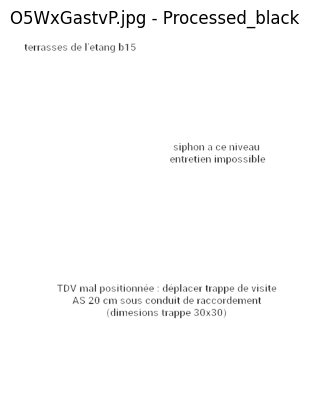

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


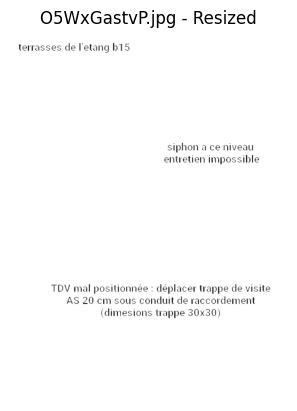

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang b15', 'siphon', 'a ce niveau', 'entretien impossible', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 20 cm sous conduit de raccordement', 'Gdimesions trappe 30x309'] <===
Duration: 9.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang b15
siphon
à ce niveau
entretien impossible
TDV mal positionnée
déplacé trappe de visite
AS 20 cm sous-conduit de raccordement
Dimensions trappe 30x309 <===

Processing file: pe991k8qAc.jpg


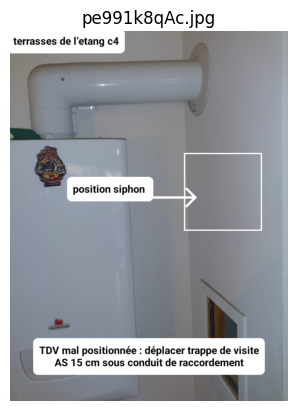

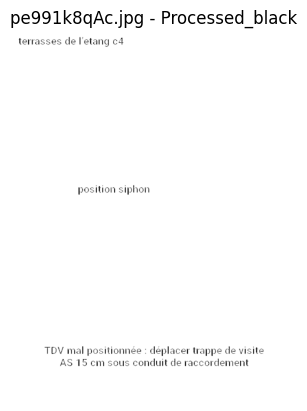

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


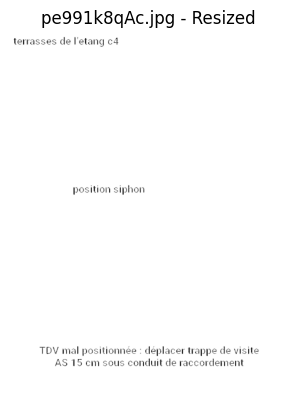

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang c4", 'position siphon', 'TDV mal positionnée w déplacer trappe de visite', 'AS 15 cm sous conduit de raccordement'] <===
Duration: 9.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang c4
position siphon
TDV mal positionnée w déplacé trappe de visite
AS 15 cm sous-conduit de raccordement <===

Processing file: pfdxfsjZHp.jpg


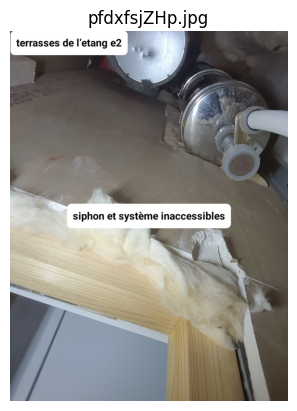

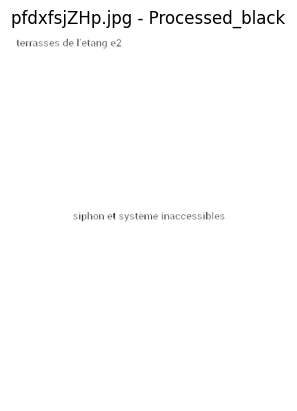

Initial image size :  (2576, 1932, 3)
resized image size :  (644, 483, 3)


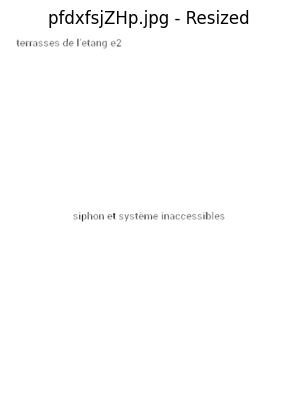

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang e2', 'siphon et systeme inaccessibles'] <===
Duration: 6.0 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang e2
siphon et système inaccessibles <===

Processing file: RH1swPEn8A.jpg


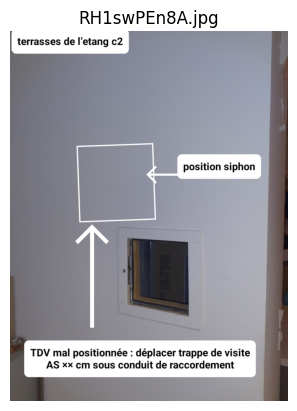

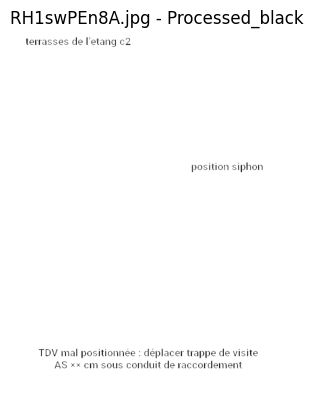

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


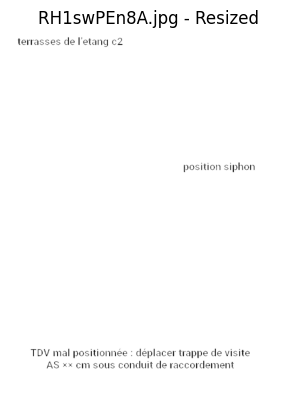

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang c2", 'position siphon', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS xx cm sous conduit de raccordement'] <===
Duration: 9.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang c2
position siphon
TDV mal positionnée
déplacé trappe de visite
AS ex cm sous-conduit de raccordement <===

Processing file: TEivzoSk4k.jpg


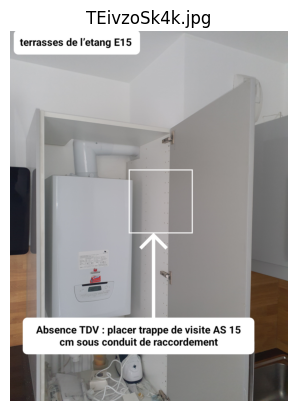

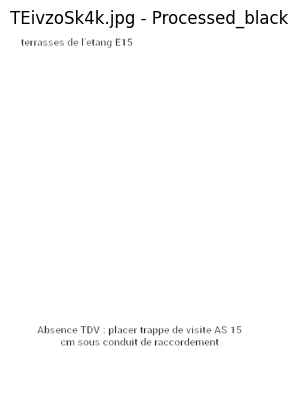

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


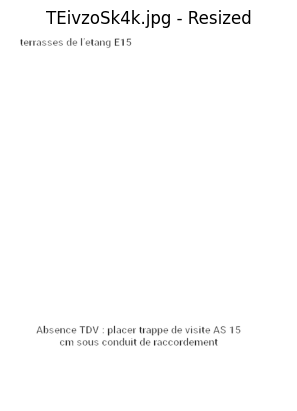

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang E15", 'Absence TDV', 'placer trappe de visite AS 15', 'cn sous conduit de raccordement'] <===
Duration: 9.3 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang E15
Absence TDV
placer trappe de visite AS 15
cN sous conduit de raccordement <===

Processing file: UHvDzWlPIN.jpg


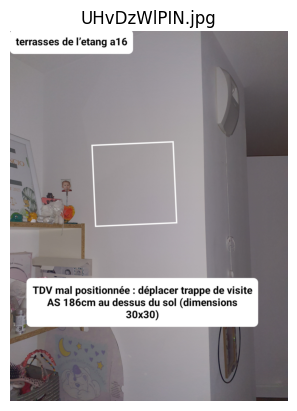

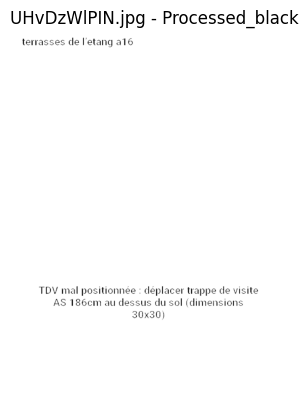

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


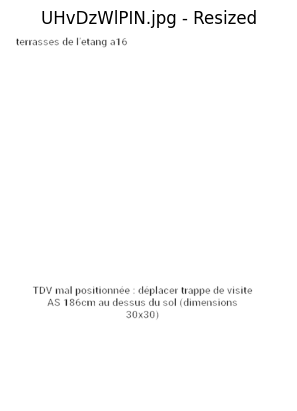

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang a16', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 186cm au dessus du sol adimensions', '30x30'] <===
Duration: 9.4 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a16
TDV mal positionnées
déplacé trappe de visite
AS 186 cm au-dessus du sol a dimensions
30x30 <===

Processing file: uV1UBpe3ln.jpg


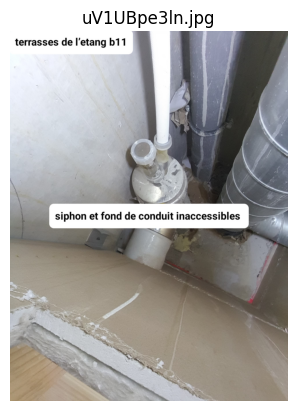

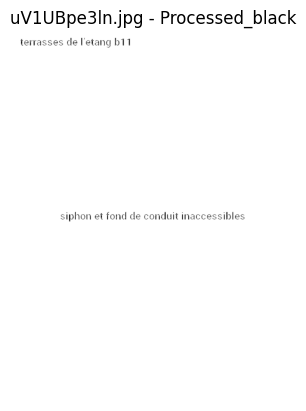

Initial image size :  (2576, 1932, 3)
resized image size :  (644, 483, 3)


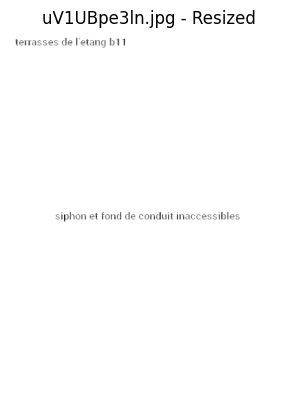

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang b11', 'siphon et fond de conduit inaccessibles'] <===
Duration: 6.1 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang b11
siphon et fond de conduit inaccessibles <===

Processing file: WEK8kZ0heV.jpg


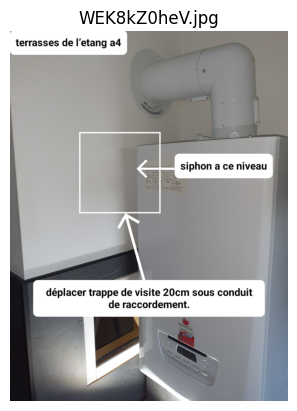

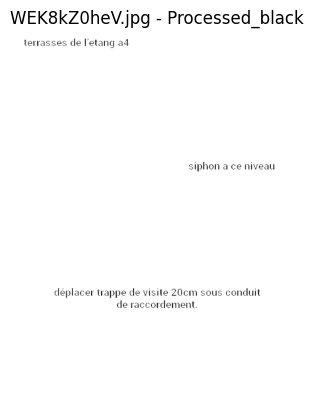

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


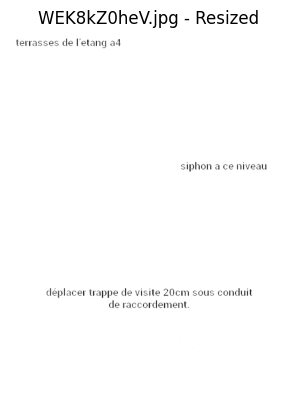

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang a4', 'siphon a ce niveau', 'déplacer trappe de visite 20cm sous conduit', 'de raccordement'] <===
Duration: 9.4 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a4
siphon à ce niveau
déplacé trappe de visite 20 cm sous conduit
de raccordement <===

Processing file: wNrdJqTqX1.jpg


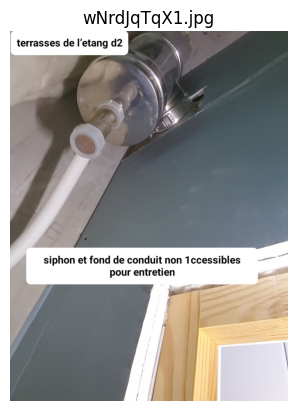

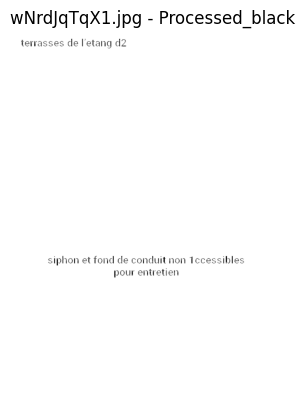

Initial image size :  (2576, 1932, 3)
resized image size :  (644, 483, 3)


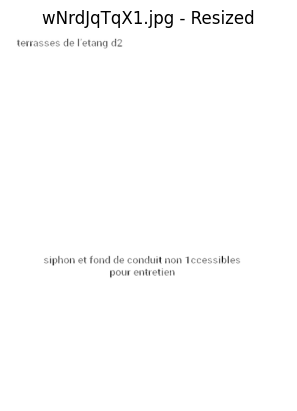

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang d2', 'siphon et fond de conduit non Iccessibles', 'pour eniretlen'] <===
Duration: 6.2 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang d2
siphon et fond de conduit non Accessibles
pour entretien <===

Processing file: wreTSoFrEg.jpg


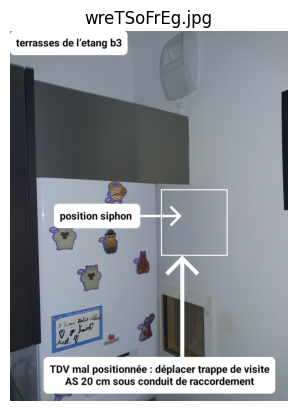

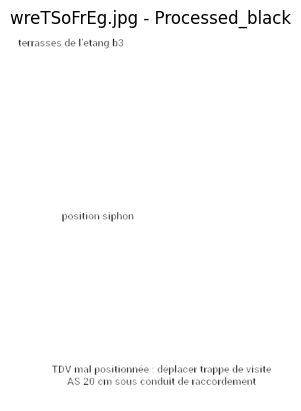

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


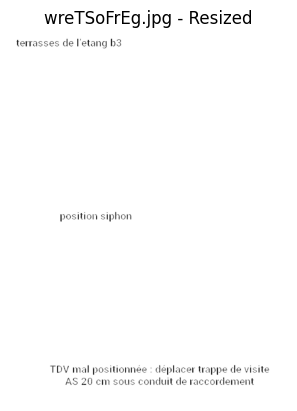

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang b3', 'position siphon', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 20 cm sous conduit de raccorcement'] <===
Duration: 9.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang b3
position siphon
TDV mal positionnée
déplacé trappe de visite
AS 20 cm sous-conduit de raccordement <===

Processing file: X7H5x3vQBL.jpg


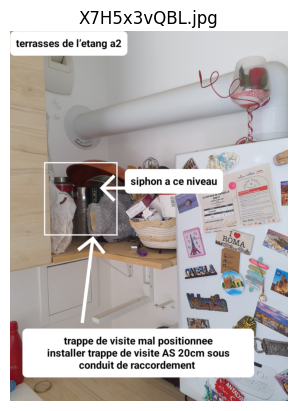

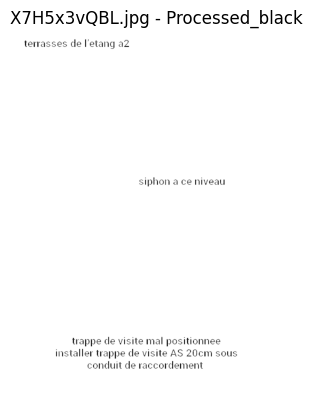

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


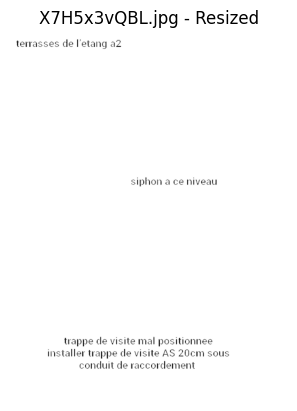

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang a2", 'siphon a ce niveau', 'trappe de visite mal positionnee', 'installer trappe de visite AS 2Ocm sous', 'conduit de raccordement'] <===
Duration: 9.6 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a2
siphon à ce niveau
trappe de visite mal positionnée
installer trappe de visite AS 2 Cm sous
conduit de raccordement <===

Processing file: xcAehHRSGI.jpg


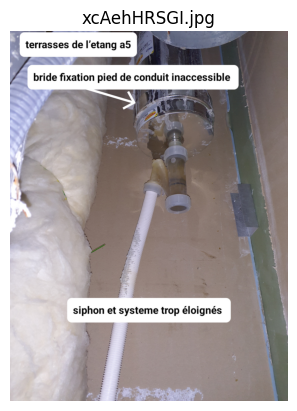

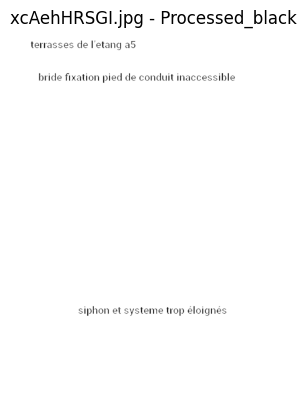

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


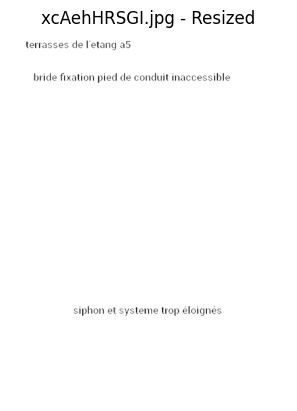

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang a5', 'bride fixation pied de conduit inaccessible', 'siphon et systeme trop éloignés'] <===
Duration: 9.2 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a5
bride fixation pied de conduit inaccessible
siphon et système trop éloignés <===

Processing file: xFvzPLuNPf.jpg


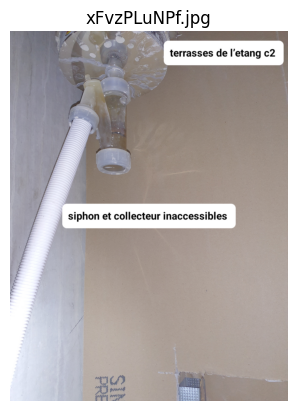

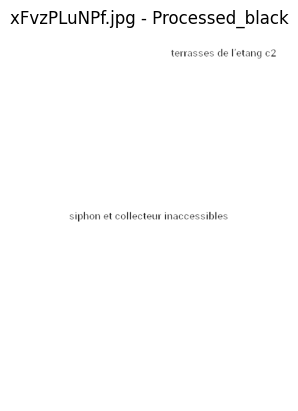

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


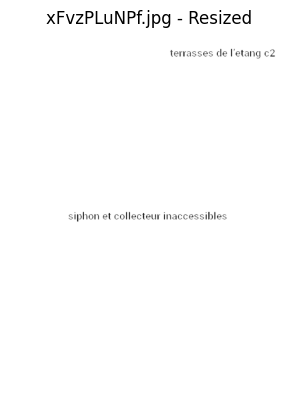

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang c2", 'siphon et collecteur inaccessibles'] <===
Duration: 9.1 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang c2
siphon et collecteur inaccessibles <===

Processing file: xNIiJl1MvZ.jpg


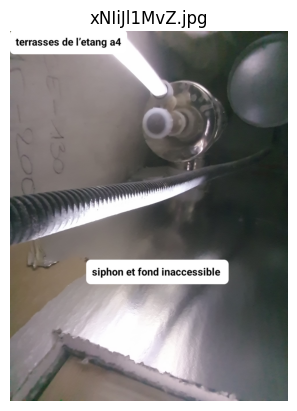

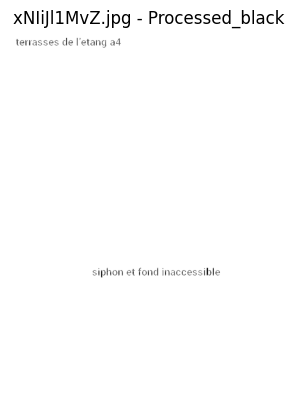

Initial image size :  (2576, 1932, 3)
resized image size :  (644, 483, 3)


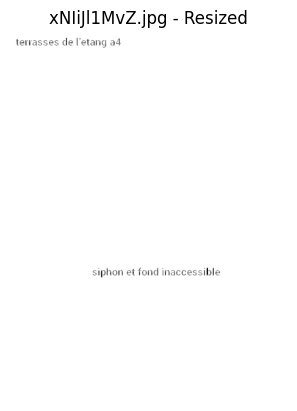

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang a4", 'siphon et fond inaccessible'] <===
Duration: 6.0 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang a4
siphon et fond inaccessible <===

Processing file: Ynf1JE1xcR.jpg


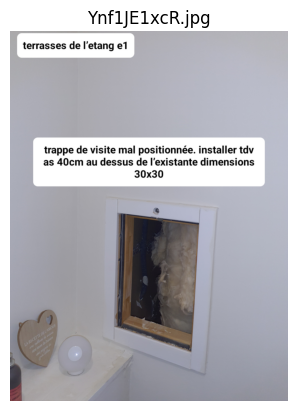

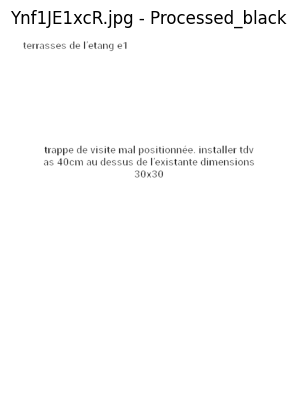

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


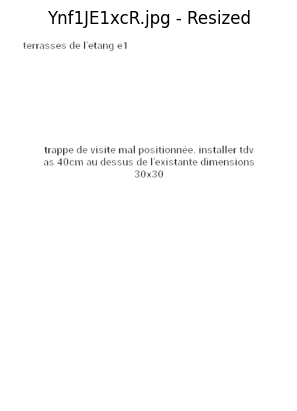

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ['terrasses de letang e1', 'trappe de visite mal positionnée  installer tdv', 'as 40cm au dessus de lexistante dimensions', '30x30'] <===
Duration: 9.7 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang e1
trappe de visite mal positionnée installé TV
as 40 cm au-dessus de l'existante dimensions
30x30 <===

Processing file: zVOgPKzJDM.jpg


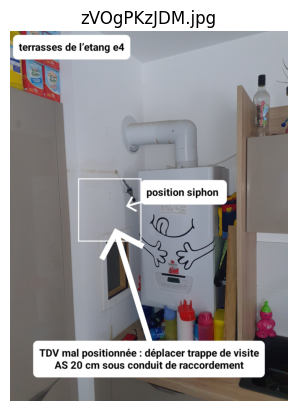

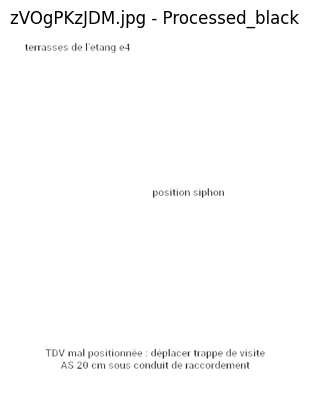

Initial image size :  (4096, 3072, 3)
resized image size :  (1024, 768, 3)


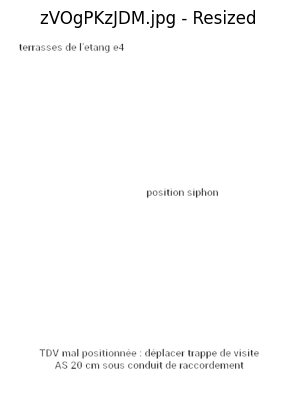

Using CPU. Note: This module is much faster with a GPU.



Extracted text:
===> ["terrasses de l'etang e4", 'position siphon', 'TDV mal positionnée', 'déplacer trappe de visite', 'AS 20 cm sous conduit de raccordement'] <===
Duration: 9.5 seconds

---------------------------------------------------------------------------

Cleaned text:
===> Terrasses de l'étang e4
position siphon
TDV mal positionnée
déplacé trappe de visite
AS 20 cm sous-conduit de raccordement <===

Dictionnaire exporté dans le fichier : c:\Users\pierr\VSC_Projects\Rpur\data\dev\output_notebook\3-text_extracted_with_better_preprocessing.json
{
    "0 - Terminaux": {
        "0PPuOlDZAJ.jpg": "Terrasses de l'étang a16",
        "41oMSUSbGA.jpg": "Terrasses de l'étang a5",
        "5HetHm7AoW.jpg": "Terrasses de l'étang\ne3\ne4",
        "5Oga9fOxP9.jpg": "Terrasses de Étang a3\nchapeau repositionné",
        "7nQCCKviVo.jpg": "Terrasses de l'étang e15\nterminal non compatible système\nDANGER\n3 cep bouboulât Il s'agit d'une\nventouse individuelle\nabsence collerette étanchéi

In [49]:
# output filename
output_file_name="3-text_extracted_with_better_preprocessing.json"

# text extracted output path
text_extracted_path = os.path.join(output_dir, output_file_name)

# Check if the output file exists, if not create it
if not os.path.exists(text_extracted_path):
    text_extracted = {}

    # Extract text from the first X files in each subdirectory
    for subdir, files in files_by_subdir.items():
        print("\n", "*" * 75)
        print(f"\nSUBDIRECTORY: {subdir}")
        text_extracted[subdir] = {}

        # Skip the ignored folder with empty text
        if subdir == folder_ignored_dir:
            print("===>>> Folder ignored <<<===")
            # for file in files[:number_of_files]:
            for file in files[:]:
                text_extracted[subdir][file] = ""

        else:
            # All files in subdirectory
            for file in files[:]:
            # for file in files[:number_of_files]:

                # Get the image path
                image_path = os.path.join(data_dir, subdir, file)
                print(f"\nProcessing file: {file}")

                # display initial image
                image_cv2 = cv2.imread(image_path)
                display_image(image_cv2, title=file)

                # Process the image
                image_processed_path = os.path.join(
                    temp_dir,
                    "image_processed.jpg"
                )
                image_processed = preprocess_black_text(
                    image_path, image_processed_path
                )
                display_image(image_processed, title=f"{file} - Processed_black")

                # Resize the image
                image_resized_path = os.path.join(temp_dir, "image.jpg")
                image_resized = resize_image(
                    image_processed_path,
                    image_resized_path,
                    scale_percent=best_params["scale_percent"]
                )
                display_image(image_resized, title=f"{file} - Resized")

                # Extract text
                text, duration = extract_text_easyocr(
                    image_resized_path,
                    batch_size=best_params["batch_size"],
                    decoder=best_params["decoder"],
                    adjust_contrast=best_params["adjust_contrast"],
                    worker=best_params["worker"]
                )

                # Clean the french text
                text = correct_text_french(text)
                print("\nCleaned text:\n===>", text, '<===')

                # Save the text in the dictionary
                text_extracted[subdir][file] = text

    # Export JSON
    export_text_to_json(
    text_extracted,
    output_dir,
    output_file=output_file_name
    )

    # Print the JSON content with color
    print_json_with_color(text_extracted)
else:
    # Importation du fichier JSON
    text_extracted = import_json_to_text(
        output_dir,
        input_file=output_file_name
    )
    # Print the JSON content with color
    print_json_with_color(text_extracted)

# <span style='background:blue'>IV. Création du dossier de sortie</span>

Le texte extrait de l'image est soumise à un traitement préalable pour pouvoir l'utiliser pour la création du nom de fichier : 
1. Nettoyage du texte extrait
   1. Suppression des saut de ligne, des retours chariots
   2. Conservation uniquement des lettres, chiffres, apostrophes et tirets
   3. Suppression des espaces multiples
   4. Uniformisation de la casse (minuscule)

2. Extraction des informations clefs du texte extrait
   1. Extraction du nom de la cheminée (=pattern de format lettre+chiffre)
   2. Extraction des remarques (après le pattern)

3. Génération du nom de fichier : 1_2_3_4.5
   1. = Acronyme du nom du client (input utilisateur)
   2. = Nom de la cheminée
   3. = Ajout d'un compteur (en cas de doublons)
   4. = extension de l'image d'origine (jpeg)

4. Sauvegarde du mapping des noms de fichiers dans un fichier JSON
   1. Détermination des chemins (input et output)
   2. Copie de l'image dans le dossier output
   3. Ajout de l'information dans le dictionnaire de mapping
   4. Sauvegarde du dictionnaire dans un fichier JSON

In [52]:
# Convert date_mesure to datetime object
date_obj = datetime.datetime.strptime(date_mesure, "%d/%m/%Y")

# Pattern to search for ("a(1)", etc.), exclude if unit of measurement follows
pattern = (
    r"([a-zA-Z]+)(\d+)"
    r"(?!\s*("
    r"cm|mm|dm|km|hm|µm|nm|pm|in|ft|yd|mi|kg|mg|ml|cl|dl|hl|"
    r"ms|µs|ns|ps|min|°c|°f|pa|kpa|mpa|bar|mb|db|mv|kv|ma|ka|"
    r"kw|mw|gw|hz|khz|mhz|ghz|kb|mb|gb|tb|pb|go|ko|mo"
    r")\b)"
)

# Copy files with mapping
key_info_file, mapping_file = copy_files_with_mapping(
    text_extracted,
    pattern,
    data_dir,
    output_dir,
    client_acronym
)


SUBDIRECTORY: 0 - Terminaux
***************************************************************************
Copied: 0PPuOlDZAJ.jpg -> tde_a16.jpg
Copied: 41oMSUSbGA.jpg -> tde_a5.jpg
Copied: 5HetHm7AoW.jpg -> tde_e3.jpg
Copied: 5HetHm7AoW.jpg -> tde_e4.jpg
Copied: 5Oga9fOxP9.jpg -> tde_a3.jpg
Copied: 7nQCCKviVo.jpg -> tde_e15.jpg
Copied: 8rI24qcHDh.jpg -> tde_a16.jpg
Copied: 9dy6VgxYib.jpg -> tde_d1.jpg
Copied: DI5O6aFlP4.jpg -> tde_a3.jpg
Copied: ew4w7UQQwI.jpg -> tde_c2.jpg
Copied: hub54SpeR0.jpg -> tde_e2.jpg
Copied: iAI90PnInn.jpg -> tde_b2.jpg
Copied: joooDm6JXy.jpg -> tde_c1.jpg
Copied: kDbAc2JIYg.jpg -> tde_a16.jpg
Copied: kstzlsM2py.jpg -> tde_b15.jpg
Copied: lzczdAYXYJ.jpg -> tde_d2.jpg
Copied: mRANJb56sh.jpg -> tde_b11.jpg
Copied: NzsDncFH2i.jpg -> tde_c4.jpg
Copied: Ozhw3XhuDl.jpg -> tde_a3.jpg
Copied: Ozhw3XhuDl.jpg -> tde_a4.jpg
Copied: rAj0zEkO9Q.jpg -> tde_a2.jpg
Copied: SgKs1wkDDo.jpg -> tde_c15.jpg
Copied: t181U9xgKf.jpg -> tde_c3.jpg
Copied: tRzXfkqDDx.jpg -> tde_b3.jpg


Nous vérifions le dictionnaire des infos clefs pour vérifier que tout s'est bien passé.

In [53]:
# Importation JSON file
key_info_dict = import_json_to_text(
    output_dir,
    input_file=key_info_file
)
# Print the JSON content with color
print_json_with_color(key_info_dict)

Dictionnaire importé depuis le fichier : c:\Users\pierr\VSC_Projects\Rpur\data\dev\output_notebook\key_info.json
{
    "0 - Terminaux": {
        "0PPuOlDZAJ.jpg": {
            "client_name": "terrasses de l'étang",
            "chimney_name": [
                "a16"
            ],
            "remarks": ""
        },
        "41oMSUSbGA.jpg": {
            "client_name": "terrasses de l'étang",
            "chimney_name": [
                "a5"
            ],
            "remarks": ""
        },
        "5HetHm7AoW.jpg": {
            "client_name": "terrasses de l'étang",
            "chimney_name": [
                "e3",
                "e4"
            ],
            "remarks": ""
        },
        "5Oga9fOxP9.jpg": {
            "client_name": "terrasses de étang",
            "chimney_name": [
                "a3"
            ],
            "remarks": "chapeau repositionné"
        },
        "7nQCCKviVo.jpg": {
            "client_name": "terrasses de l'étang",
            "c

Nous vérifions le dictionnaire de mapping pour vérifier que tout s'est bien passé.

In [54]:
# Importation JSON file
mapping_dict = import_json_to_text(
    output_dir,
    input_file=mapping_file
)
# Print the JSON content with color
print_json_with_color(mapping_dict)

Dictionnaire importé depuis le fichier : c:\Users\pierr\VSC_Projects\Rpur\data\dev\output_notebook\file_mapping.json
{
    "0 - Terminaux": {
        "0PPuOlDZAJ.jpg": [
            "tde_a16.jpg"
        ],
        "41oMSUSbGA.jpg": [
            "tde_a5.jpg"
        ],
        "5HetHm7AoW.jpg": [
            "tde_e3.jpg",
            "tde_e4.jpg"
        ],
        "5Oga9fOxP9.jpg": [
            "tde_a3.jpg"
        ],
        "7nQCCKviVo.jpg": [
            "tde_e15.jpg"
        ],
        "8rI24qcHDh.jpg": [
            "tde_a16.jpg"
        ],
        "9dy6VgxYib.jpg": [
            "tde_d1.jpg"
        ],
        "DI5O6aFlP4.jpg": [
            "tde_a3.jpg"
        ],
        "ew4w7UQQwI.jpg": [
            "tde_c2.jpg"
        ],
        "hub54SpeR0.jpg": [
            "tde_e2.jpg"
        ],
        "iAI90PnInn.jpg": [
            "tde_b2.jpg"
        ],
        "joooDm6JXy.jpg": [
            "tde_c1.jpg"
        ],
        "kDbAc2JIYg.jpg": [
            "tde_a16.jpg"
       

# <span style='background:blue'>V. Génération du rapport Word</span>

## <span style='background:green'>1/ Regroupement des images par conduit</span>

Nous regroupons les photos par nom de conduit et nous créons un dossier par conduit.

In [55]:
# group the data by chimney name
data_per_chimney = group_by_chimney_name(key_info_dict, pattern)

# save the data to JSON file
save_to_json(data_per_chimney, output_dir, "data_per_chimney.json")

# Print the JSON content with color
print_json_with_color(data_per_chimney)


Données sauvegardées dans le fichier JSON : c:\Users\pierr\VSC_Projects\Rpur\data\dev\output_notebook\data_per_chimney.json
{
    "No_chimney_1": {
        "2 - Conduits": {
            "file": "2o1i0vP7iR.JPG",
            "client_name": "",
            "remarks": ""
        }
    },
    "No_chimney_10": {
        "2 - Conduits": {
            "file": "DfSTXL5eaa.JPG",
            "client_name": "",
            "remarks": ""
        }
    },
    "No_chimney_11": {
        "2 - Conduits": {
            "file": "FWiaPtr6Ry.JPG",
            "client_name": "",
            "remarks": ""
        }
    },
    "No_chimney_12": {
        "2 - Conduits": {
            "file": "gd1L0eaEBd.JPG",
            "client_name": "",
            "remarks": ""
        }
    },
    "No_chimney_13": {
        "2 - Conduits": {
            "file": "gu4LHv4Fbc.JPG",
            "client_name": "",
            "remarks": ""
        }
    },
    "No_chimney_14": {
        "2 - Conduits": {
            "file": 

Nous comptons le nombre d'occurences de chaque nom de client détecté.

In [56]:
# Print all client names
client_names = get_client_name_counts(key_info_dict)
print("Noms des clients :")
for client, count in client_names.items():
    print(f"{client}: {count}")

Noms des clients :
terrasses de l'étang: 62
: 30
terrasses de étang: 10
terminal trop proche et trop bas vis-à-vis du mur terrasses de l'étang: 1
terrasses de l'étang terminal à moins de 2m de hauteur différente: 1
de étang: 1
terrasses de l'etting: 1
t'errasses de l'étang: 1
l'errasses de l'étang: 1
terrasses de l'élan: 1


Le nom de client le plus détecté est donc celui-ci : 

In [57]:
# Print the main client name
client_name = max(client_names, key=client_names.get)
client_name

"terrasses de l'étang"

## <span style='background:green'>2/ Création du rapport Word</span>


In [58]:
# Generate word report
generate_word_report(
    data_per_chimney,
    data_dir,
    output_dir,
    temp_dir,
    client_name,
    files_by_subdir,
    logo_path=os.path.join(logo_dir, "logo_rpur.png"),
)

Rapport généré: c:\Users\pierr\VSC_Projects\Rpur\data\dev\output_notebook\rapport_extraction.docx


# <span style='background:blue'>VI. Création de la base de données SQL</span>

## <span style='background:green'>1/ Création des tables</span>

Nous créons une base de données SQLite pour stocker les informations extraites des images.

In [59]:
bdd_path = create_database_and_tables(bdd_dir)

Base de données créée : c:\Users\pierr\VSC_Projects\Rpur\bdd\bdd_airpur.db


Nous visionnons le contenu des tables pour vérifier que tout s'est bien passé. Elle est composée de 3 tables :
- *clients* : contient les informations sur les clients
- *cheminees* : contient les informations sur les cheminées
- *mesures* : contient les informations sur les mesures

In [60]:
display_table_db(bdd_path)

Tables dans la base : ['clients', 'cheminees', 'mesures'] 


Contenu de la table 'clients':


,client_id,nom



Contenu de la table 'cheminees':


,client_id,cheminee_id,localisation,remarques



Contenu de la table 'mesures':


,client_id,cheminee_id,mesure_id,date_mesure


## <span style='background:green'>2/ Remplissage table "client"</span>

Nous ajoutons des données dans la table "clients"

In [61]:
insert_client_into_db(bdd_path, client_acronym, client_name)

Client 'terrasses de l'étang' inséré avec succès dans la base de données.


Nous visionnons le contenu de la table "clients" pour vérifier que tout s'est bien passé.

In [62]:
display_table_db(bdd_path, table_name="clients")

Tables dans la base : ['clients', 'cheminees', 'mesures'] 


Contenu de la table 'clients':


,client_id,nom
0,tde,terrasses de l'étang


## <span style='background:green'>3/ Remplissage table "cheminees"</span>

Nous ajoutons des données dans la table "cheminees"

In [63]:
insert_cheminee_into_db(bdd_path, client_acronym, data_per_chimney)

Nous visionnons le contenu de la table "cheminees" pour vérifier que tout s'est bien passé.

In [64]:
display_table_db(bdd_path, table_name="cheminees")

Tables dans la base : ['clients', 'cheminees', 'mesures'] 


Contenu de la table 'cheminees':


,client_id,cheminee_id,localisation,remarques
0,tde,a2,Terminaux,
1,tde,a2,Logements,siphon à ce niveau trappe de visite mal positi...
2,tde,a3,Terminaux,
3,tde,a3,Logements,siphon et cône collecteur inaccessibles
4,tde,a4,Terminaux,
5,tde,a4,Logements,siphon et fond inaccessible
6,tde,a5,Terminaux,
7,tde,a5,Combles,absence brides serrage 63
8,tde,a5,Logements,bride fixation pied de conduit inaccessible si...
9,tde,a16,Terminaux,joint intérieur terminal remplacé


## <span style='background:green'>4/ Remplissage table "mesures"</span>

Nous ajoutons des données dans la table "mesures"

In [65]:
insert_mesure_into_db(
        bdd_path,
        client_acronym,
        data_per_chimney,
        date_mesure
    )

Mesure insérée pour a2 avec mesure_id=1 et date=2025-07-11
Déjà présent (clé primaire) : (client_id=tde, cheminee_id=a2, mesure_id=1)
Mesure insérée pour a3 avec mesure_id=1 et date=2025-07-11
Déjà présent (clé primaire) : (client_id=tde, cheminee_id=a3, mesure_id=1)
Mesure insérée pour a4 avec mesure_id=1 et date=2025-07-11
Déjà présent (clé primaire) : (client_id=tde, cheminee_id=a4, mesure_id=1)
Mesure insérée pour a5 avec mesure_id=1 et date=2025-07-11
Déjà présent (clé primaire) : (client_id=tde, cheminee_id=a5, mesure_id=1)
Déjà présent (clé primaire) : (client_id=tde, cheminee_id=a5, mesure_id=1)
Mesure insérée pour a16 avec mesure_id=1 et date=2025-07-11
Déjà présent (clé primaire) : (client_id=tde, cheminee_id=a16, mesure_id=1)
Mesure insérée pour b1 avec mesure_id=1 et date=2025-07-11
Mesure insérée pour b2 avec mesure_id=1 et date=2025-07-11
Déjà présent (clé primaire) : (client_id=tde, cheminee_id=b2, mesure_id=1)
Déjà présent (clé primaire) : (client_id=tde, cheminee_id=b2

Nous visionnons le contenu de la table "mesures" pour vérifier que tout s'est bien passé.

In [66]:
display_table_db(bdd_path, table_name="mesures")

Tables dans la base : ['clients', 'cheminees', 'mesures'] 


Contenu de la table 'mesures':


,client_id,cheminee_id,mesure_id,date_mesure
0,tde,a2,1,2025-07-11
1,tde,a3,1,2025-07-11
2,tde,a4,1,2025-07-11
3,tde,a5,1,2025-07-11
4,tde,a16,1,2025-07-11
5,tde,b1,1,2025-07-11
6,tde,b2,1,2025-07-11
7,tde,b3,1,2025-07-11
8,tde,b11,1,2025-07-11
9,tde,b15,1,2025-07-11


# <span style='background:blue'>Conclusion</span>


Ce notebook a permis de créer un script permettant d'optimiser l'extraction de texte à partir d'images en utilisant la bibliothèque EasyOCR.

Nous avons out d'abord optimisé le modèle en fonction des hyperparamètres et de la taille des images. Puis un prétraitement des images et une extraction de texte plus performante ont été appliqué pour permettent de générer un rapport Word contenant les informations extraites des images et un dossier de sortie contenant les images renommées. Enfin, toutes les informations ont été stockées dans une base de données SQLite pour une utilisation ultérieure.

In [67]:
calculate_notebook_duration(start_time)

Durée execution notebook : 70 min 45 sec
